In [25]:
import utils_notebook as un
import datajoin as dj
import pandas as pd
import numpy as np
import requests
import io

import importlib
importlib.reload(un)
importlib.reload(dj)
print()


import matplotlib.pyplot as plt
plt.rcParams['figure.figsize'] = (20, 10)

plt.rcParams['figure.dpi'] = 150

import seaborn as sns
sns.set_context('poster')
import datetime
from astropy.coordinates import SkyCoord
from astropy.time import Time
import astropy.units as u

from fink_filters.filter_mm_module.filter import grb_bronze_events, grb_silver_events, grb_gold_events, gw_bronze_events

In [2]:
# fink_mm_data_path = "/user/julien.peloton/fink_mm/"
# fink_mm_online_path = fink_mm_data_path + "gcn_x_ztf/online/year=2023"

fink_mm_data_path = "ztf_x_gcn_data"
fink_mm_online_path = "ztf_x_gcn_data"

online_pdf = spark.read\
    .option("basePath", fink_mm_data_path)\
    .option('mergeSchema', True)\
    .format("parquet")\
    .load(fink_mm_online_path)

columns = online_pdf.columns
cols_to_keep = [col for col in columns if col != "raw_event"]
online_pdf = online_pdf.select(cols_to_keep).toPandas()

In [23]:
data_join = dj.DataJoin(online_pdf)

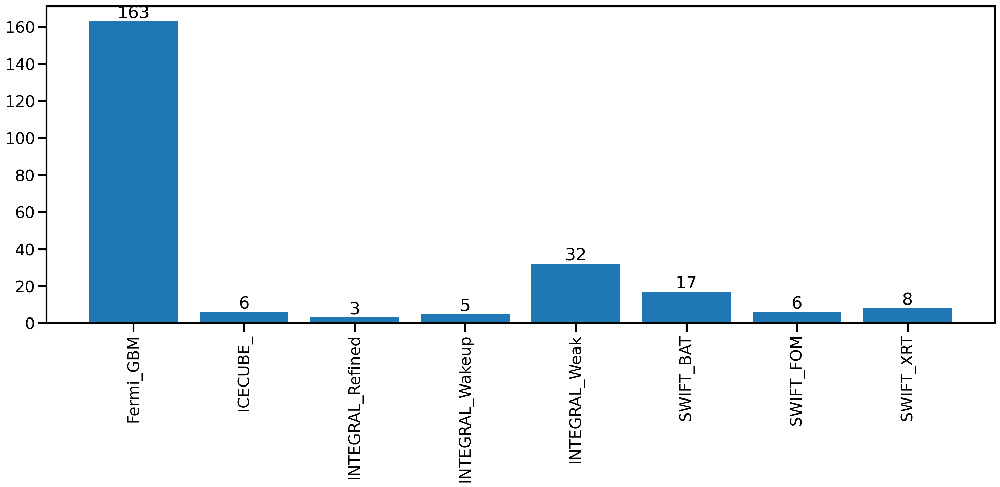

In [16]:
data_join.bar_plot_unique_gcn()

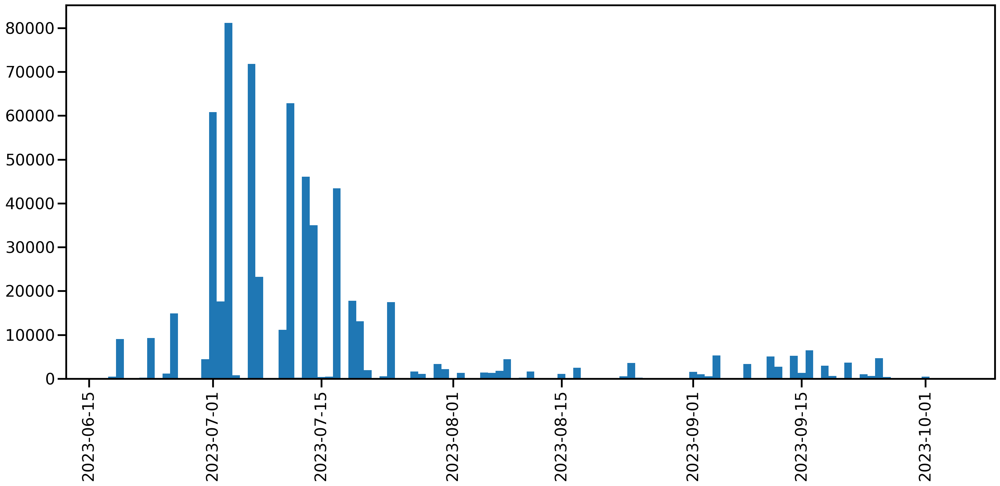

In [17]:
data_join.bar_timeline()

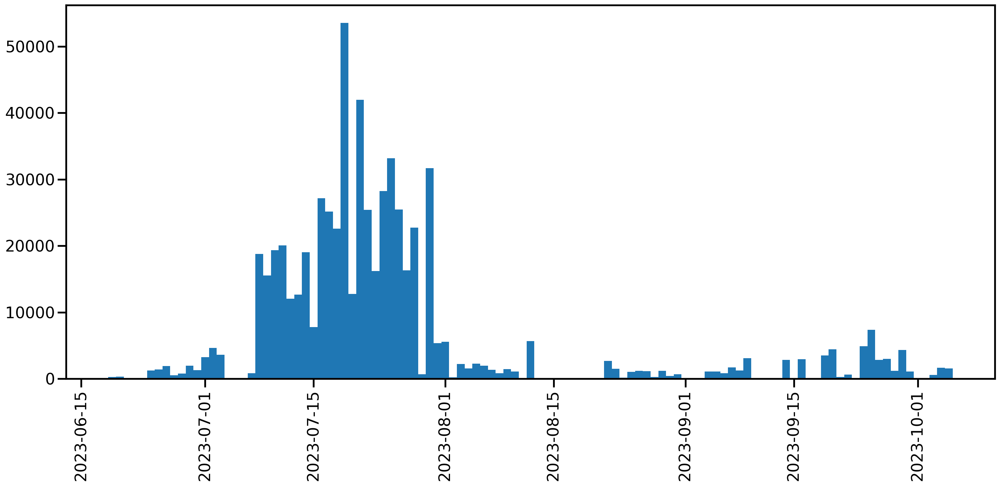

In [24]:
data_join.ztf_timeline()

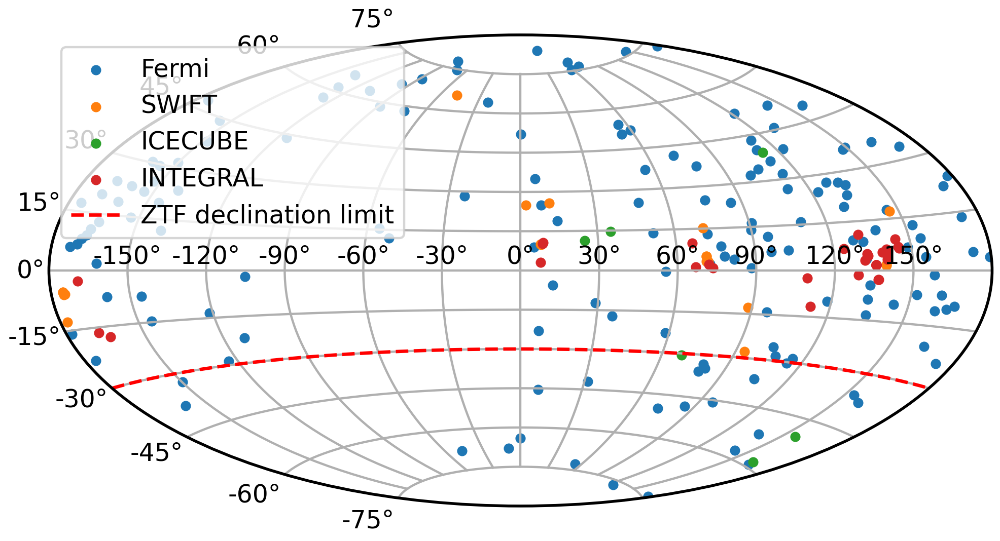

In [18]:
data_join.gcn_distribution()

In [36]:
len(online_pdf)

621970

In [37]:
len(online_pdf["objectId"].unique())

206782

In [40]:
uniq_obj_distrib = online_pdf.groupby("triggerId").agg(uniq_obj=("objectId", lambda x: len(np.unique(x))))

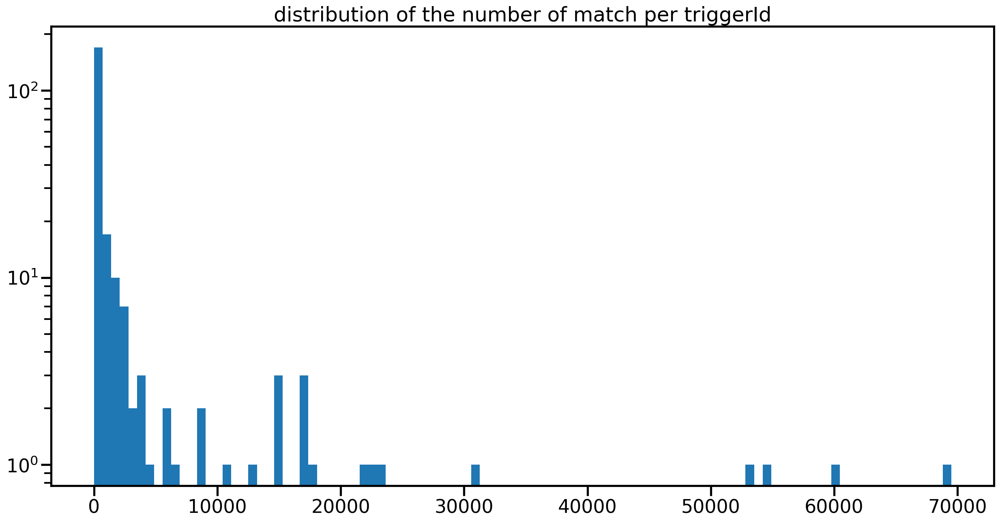

In [97]:
plt.hist(uniq_obj_distrib, bins=100)
plt.yscale("log")
plt.title("distribution of the number of match per triggerId")
plt.show()

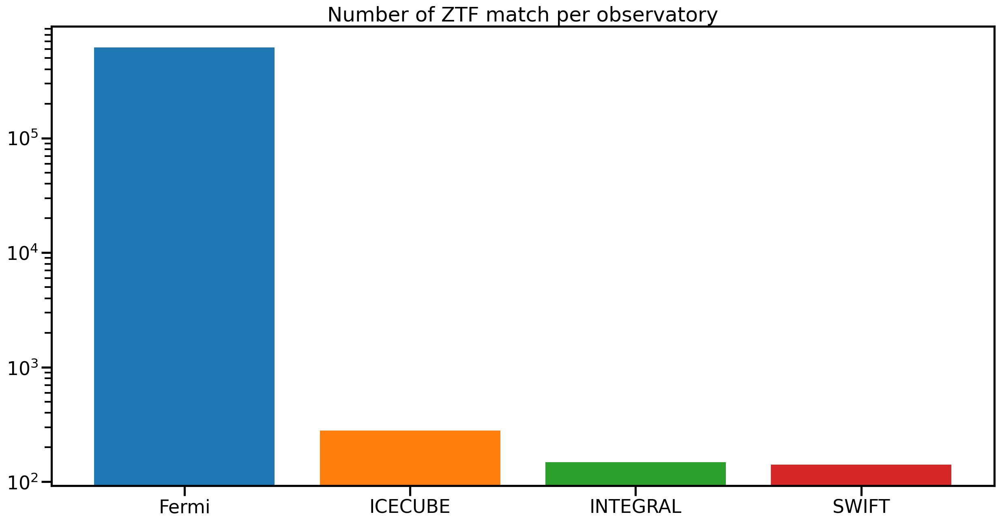

In [119]:
obs_match = online_pdf[["observatory"]].value_counts()
for obs, nb_match in zip(obs_match.index, obs_match):
    plt.bar(obs, nb_match)
plt.yscale("log")
plt.title("Number of ZTF match per observatory")
plt.show()

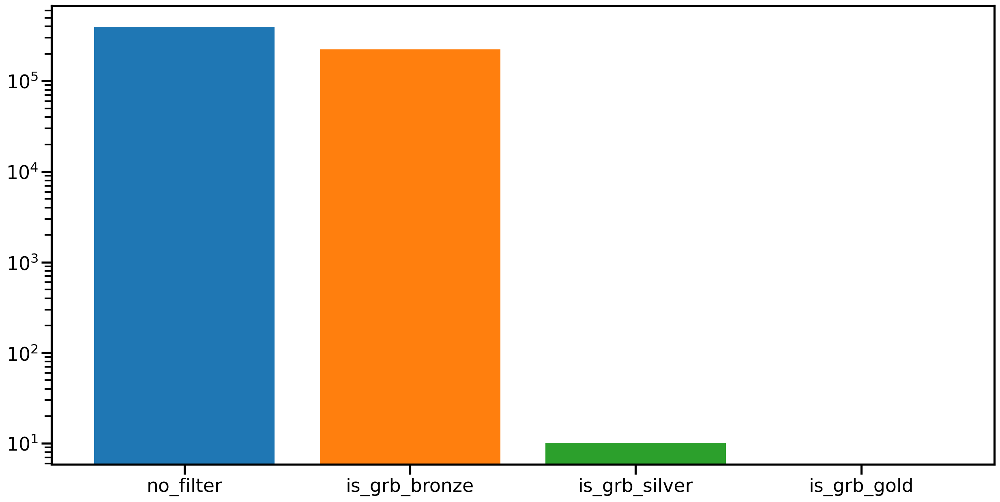

In [34]:
data_join.bar_plot_filter()

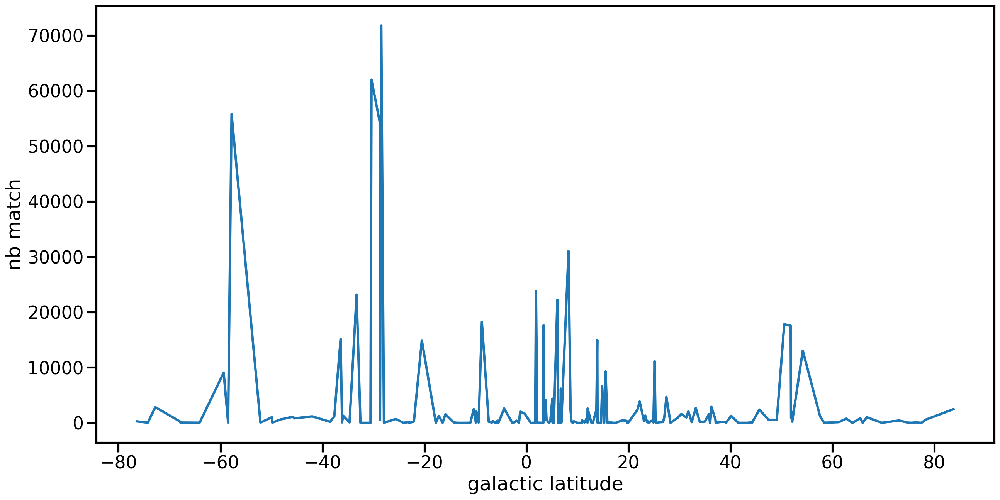

In [20]:
data_join.plot_nb_match_vs_latitude("gal")

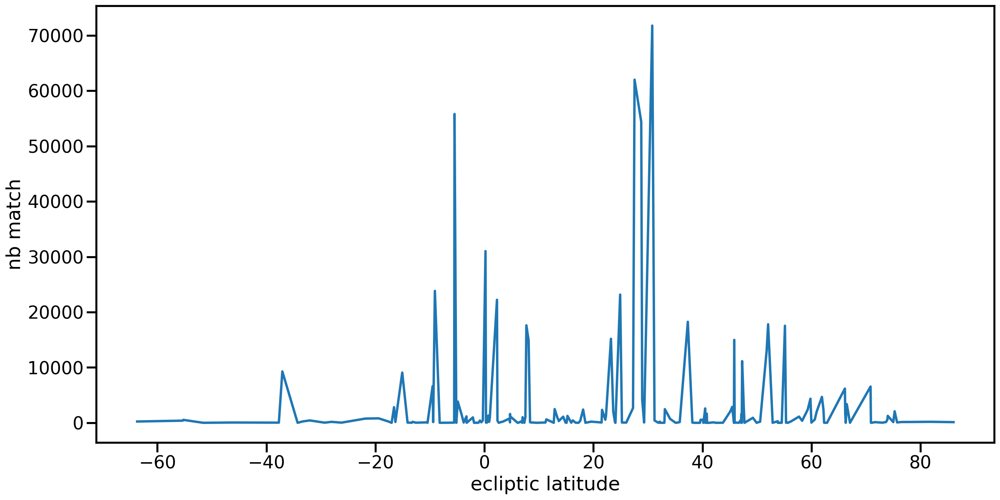

In [21]:
data_join.plot_nb_match_vs_latitude("ecl")

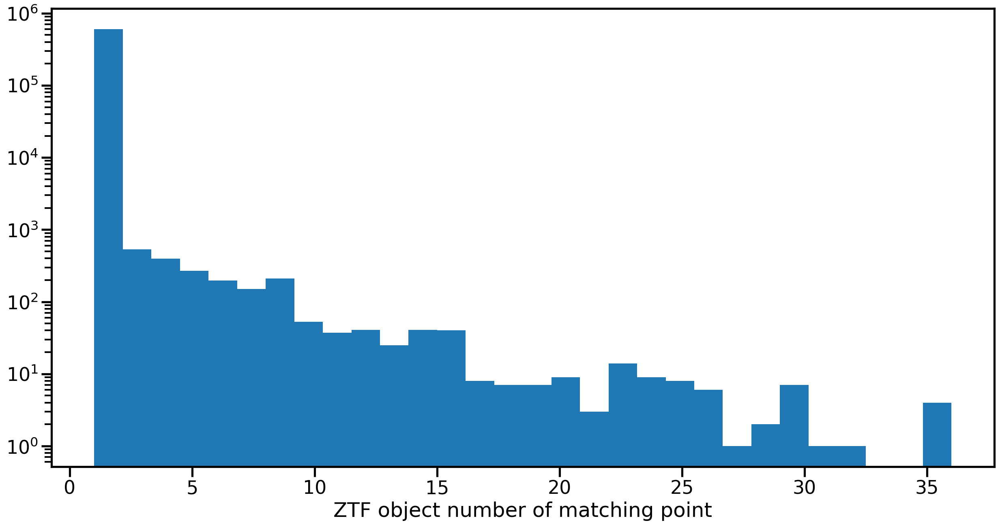

In [22]:
data_join.nb_point_distrib()

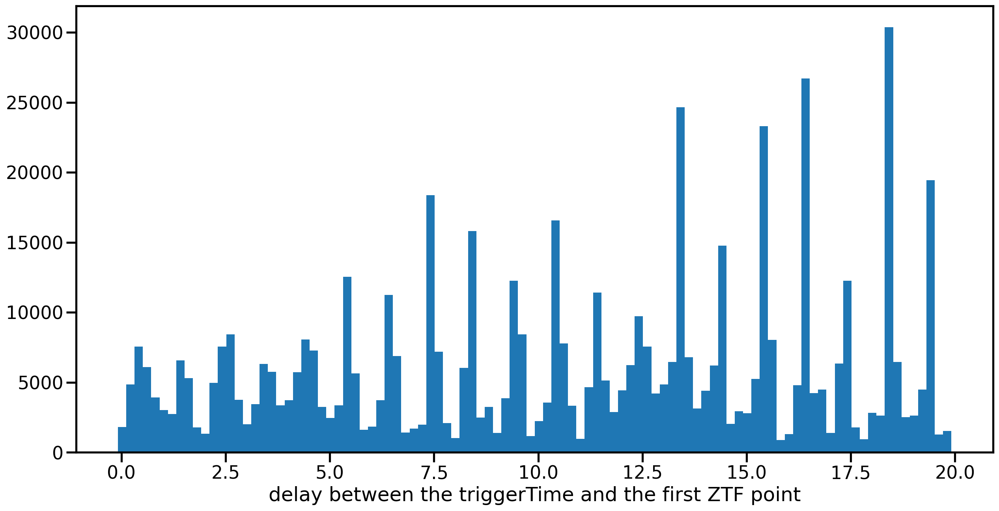

In [23]:
data_join.delay_distrib()

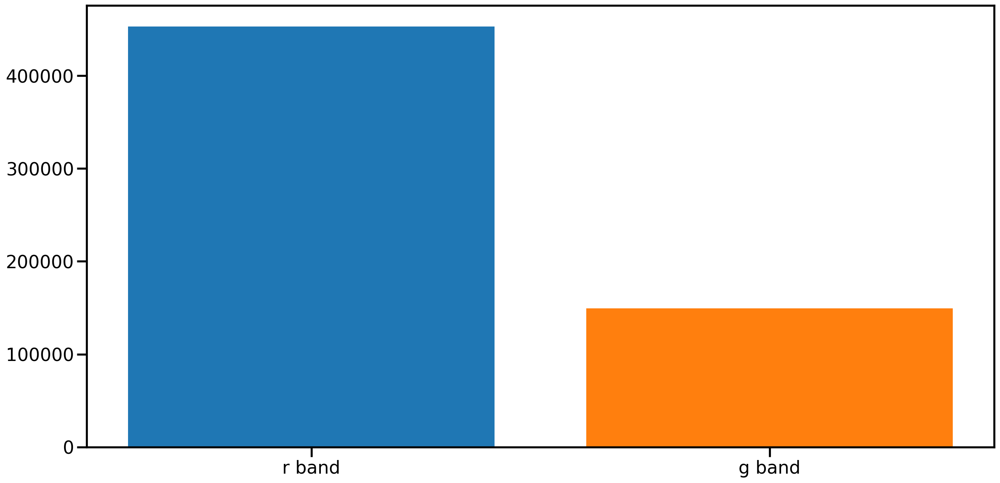

In [24]:
data_join.mag_filter_distribution()

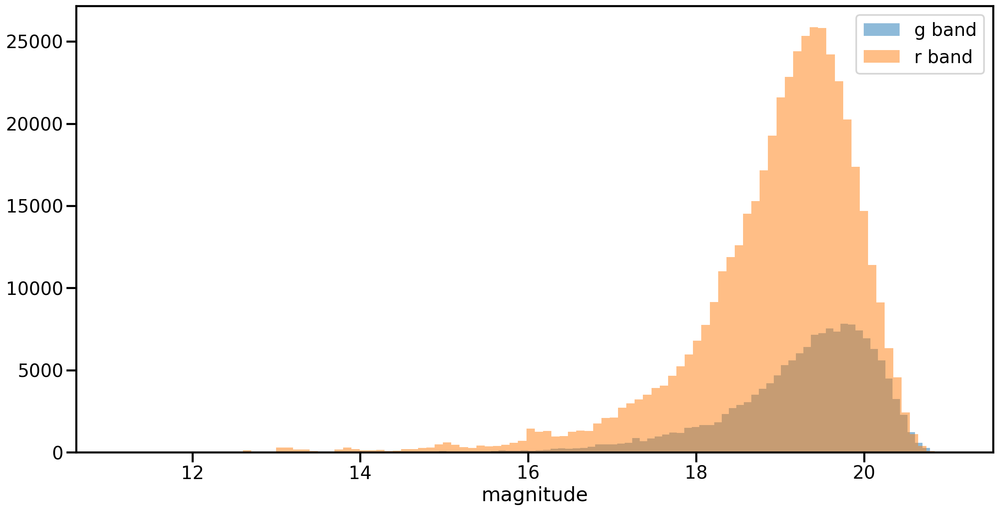

In [25]:
data_join.plot_mag_distrib()

In [27]:
def plot_class_distrib(pdf):
    class_count = pdf["fink_class"].value_counts()

    for class_, nb in zip(class_count.index, class_count):
        plt.bar(class_, nb)
    plt.yscale("log")
    plt.xticks(rotation=90)
    plt.show()
    
bronze_mask = online_pdf["is_grb_bronze"]
silver_mask = online_pdf["is_grb_silver"] & (online_pdf["p_assoc"] != -1.0)
gold_mask = online_pdf["is_grb_gold"] & (online_pdf["p_assoc"] != -1.0)

gold_pdf = online_pdf[gold_mask]
silver_pdf = online_pdf[~gold_mask & silver_mask]
bronze_pdf = online_pdf[~gold_mask & ~silver_mask & bronze_mask]
no_filter_pdf = online_pdf[~gold_mask & ~silver_mask & ~bronze_mask]

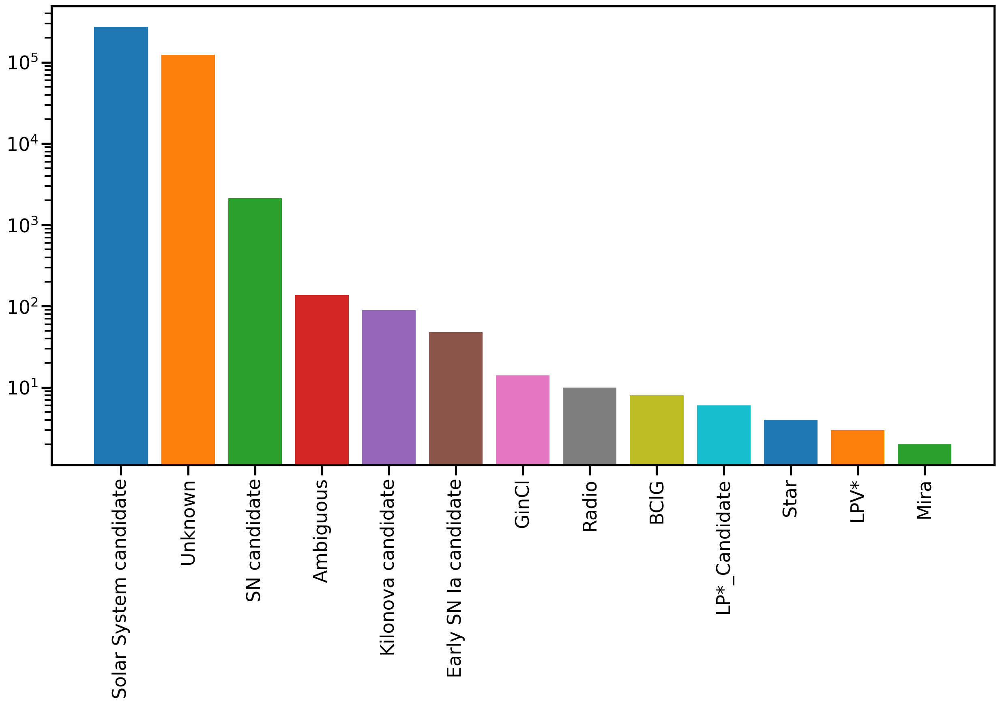

In [28]:
plot_class_distrib(no_filter_pdf)

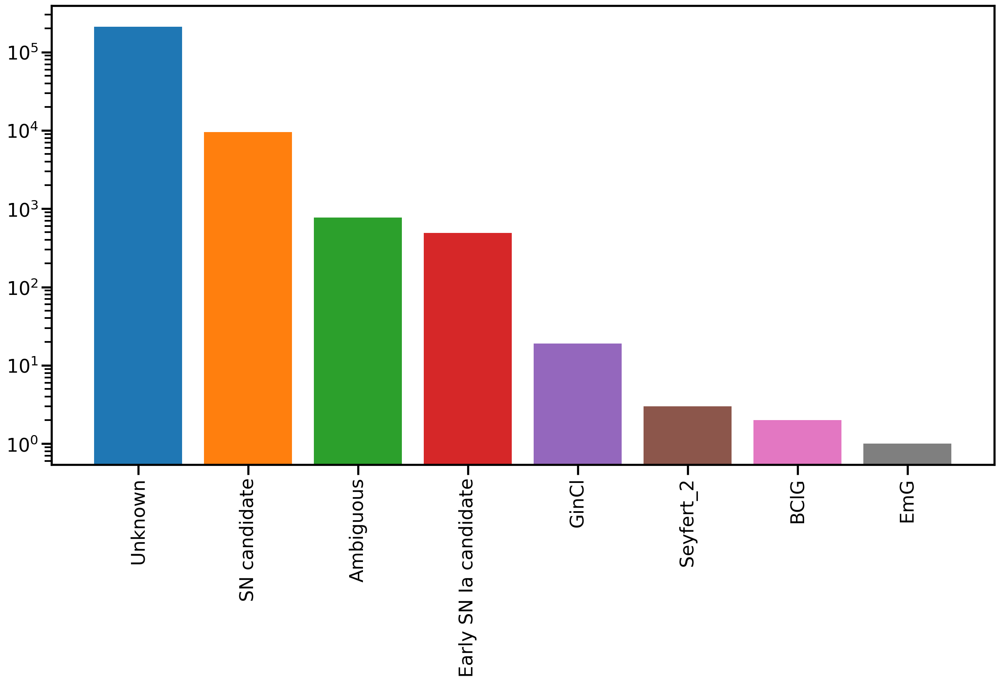

In [29]:
plot_class_distrib(bronze_pdf)

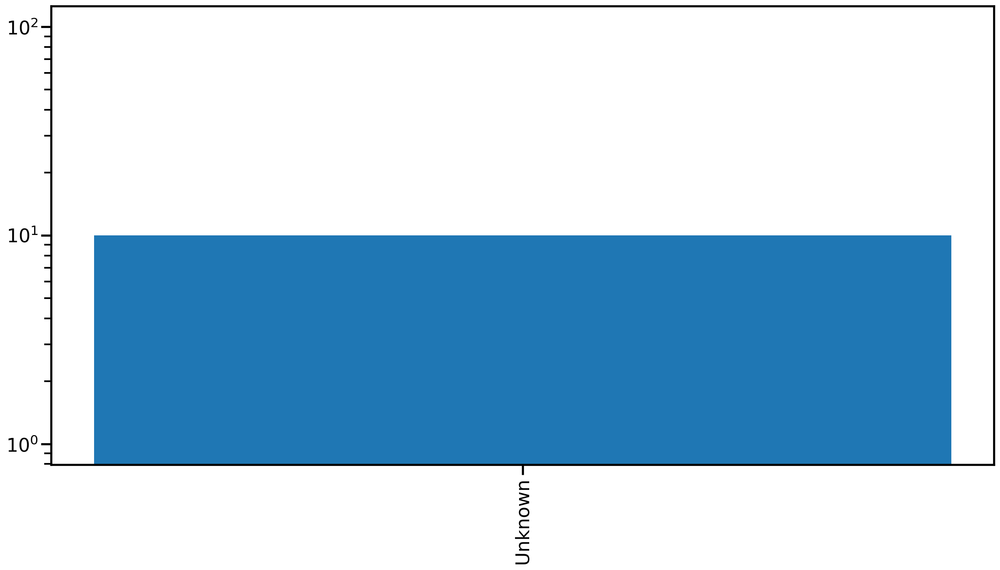

In [30]:
plot_class_distrib(silver_pdf)

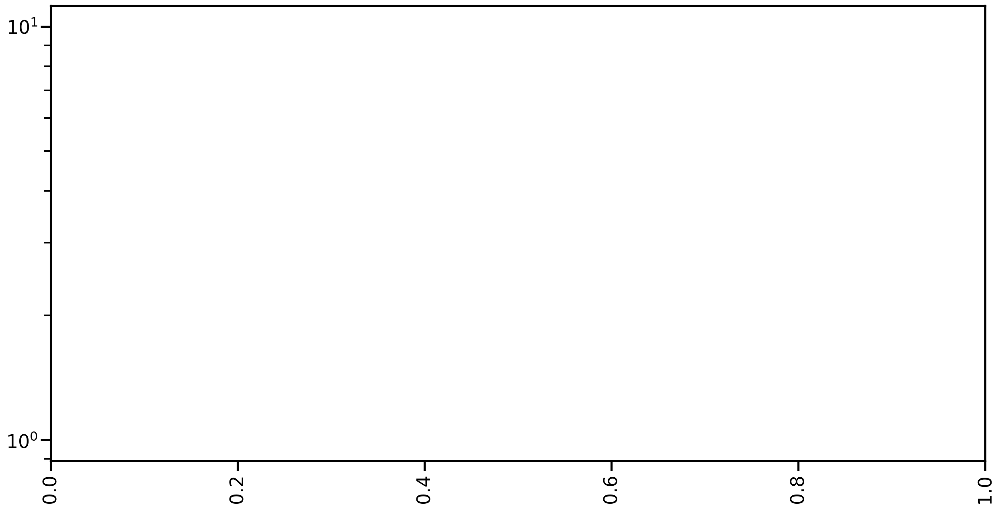

In [31]:
plot_class_distrib(gold_pdf)

In [95]:
grb_silver_pdf = online_pdf[(online_pdf["is_grb_silver"]) & (~online_pdf["is_grb_gold"])]

In [96]:
grb_gold = online_pdf[online_pdf["is_grb_gold"]]

In [98]:
grb_silver_pdf.sort_values("gcn_loc_error")[["observatory", "instrument", "gcn_status", "gcn_loc_error", "objectId", "triggerId"]]

,observatory,instrument,gcn_status,gcn_loc_error,objectId,triggerId
582646,SWIFT,XRT,initial,0.001000,ZTF23abapzga,1186032
279859,SWIFT,XRT,update_2,0.001300,ZTF23abfpcnk,1192251
564700,SWIFT,XRT,initial,0.001600,ZTF23aapjmqu,1175438
536200,SWIFT,BAT,initial,0.016667,ZTF23abbkyty,1187463
188773,SWIFT,BAT,initial,0.016667,ZTF23aatodqv,1180055
...,...,...,...,...,...,...
614172,Fermi,GBM,initial,1569.000000,ZTF23aaqeamu,709806846
608393,Fermi,GBM,initial,1569.000000,ZTF23aaqebvb,709806846
609288,Fermi,GBM,initial,1569.000000,ZTF23aaqdywx,709806846
619282,Fermi,GBM,initial,1569.000000,ZTF23aaqeako,709806846


In [102]:
uniq_silver_gcn = grb_silver_pdf.drop_duplicates("triggerId")

In [107]:
data_join.online_pdf.columns

Index(['observatory', 'instrument', 'event', 'triggerId', 'gcn_ra', 'gcn_dec',
       'gcn_loc_error', 'ackTime', 'triggerTimeUTC', 'gcn_status', 'objectId',
       'cdsxmatch', 'DR3Name', 'Plx', 'e_Plx', 'gcvs', 'vsx', 'roid',
       'rf_snia_vs_nonia', 'snn_snia_vs_nonia', 'snn_sn_vs_all', 'mulens',
       'nalerthist', 'rf_kn_vs_nonkn', 'x3hsp', 'x4lac', 'mangrove', 't2',
       'anomaly_score', 'lc_features_g', 'lc_features_r', 'ztf_ra', 'ztf_dec',
       'delta_mag', 'rate', 'from_upper', 'start_vartime', 'diff_vartime',
       'fink_class', 'p_assoc', 'candid', 'fid', 'jdstarthist', 'rb', 'jd',
       'magpsf', 'sigmapsf', 'timestamp', 'is_grb_bronze', 'is_grb_silver',
       'is_grb_gold', 'is_gw_bronze', 'year', 'month', 'day', 'triggerTimejd',
       'ackTimejd'],
      dtype='object')

In [131]:
for trigId, status in zip(
    uniq_silver_gcn["triggerId"], 
    uniq_silver_gcn["gcn_status"]
):
    print(objId)
    print(trigId)
    print(status)
    try:
        data_join.save_data_analysis(trigId, status, "gcn_analysis/silver")
    except Exception as e:
        print(e)
        continue
    print()
    print()

ZTF23aapgmql
710117592
initial
|                | GCN INFO                   |
|:---------------|:---------------------------|
| triggerId      | 710117592                  |
| ackTime        | 2023-07-04 03:39:31.831045 |
| triggerTimeUTC | 2023-07-04 00:53:07.380000 |
| observatory    | Fermi                      |
| instrument     | GBM                        |
| event          |                            |
| gcn_status     | initial                    |
| gcn_loc_error  | 60.0                       |


/spark_mongo_tmp/roman.le-montagner/Doctorat/Fink_MM/notebook/datajoin.py:599: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


nb silver or gold alerts: 2
ZTF23aasxykz : 0 / 2 / 2
ZTF23aaryxlw : 1 / 1 / 2


ZTF23aapgmql
711982704
initial
|                | GCN INFO                   |
|:---------------|:---------------------------|
| triggerId      | 711982704                  |
| ackTime        | 2023-07-25 17:07:40.522653 |
| triggerTimeUTC | 2023-07-25 14:58:19.320000 |
| observatory    | Fermi                      |
| instrument     | GBM                        |
| event          |                            |
| gcn_status     | initial                    |
| gcn_loc_error  | 60.0                       |
nb silver or gold alerts: 4
ZTF23aavepkd : 0 / 4 / 4
ZTF23aaveqcy : 1 / 3 / 4
ZTF23aavdjgy : 2 / 2 / 4
ZTF23aavqetd : 3 / 1 / 4


ZTF23aapgmql
1180410
initial
|                | GCN INFO                   |
|:---------------|:---------------------------|
| triggerId      | 1180410                    |
| ackTime        | 2023-07-23 15:55:15.202470 |
| triggerTimeUTC | 2023-07-23 13:42:32.880000 |
| observat

nb silver or gold alerts: 1
ZTF23abcqxdo : 0 / 1 / 1


ZTF23aapgmql
10386
initial
|                | GCN INFO                   |
|:---------------|:---------------------------|
| triggerId      | 10386                      |
| ackTime        | 2023-09-07 12:53:19.351584 |
| triggerTimeUTC | 2023-09-07 10:53:15.200000 |
| observatory    | INTEGRAL                   |
| instrument     | Weak                       |
| event          |                            |
| gcn_status     | initial                    |
| gcn_loc_error  | 0.0597                     |
nb silver or gold alerts: 1
ZTF23abcqxdo : 0 / 1 / 1


ZTF23aapgmql
10300
initial
|                | GCN INFO                   |
|:---------------|:---------------------------|
| triggerId      | 10300                      |
| ackTime        | 2023-06-30 08:02:50.442549 |
| triggerTimeUTC | 2023-06-30 06:02:32.970000 |
| observatory    | INTEGRAL                   |
| instrument     | Weak                       |
| event          |  

ZTF23aaqdzeb : 5 / 2 / 7
ZTF23aaqeako : 6 / 1 / 7


ZTF23aapgmql
10371
initial
|                | GCN INFO                   |
|:---------------|:---------------------------|
| triggerId      | 10371                      |
| ackTime        | 2023-08-18 12:07:56.326258 |
| triggerTimeUTC | 2023-08-18 10:07:50.770000 |
| observatory    | INTEGRAL                   |
| instrument     | Weak                       |
| event          |                            |
| gcn_status     | initial                    |
| gcn_loc_error  | 0.06                       |
nb silver or gold alerts: 1
ZTF23aazyjxq : 0 / 1 / 1


ZTF23aapgmql
10372
initial
|                | GCN INFO                   |
|:---------------|:---------------------------|
| triggerId      | 10372                      |
| ackTime        | 2023-08-19 13:46:48.252367 |
| triggerTimeUTC | 2023-08-19 11:46:37.970000 |
| observatory    | INTEGRAL                   |
| instrument     | Weak                       |
| event          |     

In [130]:
Time(data_join.get_gcn_join("10291", "initial").gcn_pdf["jd"].values[0], format="jd").iso

'2023-06-22 10:02:41.001'

In [177]:
grb_silver_pdf[grb_silver_pdf["objectId"] == "ZTF23abfpcnk"]

,observatory,instrument,event,triggerId,gcn_ra,gcn_dec,gcn_loc_error,ackTime,triggerTimeUTC,gcn_status,...,is_grb_silver,is_grb_gold,is_gw_bronze,year,month,day,galactic_latitude,galactic_longitude,ecliptic_latitude,ecliptic_longitude
255276,SWIFT,BAT,,1192253,261.5758,-17.1172,0.016667,2023-09-16 08:36:37.862220,2023-09-16 06:30:07.980,update_2,...,True,False,False,2023,9,20,10.051590,7.674817,6.085495,261.900042
255277,SWIFT,BAT,,1192251,261.7741,-17.0322,0.016667,2023-09-16 08:16:21.167447,2023-09-16 06:12:15.980,update_4,...,True,False,False,2023,9,20,9.937633,7.851194,6.181332,262.085414
255278,SWIFT,BAT,,1192253,261.5758,-17.1172,0.016667,2023-09-16 08:47:29.820432,2023-09-16 06:30:07.980,update_5,...,True,False,False,2023,9,20,10.051590,7.674817,6.085495,261.900042
255279,SWIFT,XRT,,1192251,261.7583,-17.0329,0.001300,2023-09-16 08:15:14.374381,2023-09-16 06:14:50.580,update_2,...,True,False,False,2023,9,20,9.949992,7.842345,6.179767,262.070284
255280,SWIFT,BAT,,1192251,261.7741,-17.0322,0.016667,2023-09-16 08:16:12.211633,2023-09-16 06:12:15.980,update_3,...,True,False,False,2023,9,20,9.937633,7.851194,6.181332,262.085414
255281,SWIFT,BAT,,1192253,261.5758,-17.1172,0.016667,2023-09-16 08:43:17.700152,2023-09-16 06:30:07.980,update_4,...,True,False,False,2023,9,20,10.051590,7.674817,6.085495,261.900042
255282,SWIFT,BAT,,1192253,261.5758,-17.1172,0.016667,2023-09-16 08:36:45.915834,2023-09-16 06:30:07.980,update_3,...,True,False,False,2023,9,20,10.051590,7.674817,6.085495,261.900042
255283,SWIFT,BAT,,1192251,261.7741,-17.0322,0.050000,2023-09-16 08:13:30.338059,2023-09-16 06:12:15.980,initial,...,True,False,False,2023,9,20,9.937633,7.851194,6.181332,262.085414
255284,SWIFT,BAT,,1192253,261.5758,-17.1172,0.050000,2023-09-16 08:34:53.016029,2023-09-16 06:30:07.980,initial,...,True,False,False,2023,9,20,10.051590,7.674817,6.085495,261.900042
255285,SWIFT,BAT,,1192253,261.5758,-17.1172,0.050000,2023-09-16 08:34:53.708089,2023-09-16 06:30:07.980,update_0,...,True,False,False,2023,9,20,10.051590,7.674817,6.085495,261.900042


In [111]:
trig = data_join.online_pdf[["observatory", "instrument", "triggerId", "gcn_loc_error", "gcn_ra", "gcn_dec", "triggerTimeUTC"]].drop_duplicates()

In [112]:
trig[trig["observatory"] == "Fermi"]

,observatory,instrument,triggerId,gcn_loc_error,gcn_ra,gcn_dec,triggerTimeUTC
0,Fermi,GBM,711003812,2112.000,177.6167,70.6167,2023-07-14 07:03:27.600
1,Fermi,GBM,709858529,3000.000,4.5833,33.6000,2023-07-01 00:55:24.740
2,Fermi,GBM,710291672,3000.000,356.6667,32.4500,2023-07-06 01:14:27.420
3,Fermi,GBM,709938257,1987.002,326.1500,62.0833,2023-07-01 23:04:12.540
4,Fermi,GBM,710029451,3000.000,3.7000,31.8500,2023-07-03 00:24:06.220
...,...,...,...,...,...,...,...
563051,Fermi,GBM,718100620,202.200,68.3500,-9.9500,2023-10-04 10:23:35.110
563053,Fermi,GBM,718100620,436.002,72.3167,-12.1167,2023-10-04 10:23:35.110
582114,Fermi,GBM,716723561,1767.000,225.8667,-25.8333,2023-09-18 11:52:36.500
583836,Fermi,GBM,713559497,60.000,250.0600,46.2000,2023-08-12 20:58:12.050


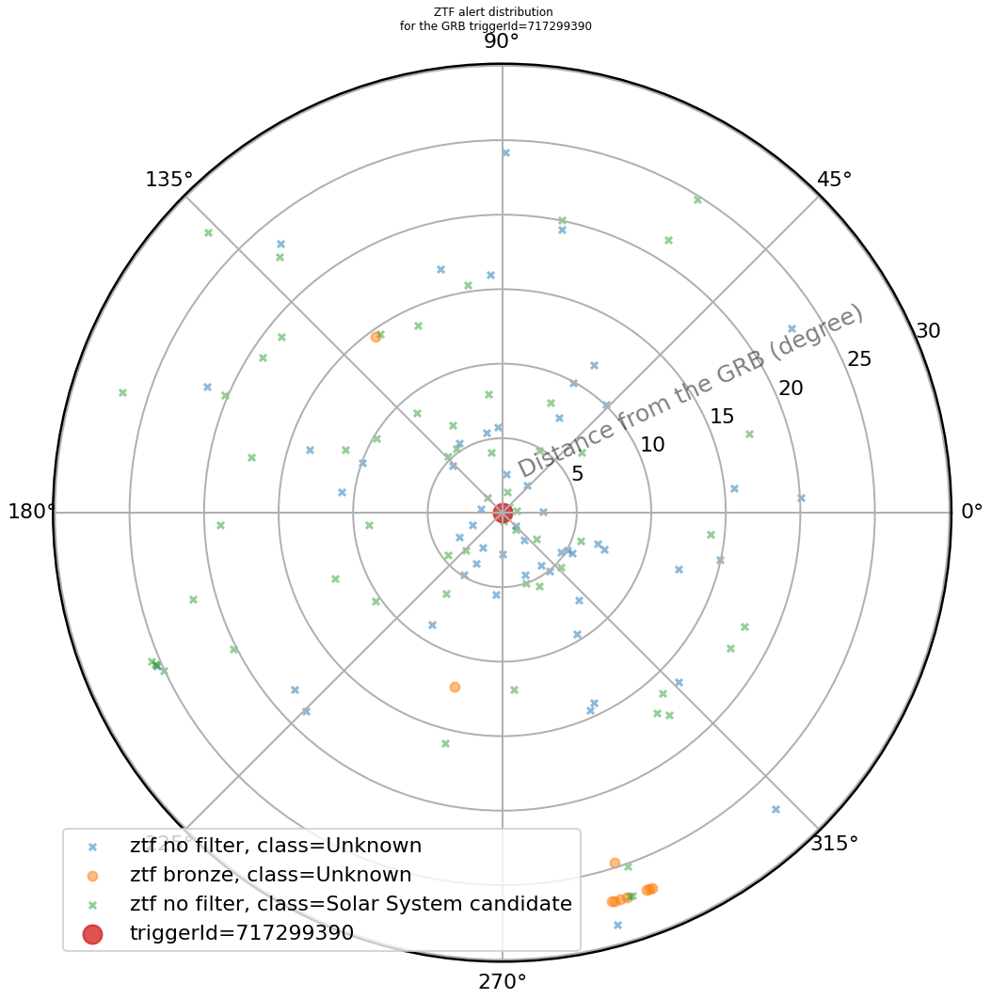

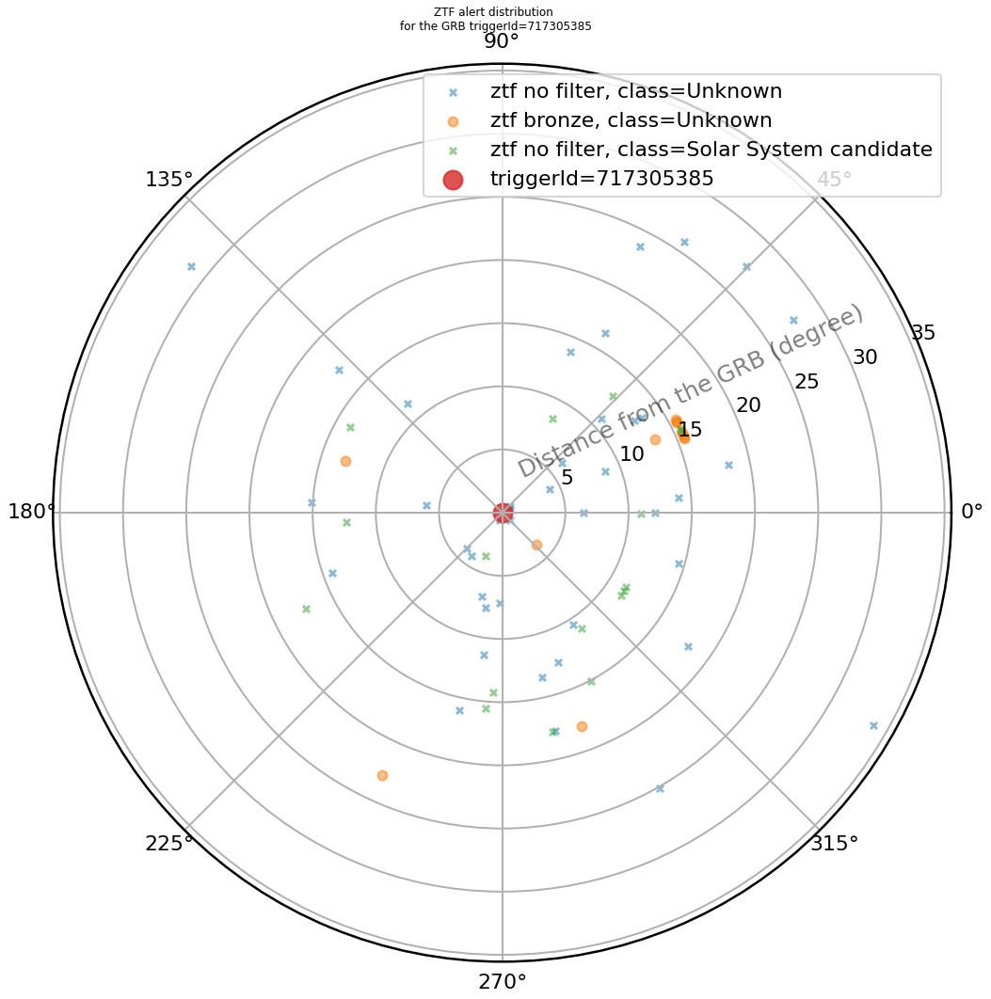

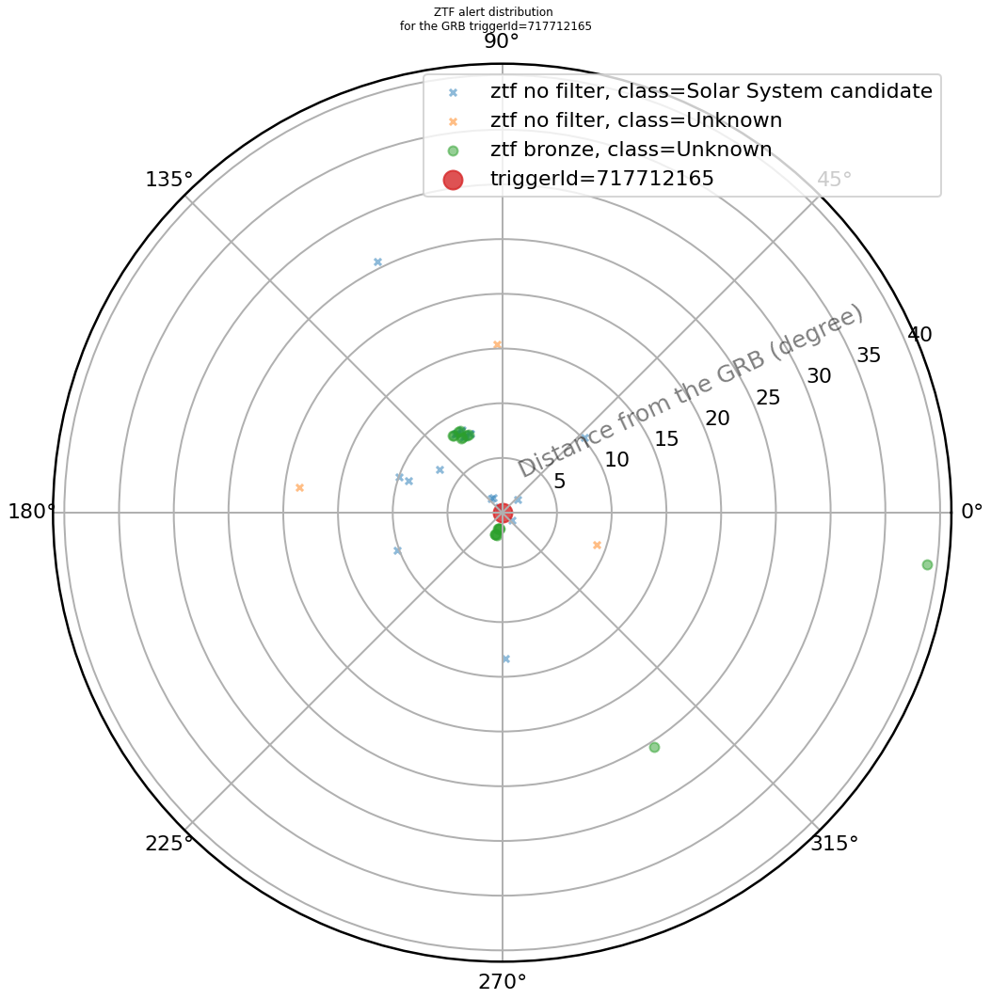

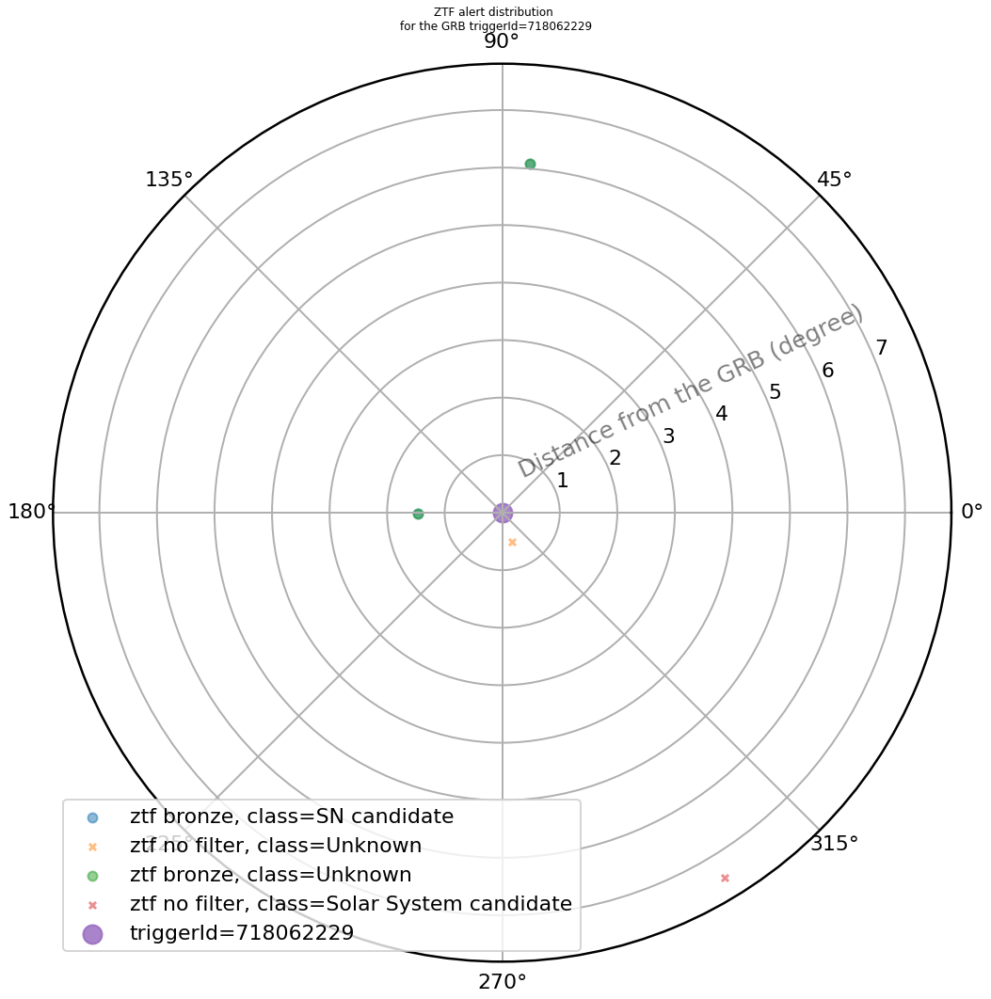

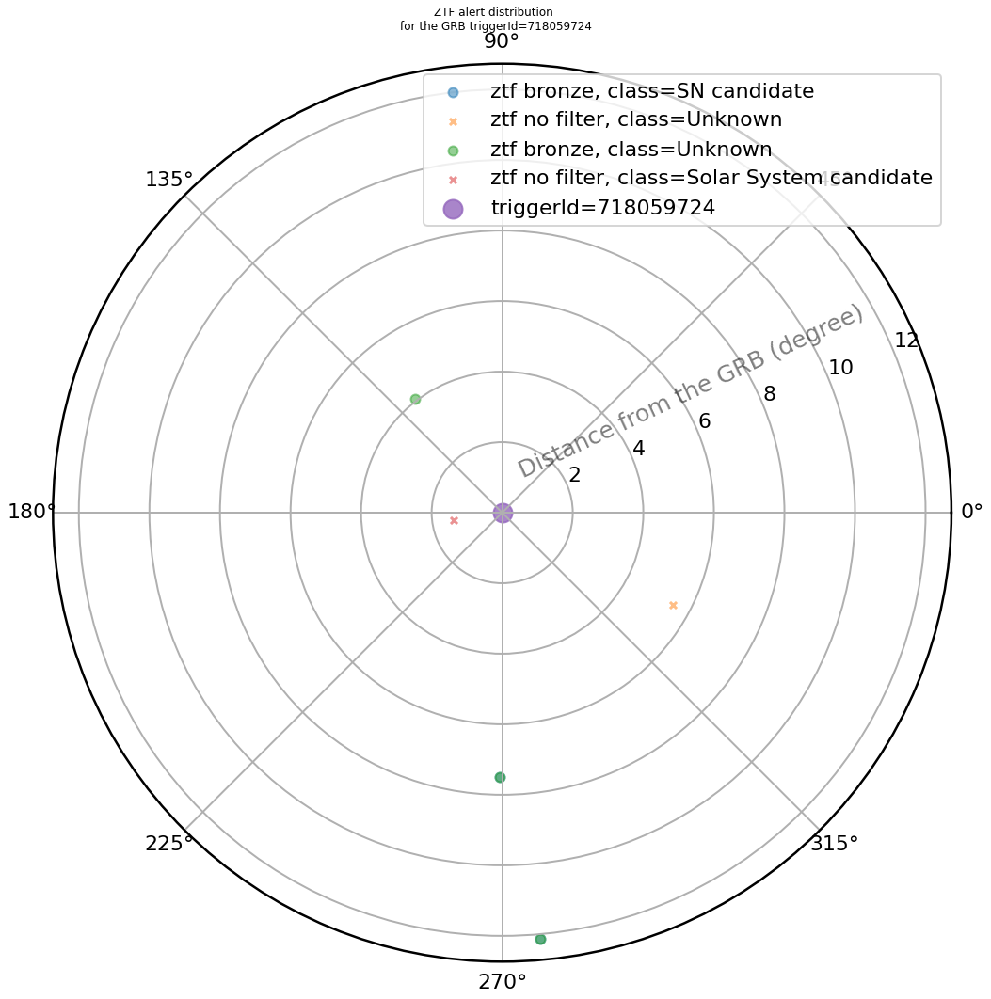

...

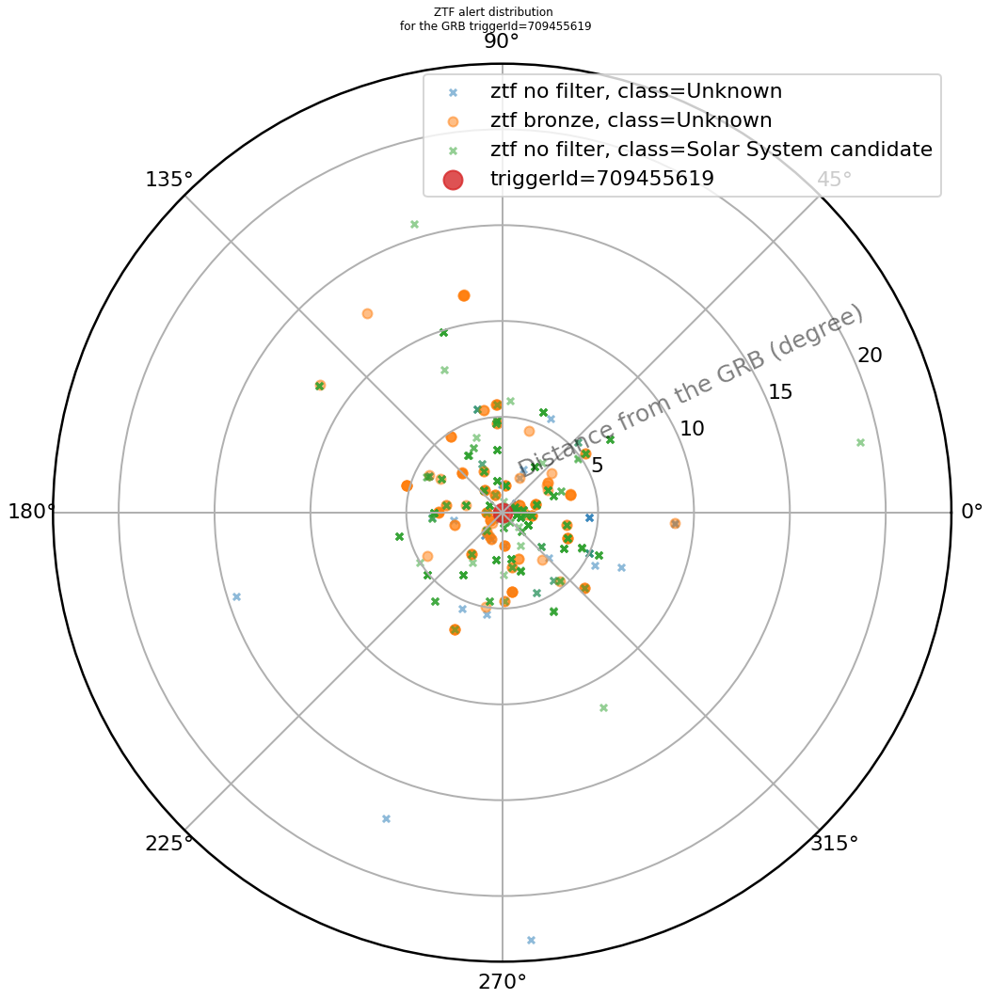

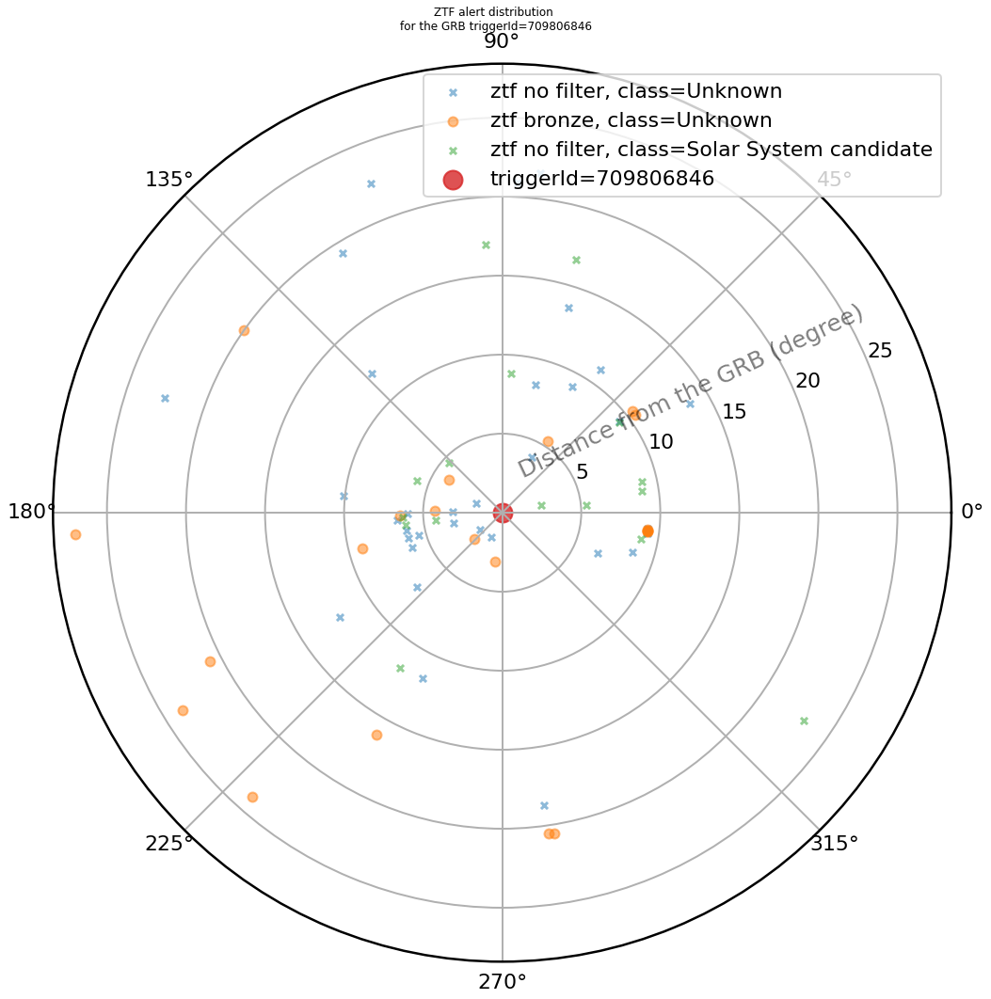

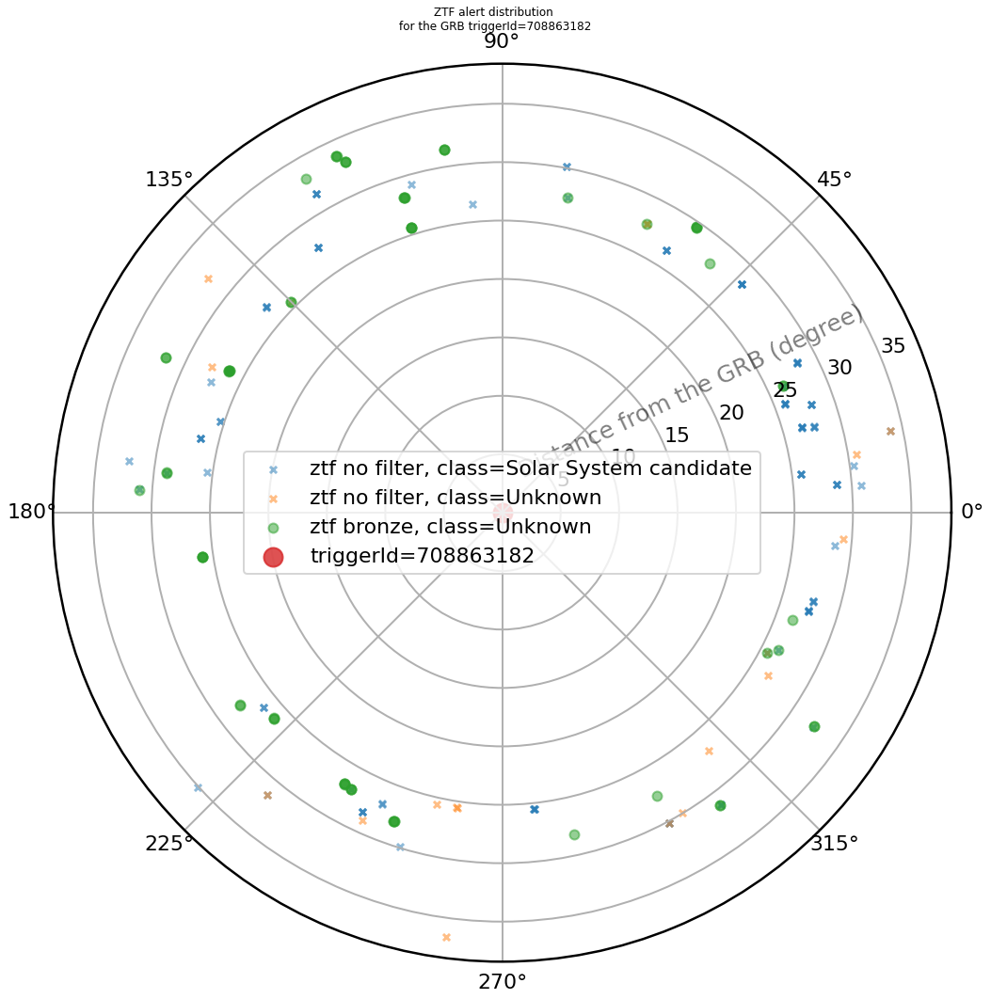

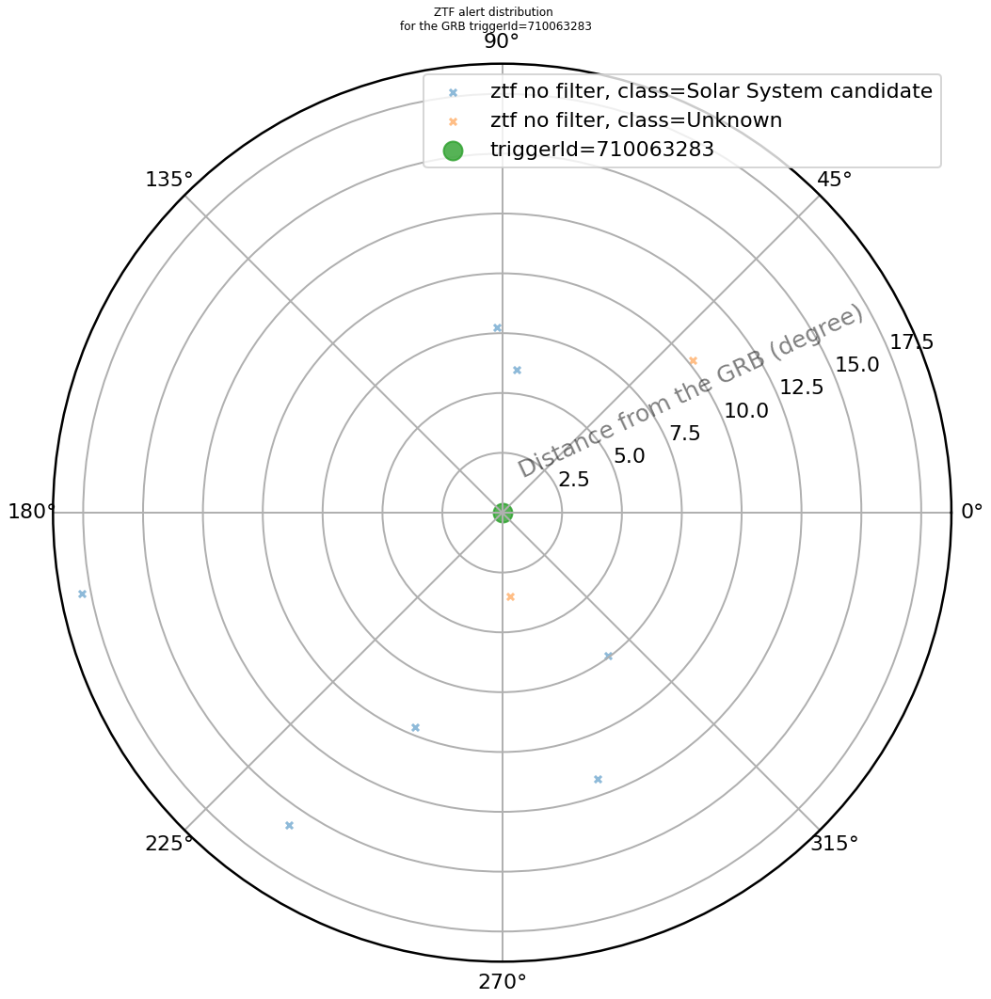

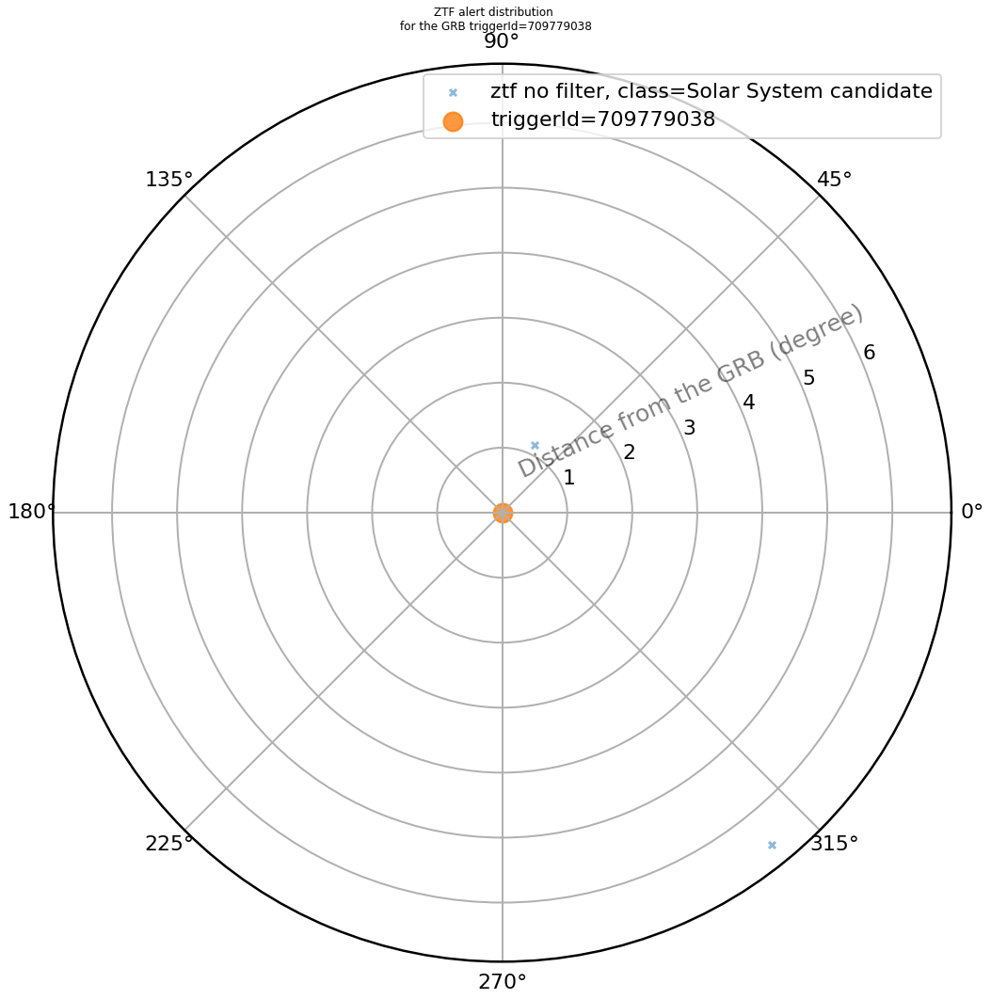

In [25]:
for event_id in trig[trig["observatory"] == "Fermi"]["triggerId"].unique():
    gcn_event = data_join.get_gcn_join(event_id)
    gcn_event.plot_alert_distribution()

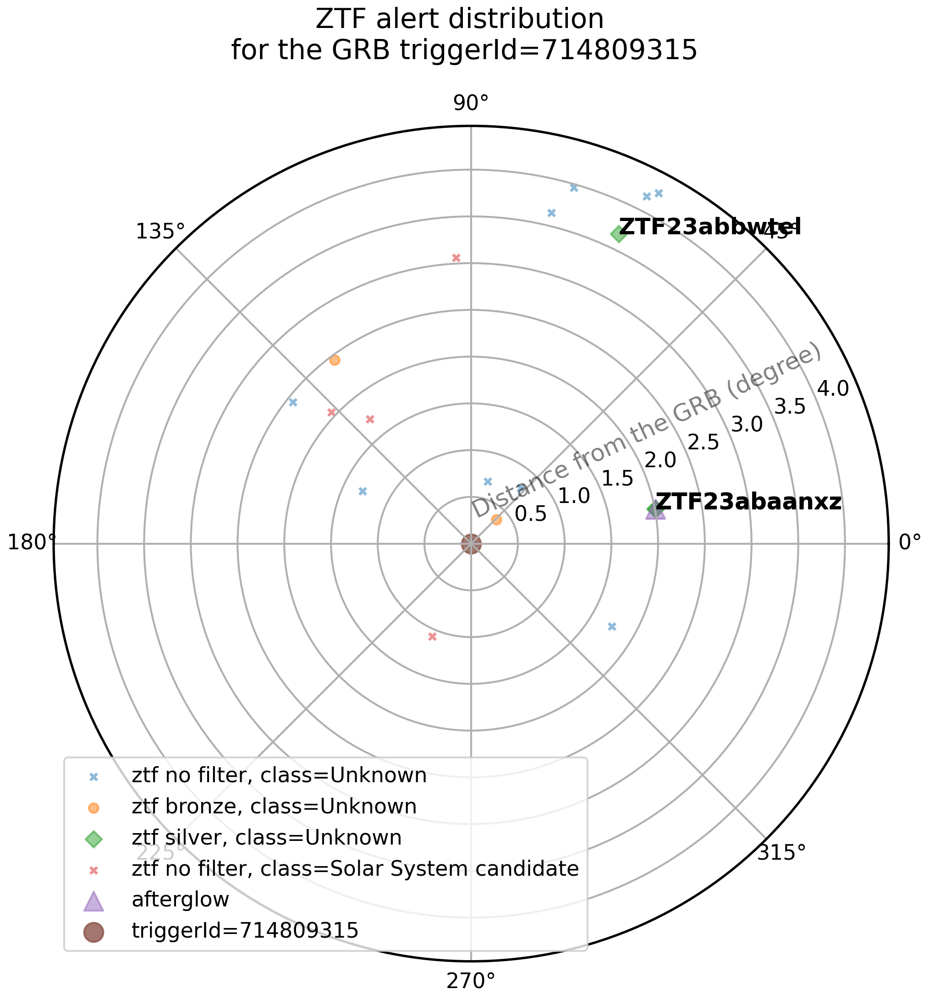

In [113]:
event_id = "714809315"

gcn_event = data_join.get_gcn_join(event_id)
gcn_event.plot_alert_distribution()

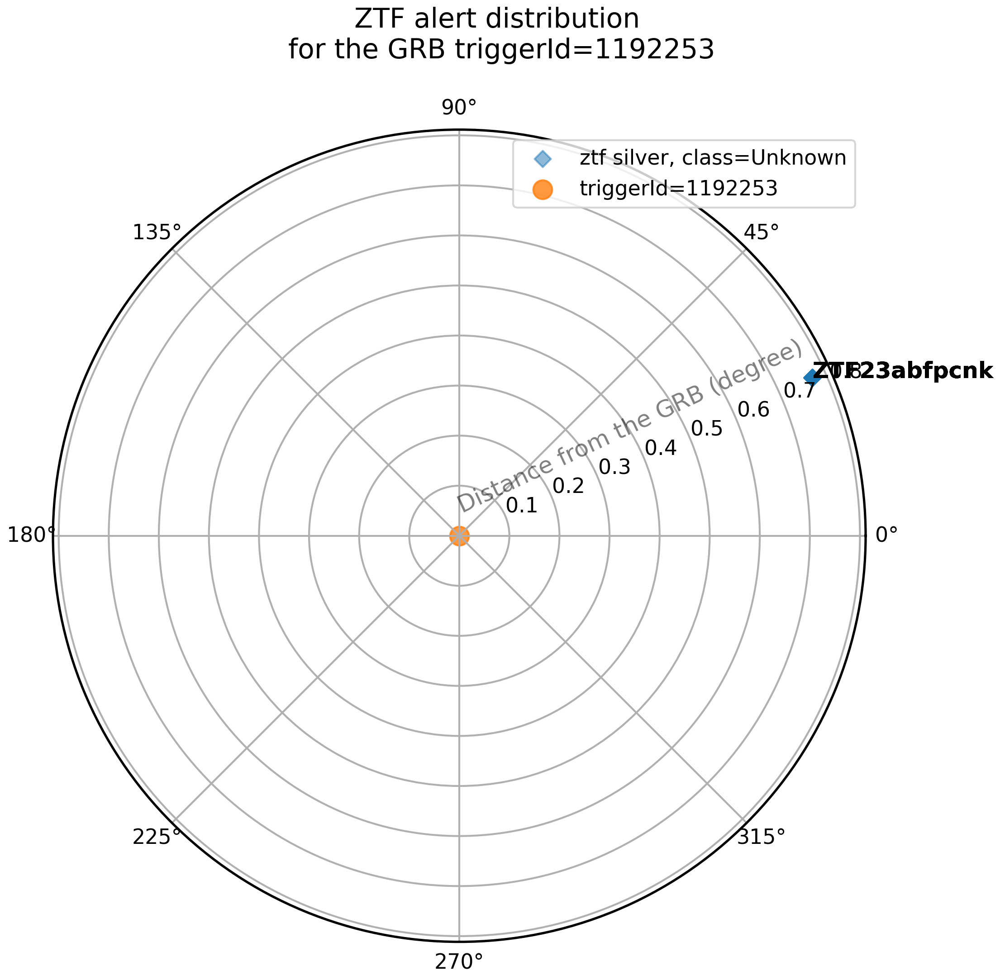

In [179]:
event_id = "1192253"

gcn_event = data_join.get_gcn_join(event_id)
gcn_event.plot_alert_distribution()

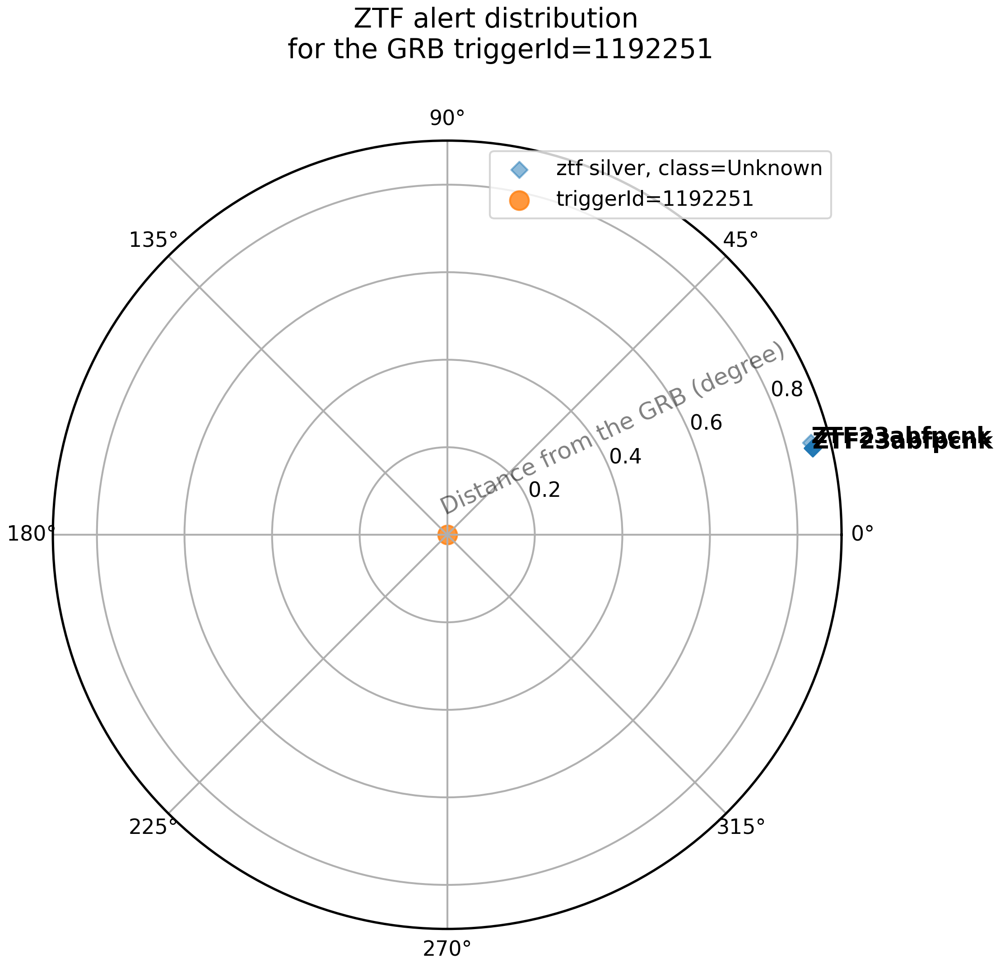

In [181]:
event_id = "1192251"

gcn_event = data_join.get_gcn_join(event_id)
gcn_event.plot_alert_distribution()

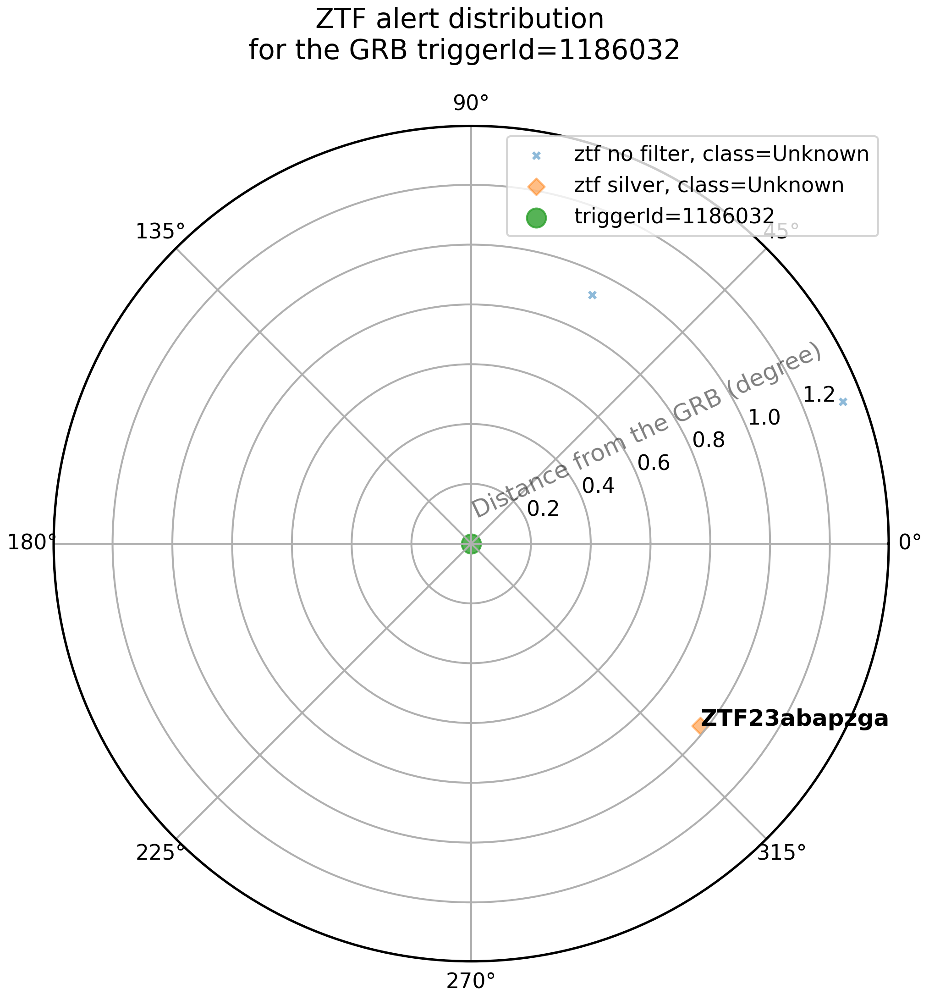

In [39]:
event_id = "1186032"

gcn_event = data_join.get_gcn_join(event_id)
gcn_event.plot_alert_distribution()

In [65]:
ztf_test = "ZTF23aazugbh"
trigger_test = "713974668"

In [77]:
online_pdf[online_pdf["triggerId"] == "713974668"]["objectId"].unique()

array(['ZTF23aazlpla', 'ZTF23aazlojx', 'ZTF23aazlpgq', ...,
       'ZTF23abazxxa', 'ZTF23abbfkcy', 'ZTF23abbetol'], dtype=object)

In [66]:
ztf_class = data_join.get_gcn_join(trigger_test, "initial").get_ztf_obj(ztf_test)

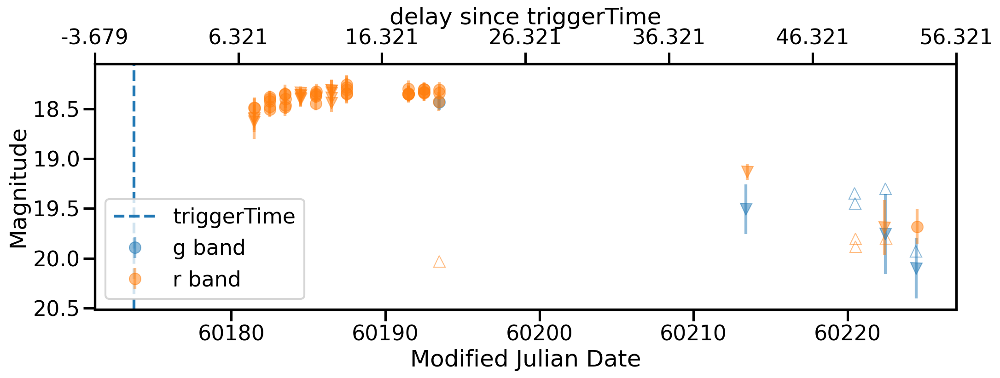

In [67]:
ztf_class.plot_lighcurve()

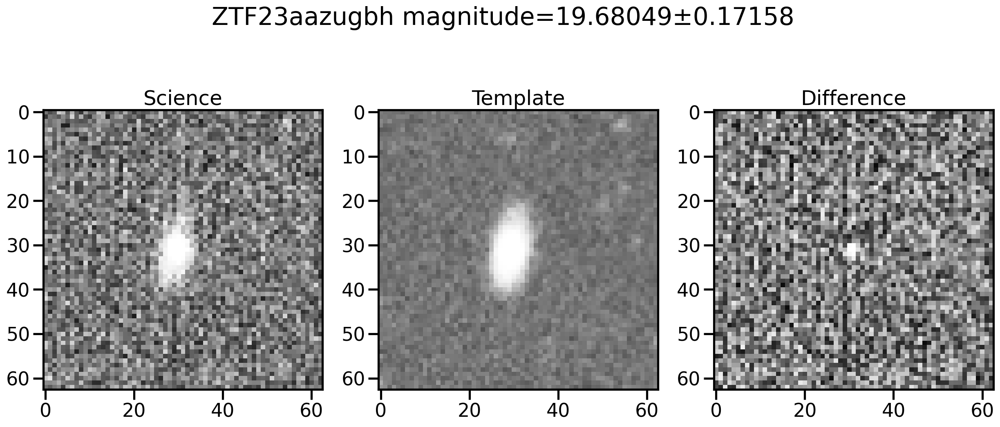

In [56]:
ztf_class.plot_images()

In [57]:
ztf_class.class_timeline()

alt.Chart(...)

In [121]:
f"{(ztf_class.ztf_pdf['jd'] - ztf_class.ztf_pdf['triggerTimejd']).min():.4f}"

'7.8175'

In [58]:
data_join.save_data_analysis("713974668", "initial", "gcn_analysis")

nb silver or gold alerts: 0


In [59]:
data_join.save_data_analysis("1192251", "update_2", "gcn_analysis")

nb silver or gold alerts: 1
ZTF23abfpcnk : 0 / 1 / 1


In [73]:
data_join.save_data_analysis("713974668", "initial", "gcn_analysis")

|                | GCN INFO                   |
|:---------------|:---------------------------|
| triggerId      | 713974668                  |
| ackTime        | 2023-08-17 18:18:12.843931 |
| triggerTimeUTC | 2023-08-17 16:17:43.790000 |
| observatory    | Fermi                      |
| instrument     | GBM                        |
| event          |                            |
| gcn_status     | initial                    |
| gcn_loc_error  | 1722.0                     |


/spark_mongo_tmp/roman.le-montagner/Doctorat/Fink_MM/notebook/datajoin.py:598: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  os.path.join(path_to_save, "gcn_info.png"),


nb silver or gold alerts: 0


# Look the objects with the most valid points

In [21]:
gb_count_point = online_pdf.groupby(["objectId", "triggerId", "gcn_status"]).agg(
    nb_point=("triggerId", "count")
).sort_values("nb_point")

In [22]:
gb_count_point

nb_point
objectId     triggerId gcn_status          
ZTF17aabpykt 710798846 initial            1
ZTF23aaumjql 710291672 initial            1
             710798846 initial            1
ZTF23aaumjqy 710291672 initial            1
             710798846 initial            1
...                                     ...
ZTF23aazugbh 713950412 initial           32
ZTF23abawves 715330494 initial           36
ZTF23aazugbh 714594716 initial           36
             714440939 initial           36
             713974668 initial           36

[602147 rows x 1 columns]

In [23]:
count_point = gb_count_point[gb_count_point["nb_point"] > 2].reset_index()

In [24]:
# object of interrest
ooi = online_pdf.merge(count_point[["objectId", "nb_point"]], on="objectId")

In [25]:
select_ooi = ooi[ooi["is_grb_bronze"]][[
    "observatory", 
    "instrument", 
    "triggerId", 
    "objectId", 
    "gcn_status",
    "gcn_loc_error",
    "nb_point"]].sort_values(["gcn_loc_error", "nb_point"])

In [28]:
low_error = select_ooi[select_ooi["gcn_loc_error"] < 300].sort_values("nb_point")#.drop_duplicates("objectId")

In [33]:
low_error.drop_duplicates("objectId", keep="last")

,observatory,instrument,triggerId,objectId,gcn_status,gcn_loc_error,nb_point
42007,Fermi,GBM,715429986,ZTF23abdmgav,initial,276.600,3
33672,Fermi,GBM,716835508,ZTF23abgtmkd,update_0,244.800,3
32097,Fermi,GBM,709864601,ZTF23aarcjdk,initial,237.600,3
28274,Fermi,GBM,710711405,ZTF23aaufzym,initial,286.800,3
53695,Fermi,GBM,713559497,ZTF23abanmvi,initial,60.000,4
31816,Fermi,GBM,709083929,ZTF23aapzouv,initial,272.400,4
23089,Fermi,GBM,709410255,ZTF23aaqukhc,initial,207.000,4
36681,Fermi,GBM,709864601,ZTF23aaqxcbb,initial,237.600,5
27509,Fermi,GBM,709410255,ZTF23aaptbvm,initial,207.000,7
35354,Fermi,GBM,716007606,ZTF23abcneqm,initial,171.600,8


In [93]:
ZTF23aapnixu = data_join.get_gcn_join("709083929", "initial").get_ztf_obj("ZTF23aapnixu")
ZTF23aapzouv = data_join.get_gcn_join("709083929", "initial").get_ztf_obj("ZTF23aapzouv")

ZTF23abcnhzq = data_join.get_gcn_join("715523296", "initial").get_ztf_obj("ZTF23abcnhzq")
ZTF23abcneqm = data_join.get_gcn_join("716007606", "initial").get_ztf_obj("ZTF23abcneqm")

ZTF23aaptbvm = data_join.get_gcn_join("709410255", "initial").get_ztf_obj("ZTF23aaptbvm")

In [96]:
data_join.save_data_analysis("709083929", "initial", "gcn_analysis/bronze")
data_join.save_data_analysis("716007606", "initial", "gcn_analysis/bronze")
data_join.save_data_analysis("715523296", "initial", "gcn_analysis/bronze")
data_join.save_data_analysis("709410255", "initial", "gcn_analysis/silver")

|                | GCN INFO                   |
|:---------------|:---------------------------|
| triggerId      | 709083929                  |
| ackTime        | 2023-06-22 05:41:58.614778 |
| triggerTimeUTC | 2023-06-22 01:45:24.830000 |
| observatory    | Fermi                      |
| instrument     | GBM                        |
| event          |                            |
| gcn_status     | initial                    |
| gcn_loc_error  | 272.4                      |
nb silver or gold alerts: 0
|                | GCN INFO                   |
|:---------------|:---------------------------|
| triggerId      | 716007606                  |
| ackTime        | 2023-09-10 07:10:18.999857 |
| triggerTimeUTC | 2023-09-10 05:00:01.740000 |
| observatory    | Fermi                      |
| instrument     | GBM                        |
| event          |                            |
| gcn_status     | initial                    |
| gcn_loc_error  | 171.6                      |
nb silver or

In [86]:
data_join.get_gcn_join("715523296", "initial").gcn_pdf[["objectId", "fink_class"]]

,objectId,fink_class
293088,ZTF23abfypcd,Solar System candidate
390941,ZTF23abfxbvp,Unknown
401386,ZTF23abcnhzq,Early SN Ia candidate
401387,ZTF23abcnhzq,SN candidate
403392,ZTF23abfylzd,Unknown
450502,ZTF23abfyqho,Unknown
450503,ZTF23abfyncw,Solar System candidate
451745,ZTF23abfypkf,Unknown
452481,ZTF23abfwcyn,Solar System candidate
457401,ZTF23abfnbdp,Solar System candidate


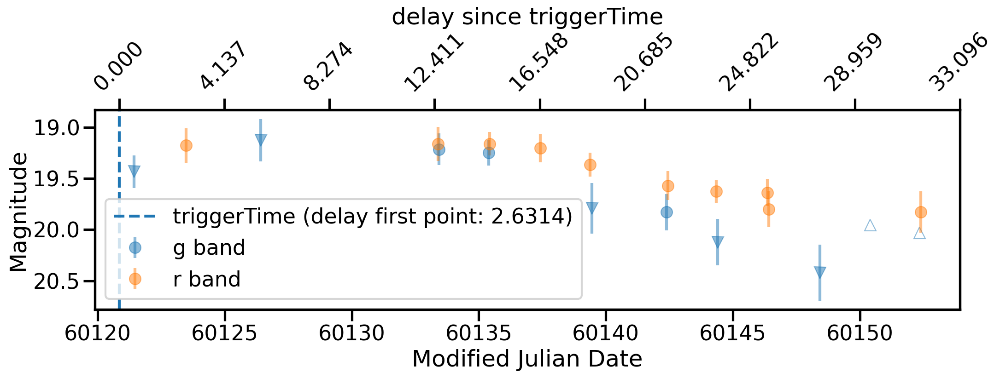

In [94]:
ZTF23aaptbvm.plot_lighcurve()

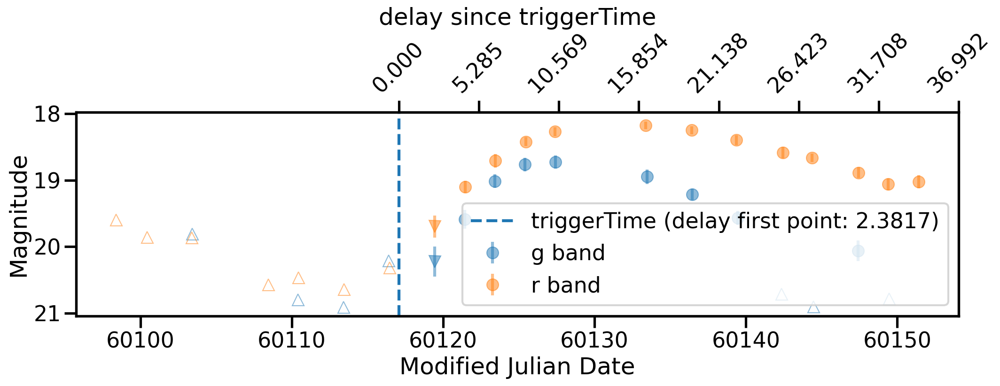

In [69]:
ZTF23aapnixu.plot_lighcurve()

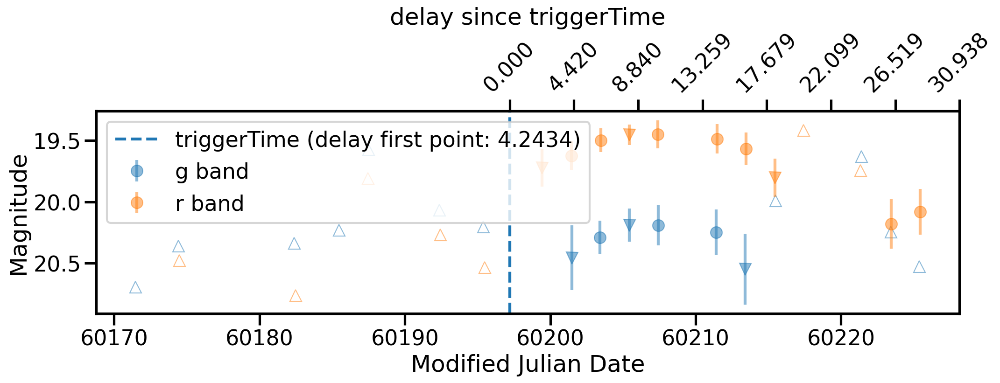

In [88]:
ZTF23abcneqm.plot_lighcurve()

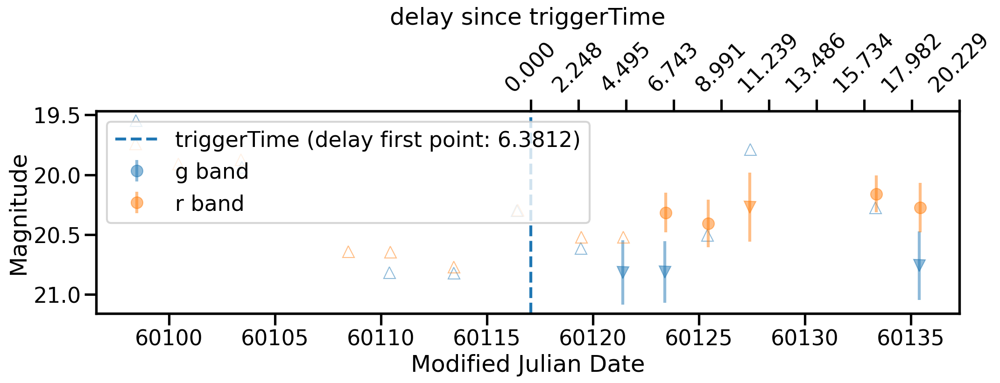

In [70]:
ZTF23aapzouv.plot_lighcurve()

In [197]:
ZTF23aasxykz = data_join.get_gcn_join("713559497", "initial").get_ztf_obj("ZTF23abanmvi")

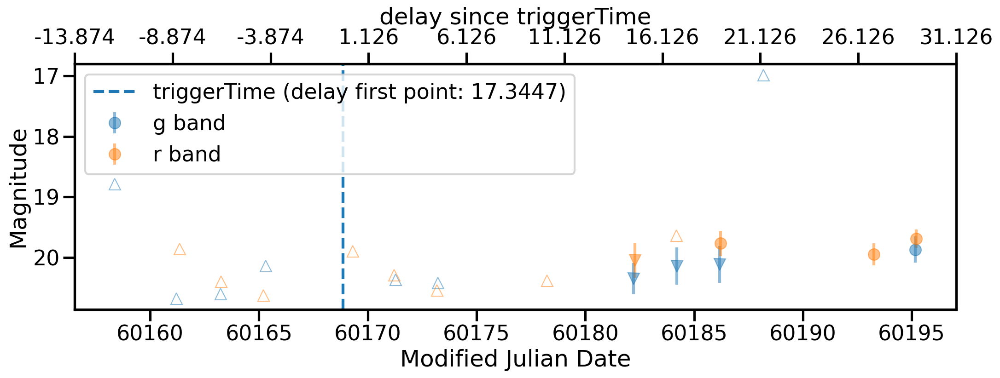

In [198]:
ZTF23aasxykz.plot_lighcurve()

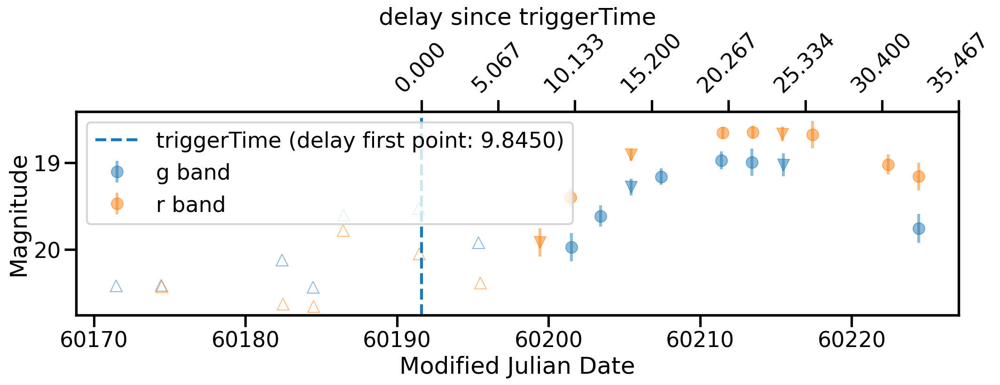

In [78]:
ZTF23abcnhzq.plot_lighcurve()

In [220]:
data_join.save_data_analysis("713085423", "initial", "gcn_analysis/bronze")

|                | GCN INFO                   |
|:---------------|:---------------------------|
| triggerId      | 713085423                  |
| ackTime        | 2023-08-07 11:17:27.663896 |
| triggerTimeUTC | 2023-08-07 09:16:58.150000 |
| observatory    | Fermi                      |
| instrument     | GBM                        |
| event          |                            |
| gcn_status     | initial                    |
| gcn_loc_error  | 2047.0020000000002         |


/spark_mongo_tmp/roman.le-montagner/Doctorat/Fink_MM/notebook/datajoin.py:599: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


nb silver or gold alerts: 0


In [6]:
data_join.save_data_analysis("709864601", "initial", "gcn_analysis/bronze")

|                | GCN INFO                   |
|:---------------|:---------------------------|
| triggerId      | 709864601                  |
| ackTime        | 2023-07-03 11:34:01.615285 |
| triggerTimeUTC | 2023-07-01 02:36:36.750000 |
| observatory    | Fermi                      |
| instrument     | GBM                        |
| event          |                            |
| gcn_status     | initial                    |
| gcn_loc_error  | 237.6                      |


/spark_mongo_tmp/roman.le-montagner/Doctorat/Fink_MM/notebook/datajoin.py:604: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


nb silver or gold alerts: 0


In [4]:
ZTF23aaspcfl = data_join.get_gcn_join("709864601", "initial").get_ztf_obj("ZTF23aaspcfl")

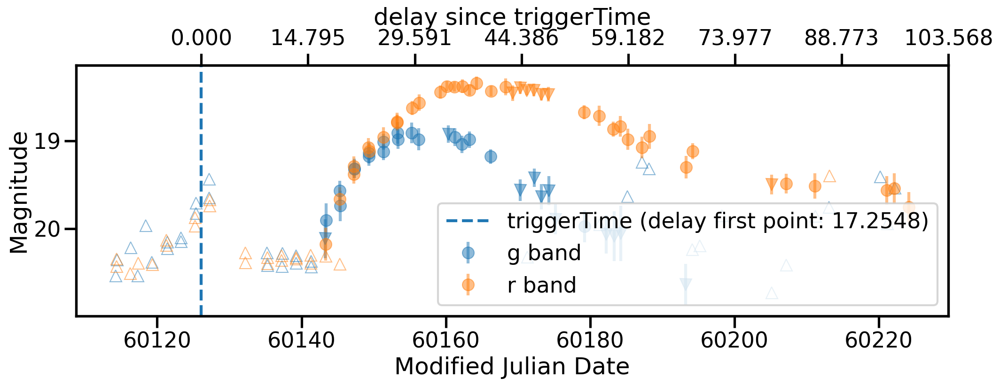

In [39]:
ZTF23aaspcfl.plot_lighcurve()

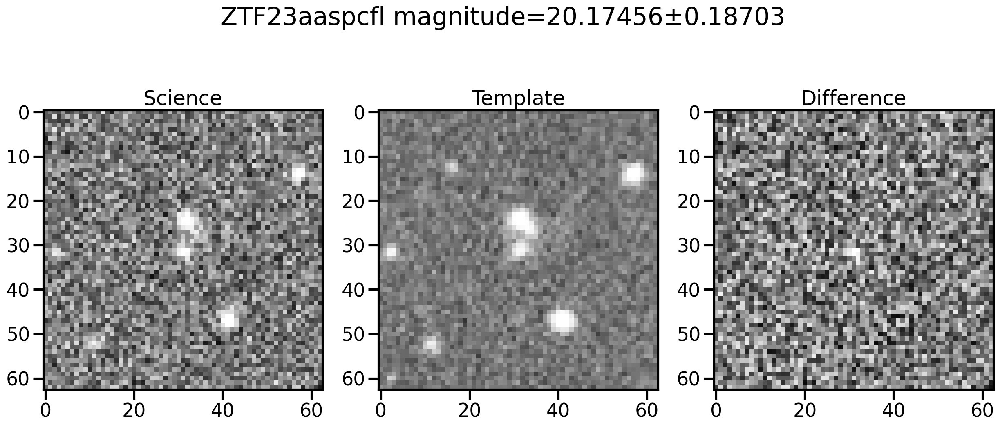

In [38]:
ZTF23aaspcfl.plot_images()

# Look the GCN swift 

In [4]:
swift_pdf = online_pdf[online_pdf["observatory"] == "SWIFT"]

In [5]:
xrt_pdf = swift_pdf[swift_pdf["instrument"] == "XRT"].drop_duplicates("objectId")

In [6]:
xrt_pdf[["triggerId", "gcn_status"]]

,triggerId,gcn_status
186580,1192485,update_3
279859,1192251,update_2
353295,1181187,initial
556140,1182085,initial
564698,1175438,initial
564699,1175438,initial
564700,1175438,initial
564701,1175438,initial
570479,1181187,initial
571206,1180063,initial


ZTF23abhmzvz


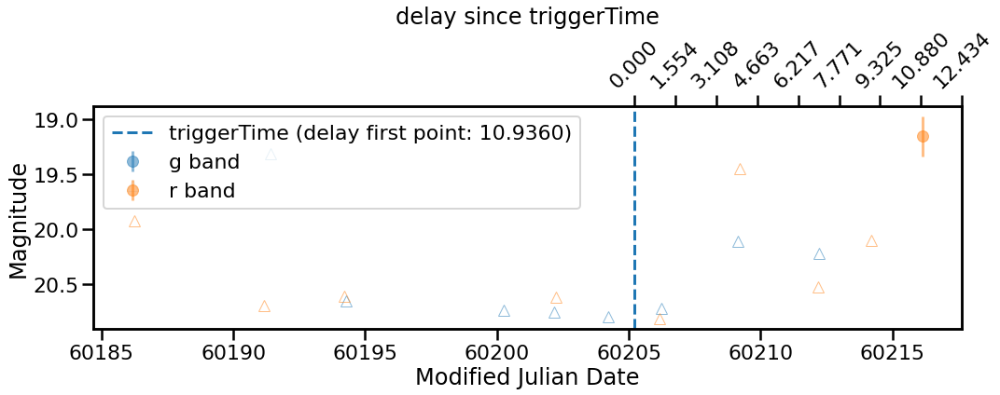



ZTF23abfpcnk


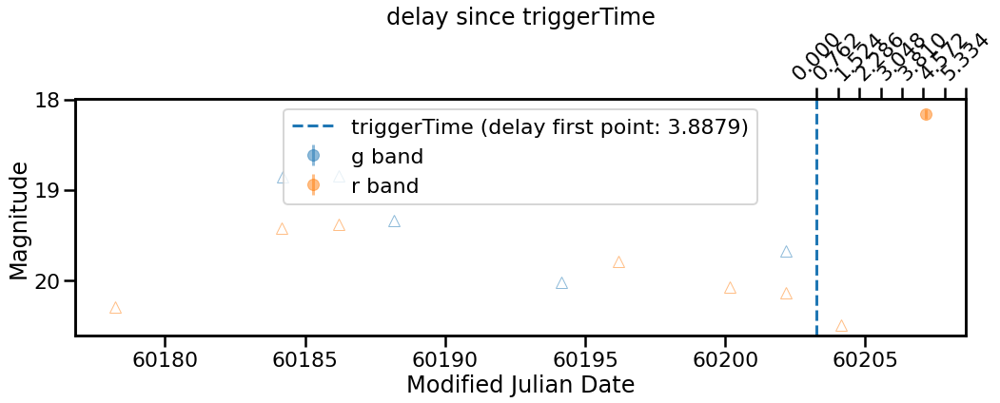



ZTF23aawzgjt


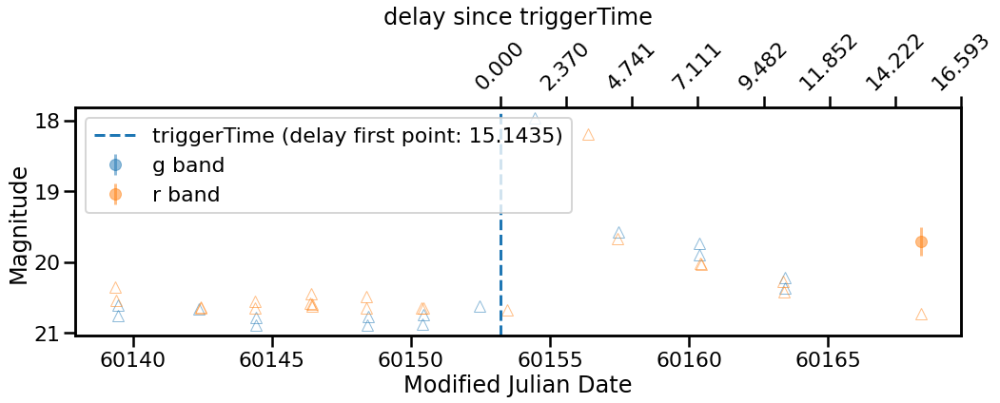



ZTF23aawksmu


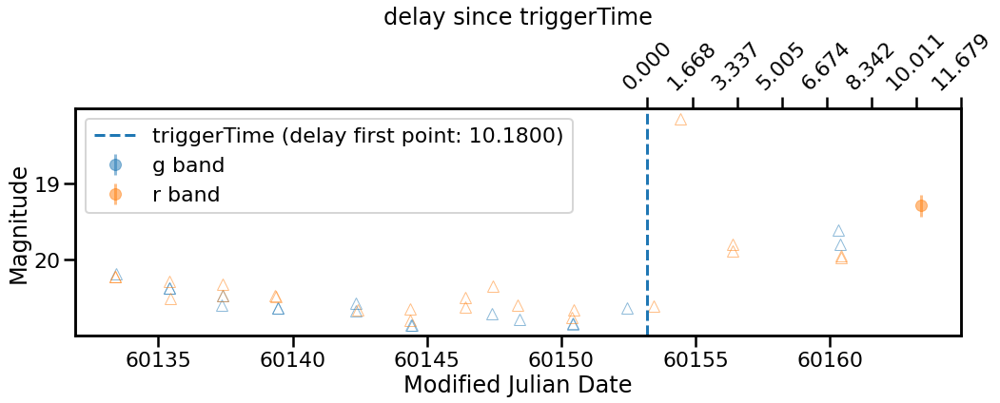



ZTF23aavppnm


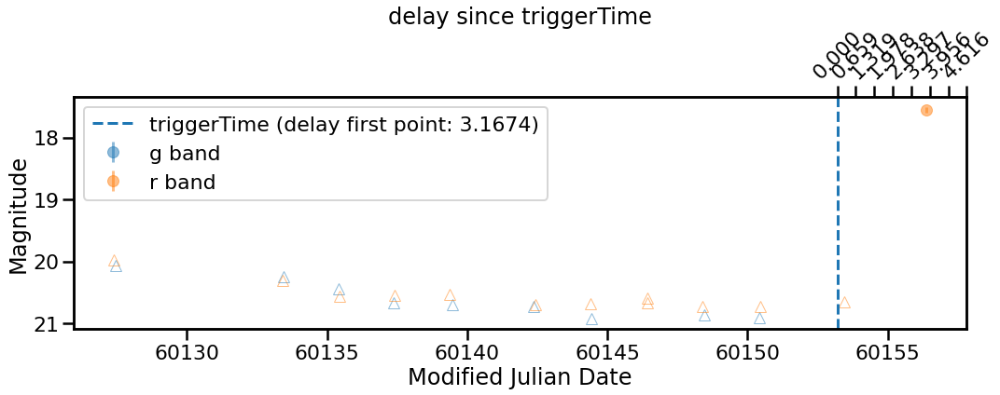



ZTF23aawchaa


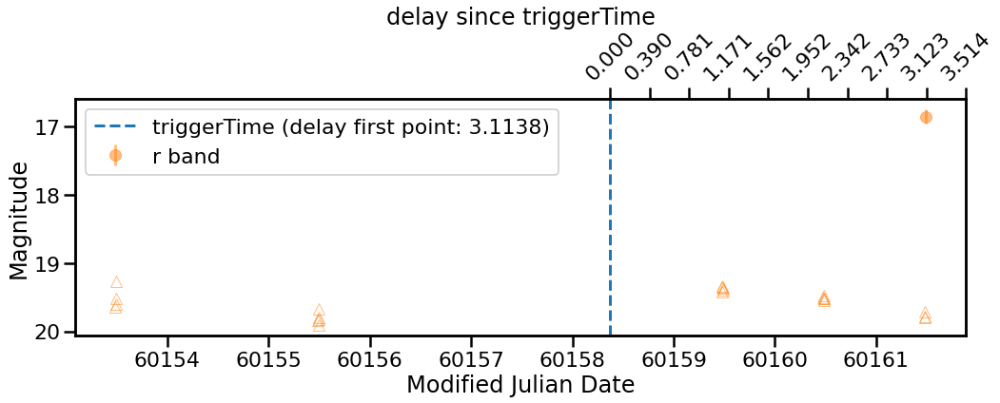



ZTF23aapjmkm


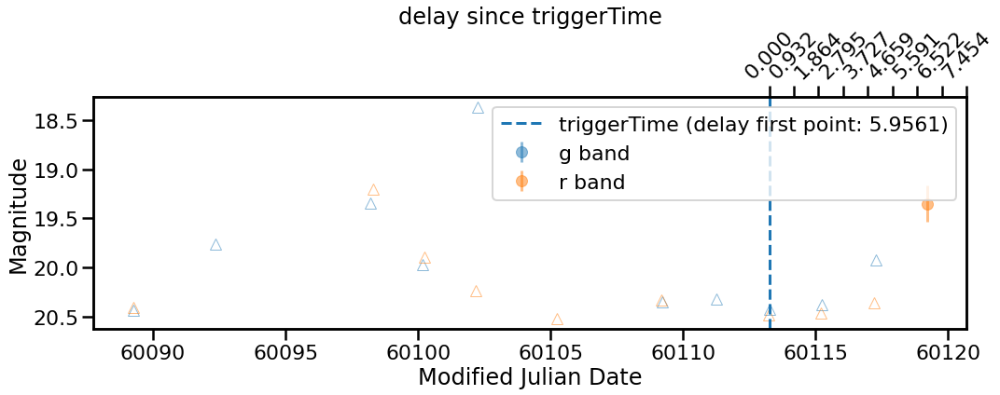



ZTF23aapjmqv
error: Expected object or value
ZTF23aapjmqu


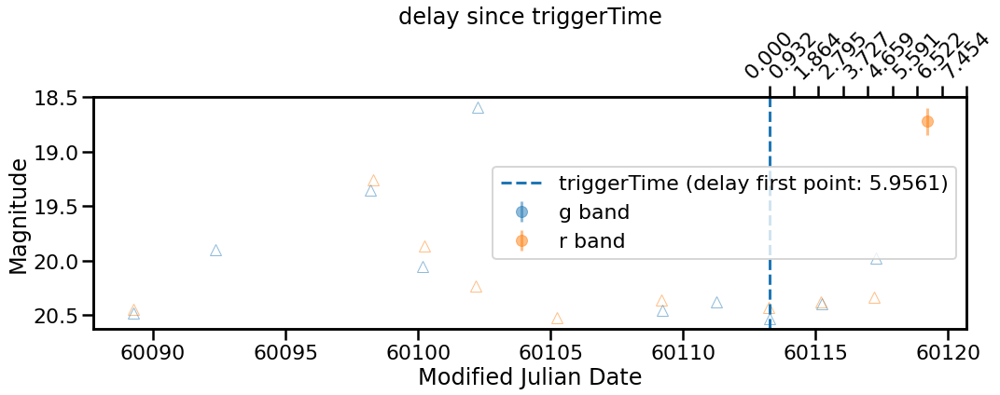



ZTF23aapjmqt


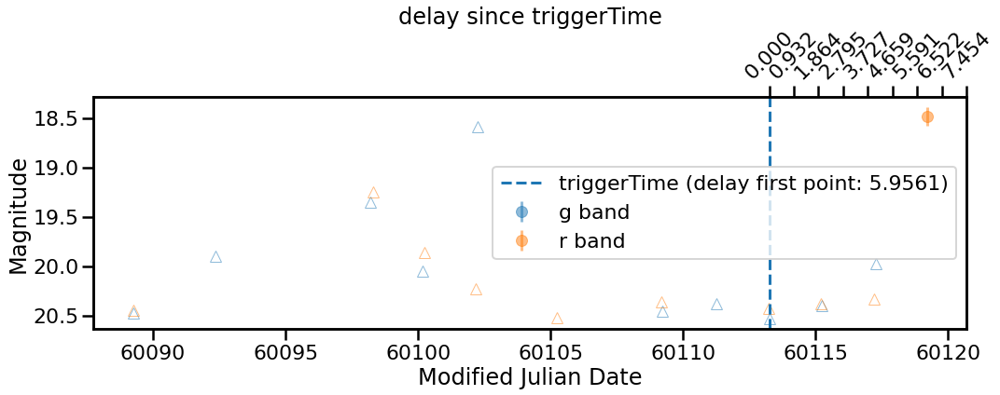



ZTF23aapdpik


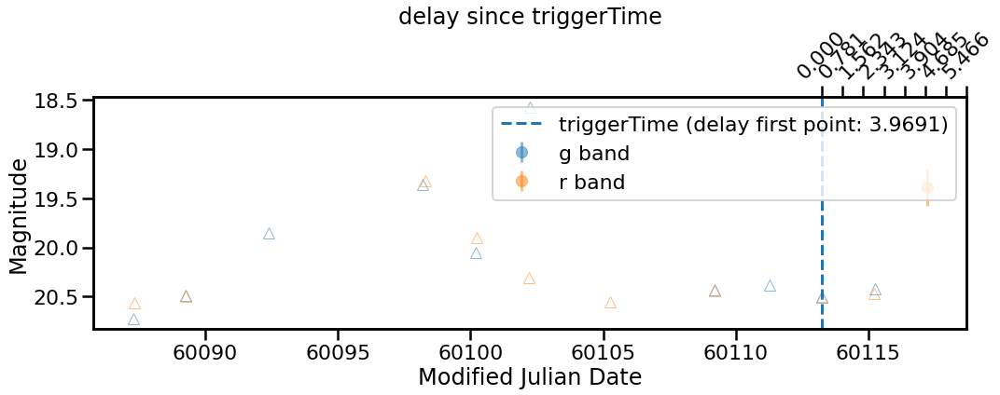



ZTF23aapjmkm


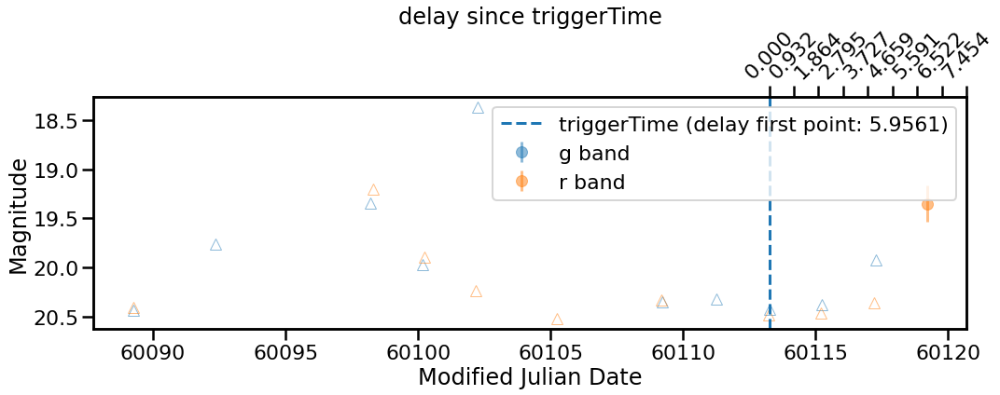



ZTF23aapjmqv
error: Expected object or value
ZTF23aapjmqu


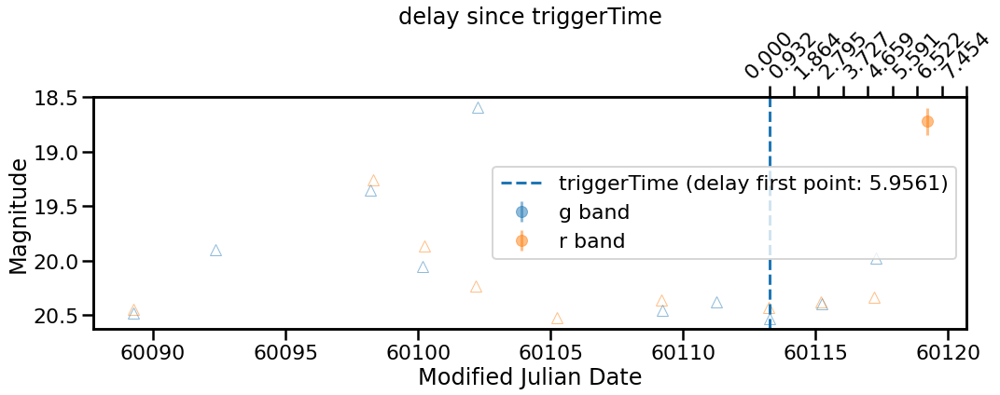



ZTF23aapjmqt


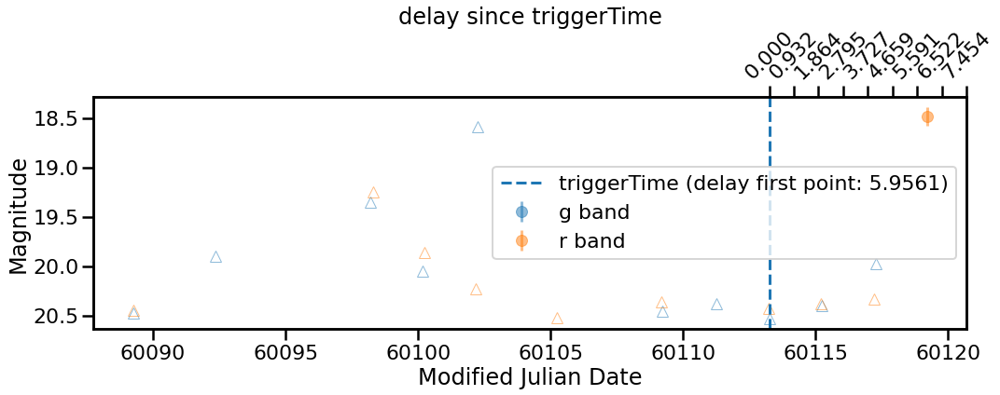



ZTF23aapdpik


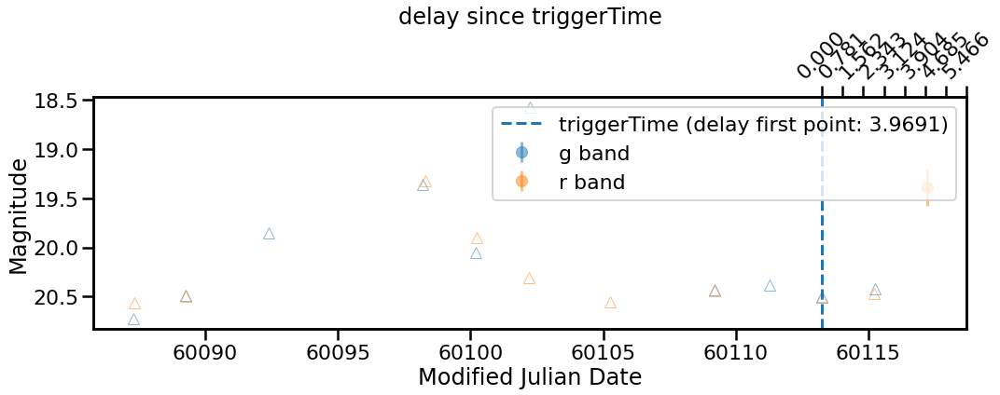



ZTF23aapjmkm


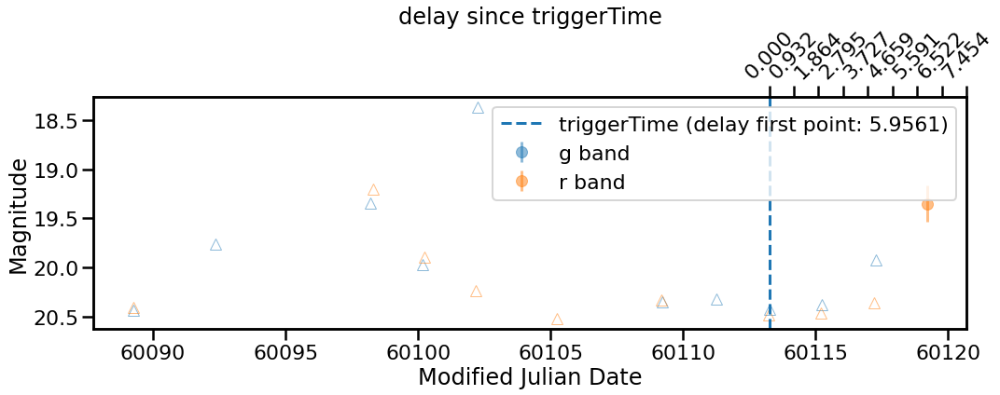



ZTF23aapjmqv
error: Expected object or value
ZTF23aapjmqu


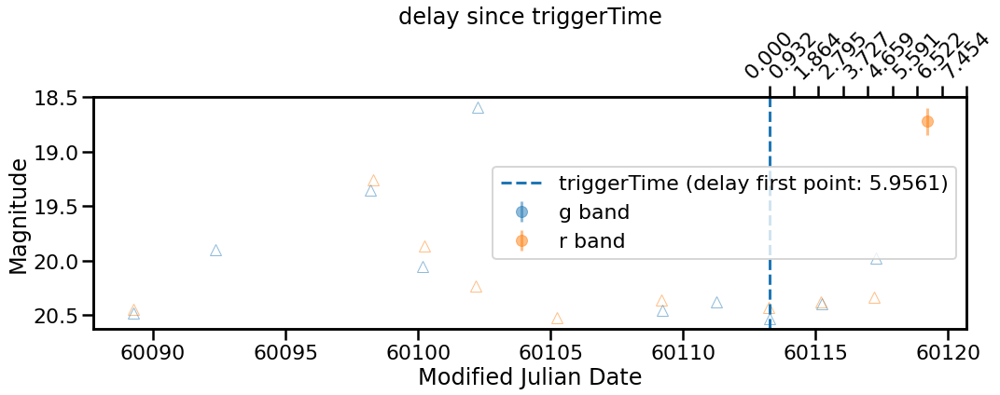



ZTF23aapjmqt


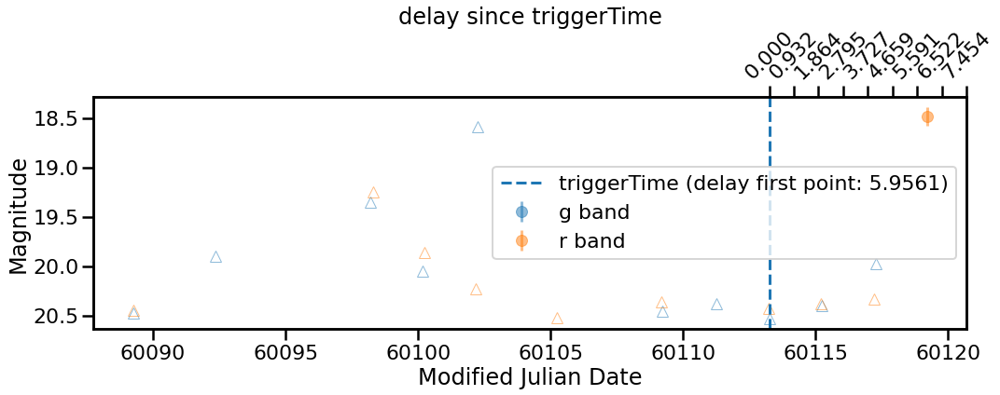



ZTF23aapdpik


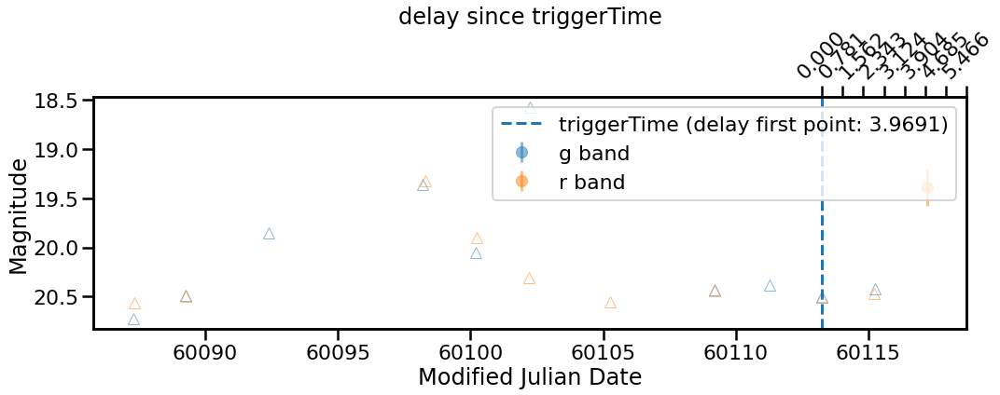



ZTF23aapjmkm


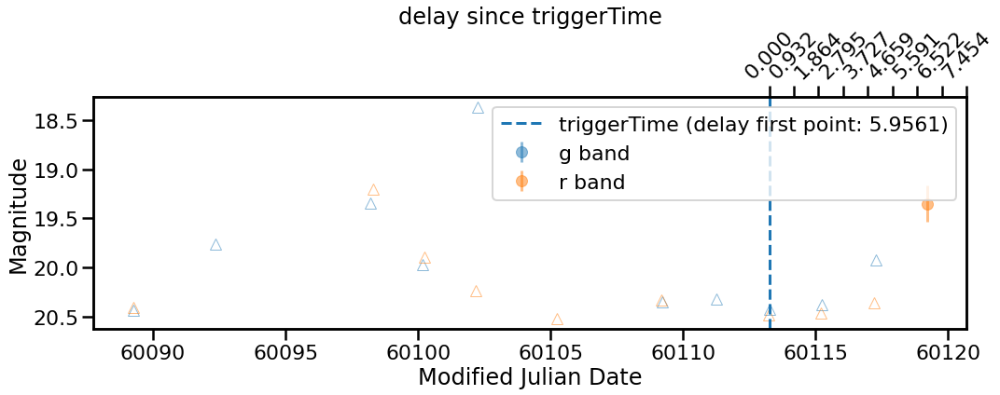



ZTF23aapjmqv
error: Expected object or value
ZTF23aapjmqu


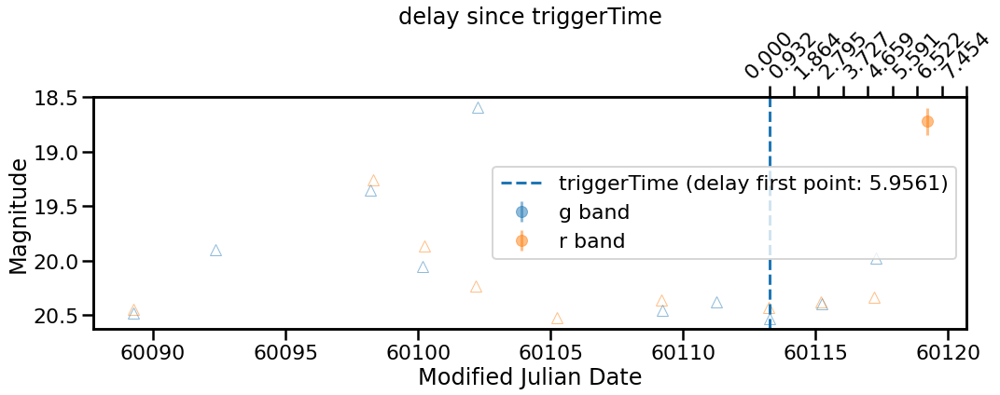



ZTF23aapjmqt


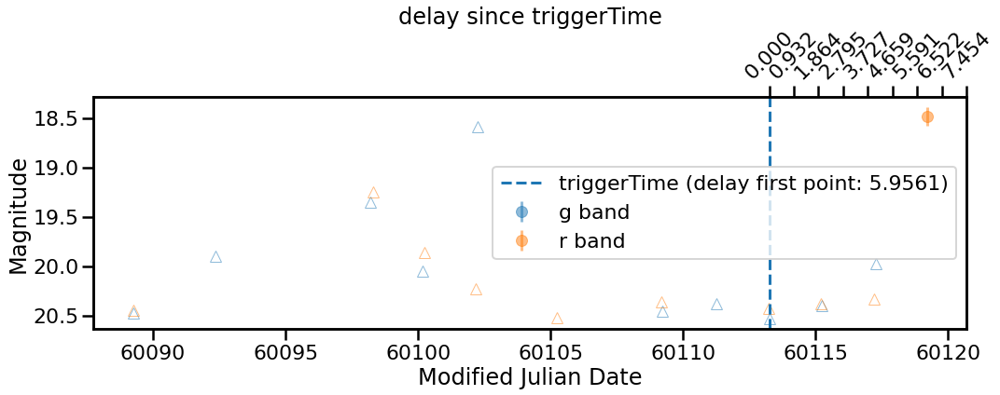



ZTF23aapdpik


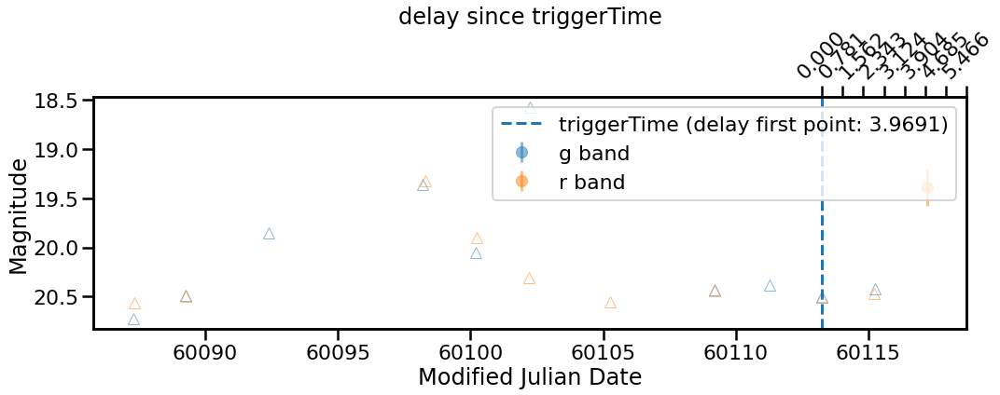



ZTF23aawzgjt


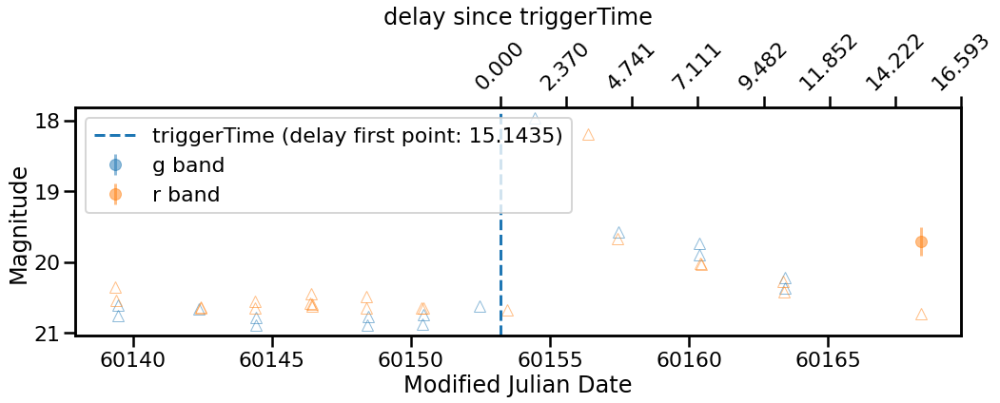



ZTF23aawksmu


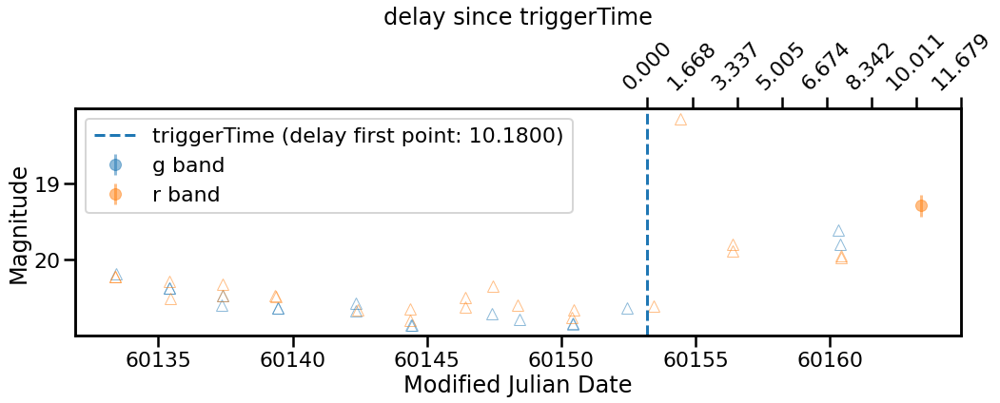



ZTF23aavppnm


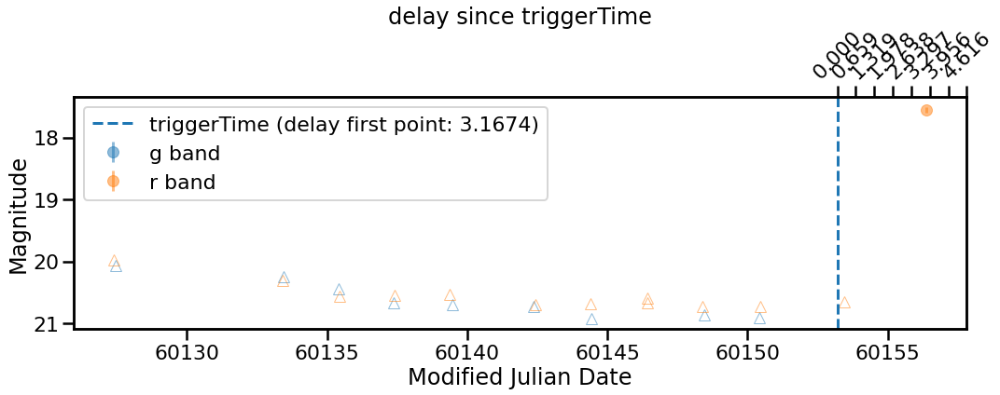



ZTF23aavykmq


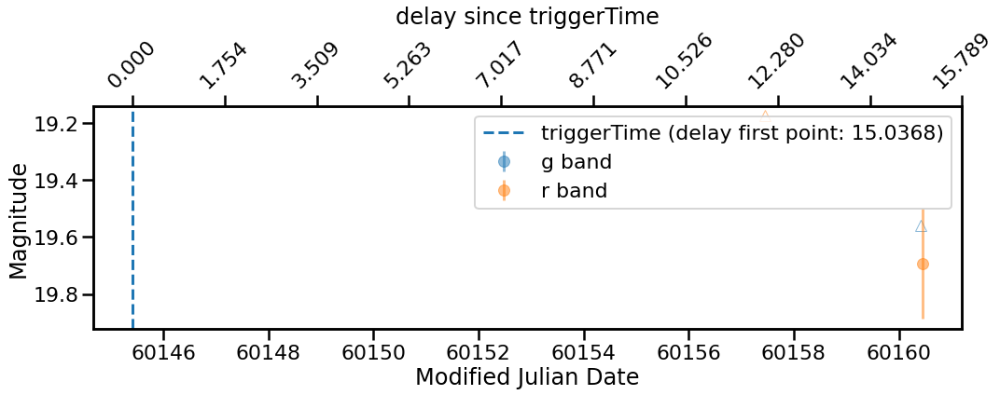



ZTF23aawzgjt


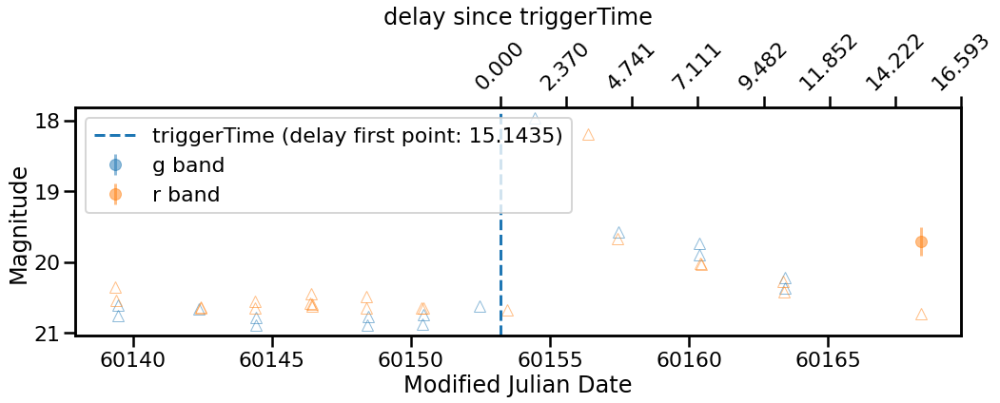



ZTF23aawksmu


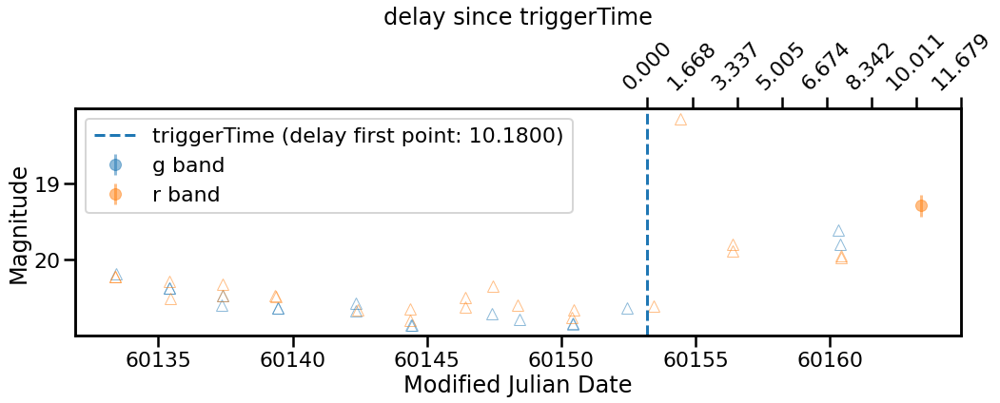



ZTF23aavppnm


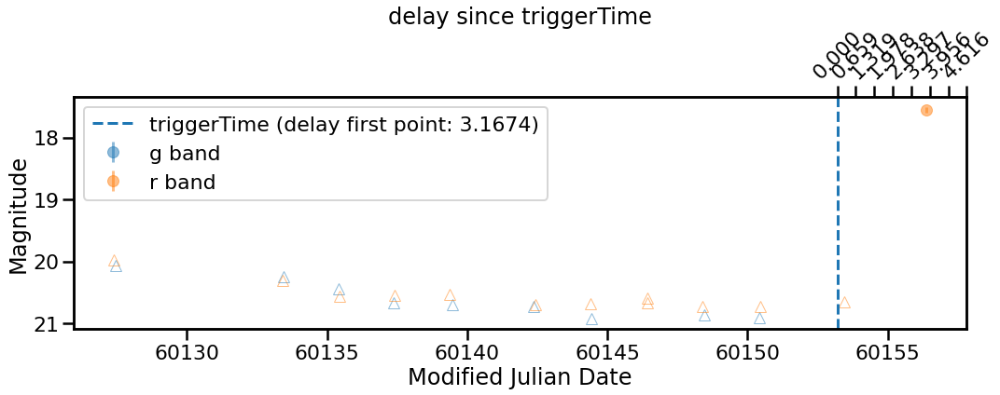



ZTF23abapzga


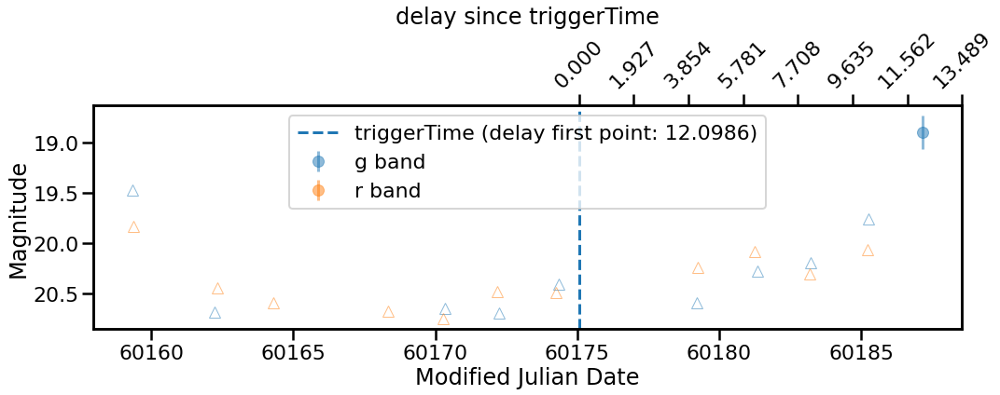



ZTF23abaqlou


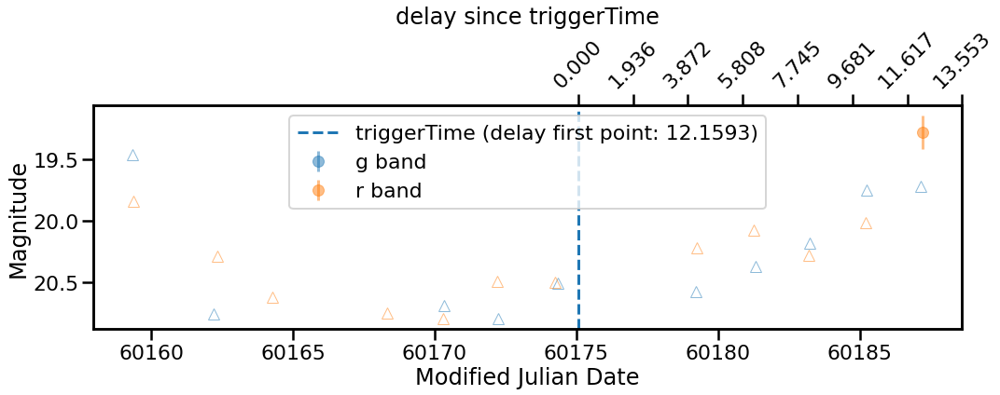



ZTF23abapzdn


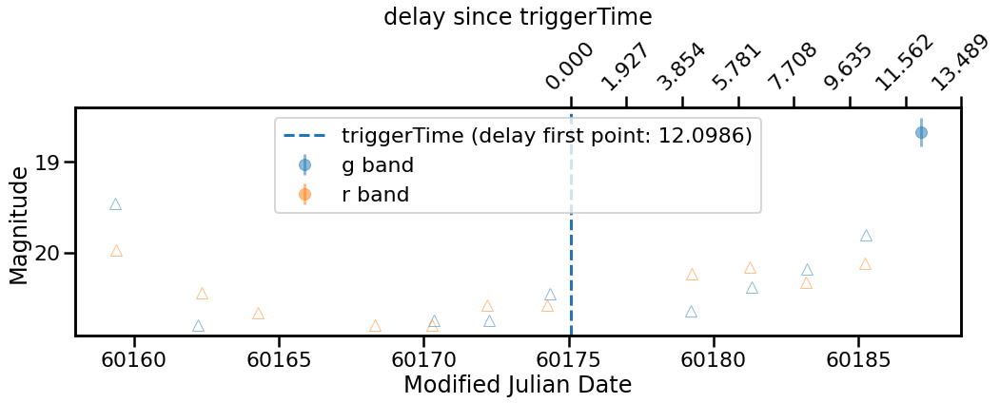



ZTF23abapzga


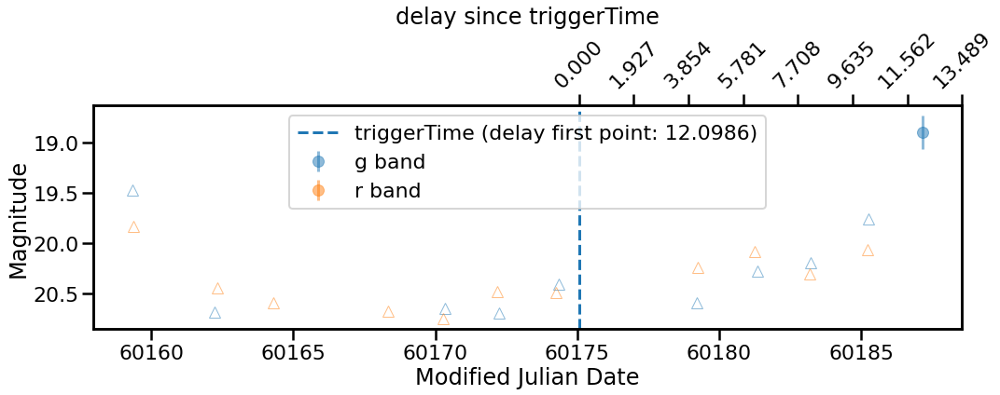



ZTF23abaqlou


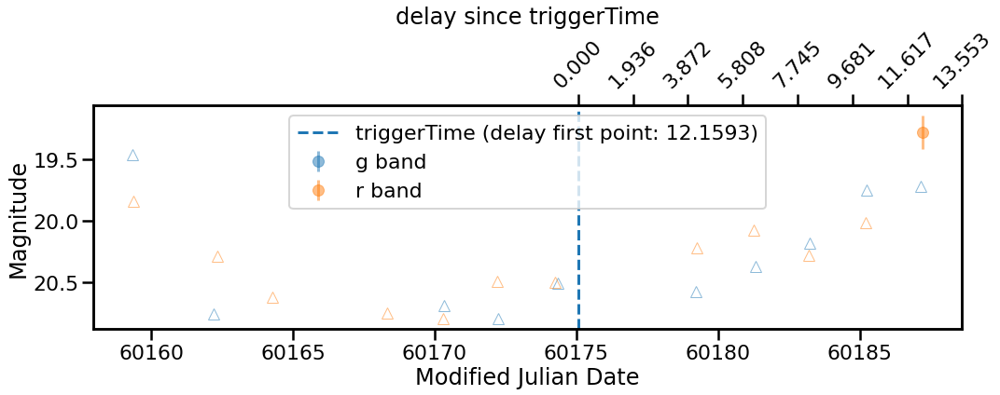



ZTF23abapzdn


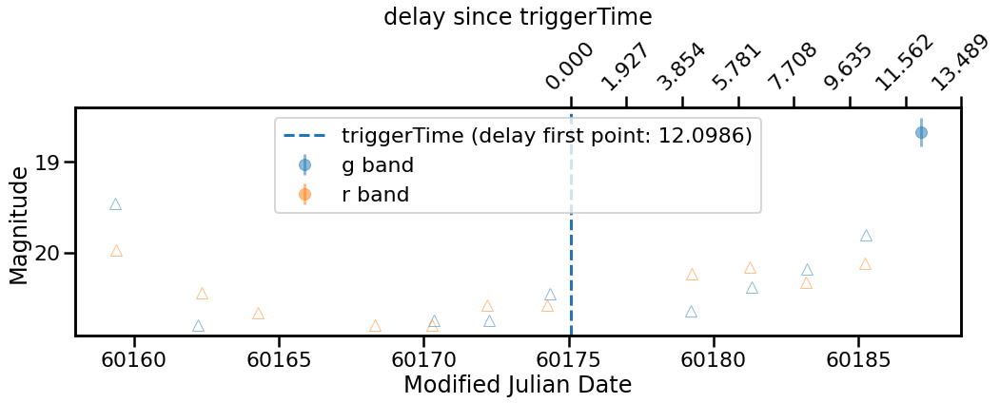



ZTF23abapzga


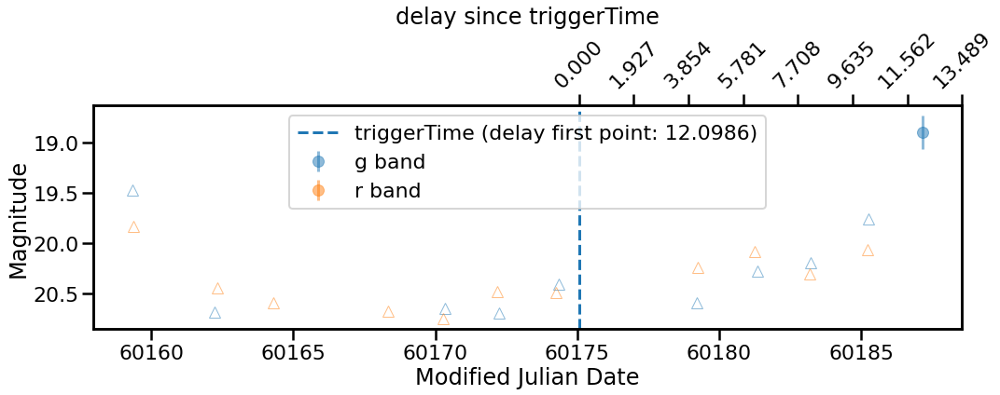



ZTF23abaqlou


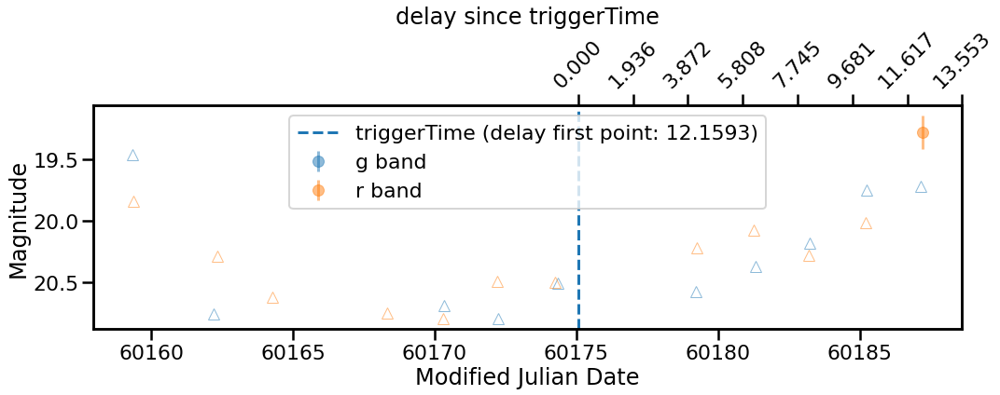



ZTF23abapzdn


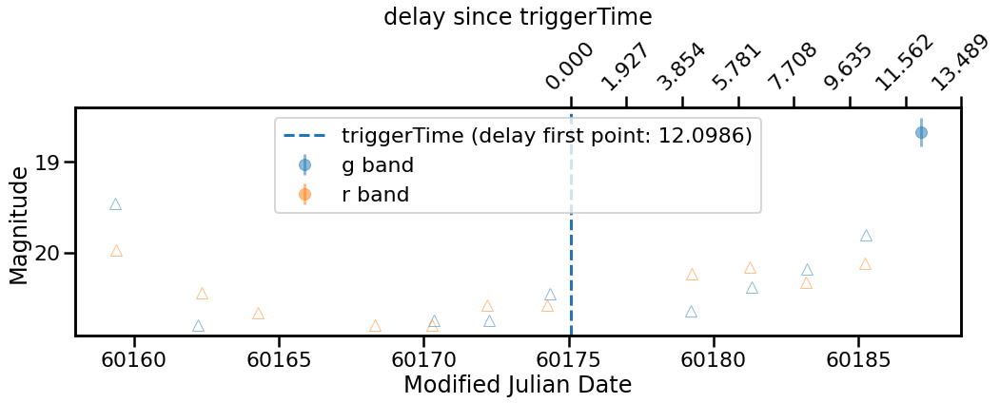



ZTF23aapjmkm


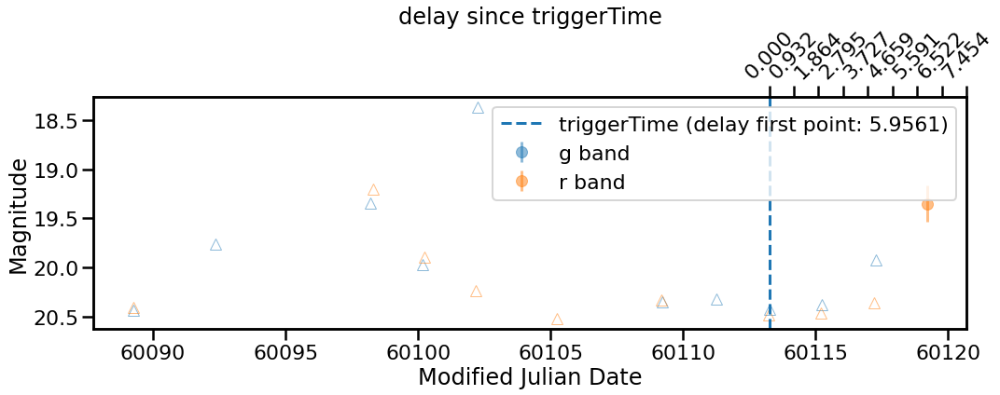



ZTF23aapjmqv
error: Expected object or value
ZTF23aapjmqu


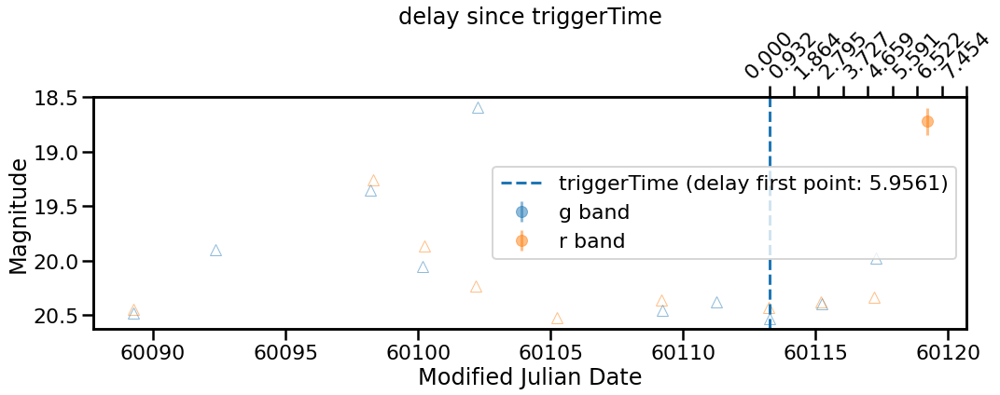



ZTF23aapjmqt


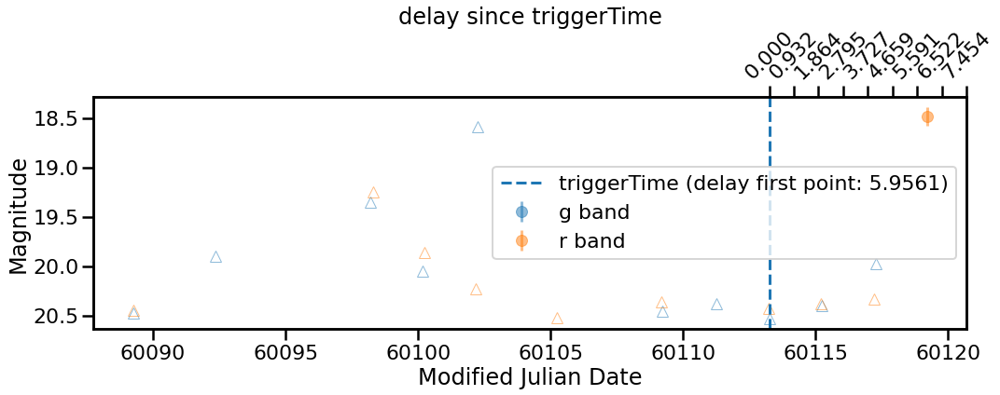



ZTF23aapdpik


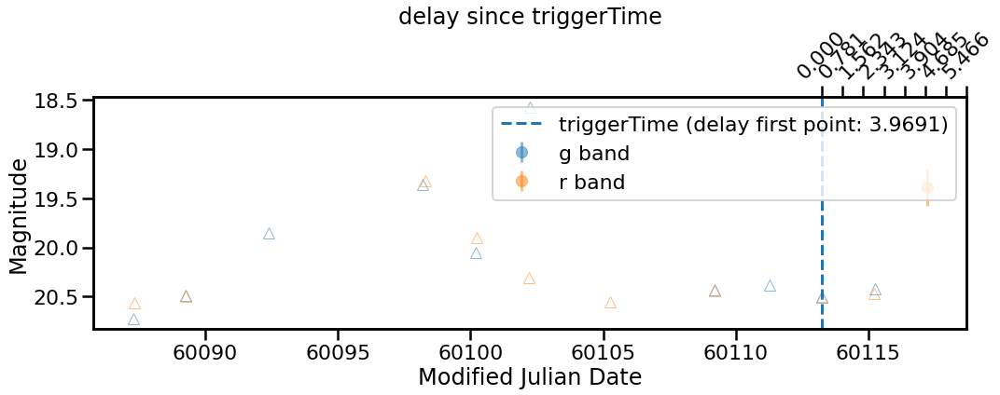

In [10]:
for tId, status in zip(xrt_pdf["triggerId"], xrt_pdf["gcn_status"]):
    gcn_obj = data_join.get_gcn_join(tId, status)
    for objId in gcn_obj.gcn_pdf["objectId"].unique():
        print(objId)
        try:
            ztf_obj = gcn_obj.get_ztf_obj(objId)
            ztf_obj.plot_lighcurve()
        except Exception as e:
            print(f"error: {e}")
            continue
        print()
        print()

In [16]:
# Multi-messenger analysis

In [26]:
mm_gb = online_pdf.groupby("objectId").agg(
    uniqu_obs=("observatory", "unique"),
    uniq_trigId=("triggerId", "unique"),
    uniq_trigTime=("triggerTimejd", "unique"),
    uniqu_obs_nb=("observatory", lambda x: len(np.unique(list(x))))
).sort_values("uniqu_obs_nb")

In [27]:
mm_gb[mm_gb["uniqu_obs_nb"] > 1]

,uniqu_obs,uniq_trigId,uniq_trigTime,uniqu_obs_nb
objectId,,,,
ZTF23aaqxedl,"[ICECUBE, Fermi]","[13806972184188, 710063283, 709938257]","[2460117.9992653937, 2460128.9083115743, 24601...",2
ZTF23aatodvu,"[Fermi, SWIFT]","[711293230, 1180055, 711475906, 711555530]","[2460143.143808102, 2460145.8877814813, 246014...",2
ZTF23aaqxbee,"[ICECUBE, Fermi]","[13806972184188, 710063283]","[2460117.9992653937, 2460128.9083115743]",2
ZTF23aasbmcx,"[ICECUBE, Fermi]","[13812511333473, 710637267]","[2460133.290856829, 2460135.5516487267]",2
ZTF23aaqmitu,"[Fermi, ICECUBE]","[710063283, 13806972184188]","[2460128.9083115743, 2460117.9992653937]",2
...,...,...,...,...
ZTF23aazyjxq,"[Fermi, INTEGRAL]","[713801737, 10371]","[2460172.177461227, 2460174.9221153934]",2
ZTF23aawkwks,"[Fermi, INTEGRAL]","[712482682, 75886, 75877, 10350, 10345, 10342,...","[2460156.910620602, 2460152.0132584493, 246015...",2
ZTF23aaqjyek,"[ICECUBE, Fermi]","[13806972184188, 710063283]","[2460117.9992653937, 2460128.9083115743]",2


In [ ]:
mm_gb["uniq_trigTime"].apply(lambda x: np.array(x) - np.array(x))

In [25]:
online_pdf[online_pdf["objectId"] == "ZTF23aasbmcx"]

,observatory,instrument,event,triggerId,gcn_ra,gcn_dec,gcn_loc_error,ackTime,triggerTimeUTC,gcn_status,...,timestamp,is_grb_bronze,is_grb_silver,is_grb_gold,is_gw_bronze,year,month,day,triggerTimejd,ackTimejd
489192,ICECUBE,,GOLD,13812511333473,269.0299,-1.9399,0.680,2023-07-07 22:15:46.602802,2023-07-07 18:58:50.030,initial,...,2023-07-15 07:45:32.999043,False,False,False,False,2023,7,15,2.460133e+06,2.460133e+06
489195,Fermi,GBM,,710637267,265.7333,23.9333,1663.002,2023-07-10 03:14:52.668148,2023-07-10 01:14:22.450,initial,...,2023-07-15 07:45:32.999043,True,False,False,False,2023,7,15,2.460136e+06,2.460136e+06


In [37]:
t = np.array([2, 8, 9, 6, 4, 3])

In [38]:
t[1:] - t[:-1]

array([ 6,  1, -3, -2, -1])

# Look at the Kilonova/Supernova tag

In [35]:
kn_pdf = no_filter_pdf[no_filter_pdf["fink_class"] == "Kilonova candidate"].sort_values("gcn_loc_error")

In [36]:
kn_pdf

,observatory,instrument,event,triggerId,gcn_ra,gcn_dec,gcn_loc_error,ackTime,triggerTimeUTC,gcn_status,...,timestamp,is_grb_bronze,is_grb_silver,is_grb_gold,is_gw_bronze,year,month,day,triggerTimejd,ackTimejd
573244,Fermi,GBM,,711299080,29.7667,71.4667,412.998,2023-07-17 19:05:44.323796,2023-07-17 17:04:35.890,initial,...,2023-08-06 10:52:54.001922,False,False,False,False,2023,8,6,2.460143e+06,2.460143e+06
556408,Fermi,GBM,,711299080,29.7667,71.4667,412.998,2023-07-17 19:05:44.323796,2023-07-17 17:04:35.890,initial,...,2023-08-03 11:14:07.995856,False,False,False,False,2023,8,3,2.460143e+06,2.460143e+06
610817,Fermi,GBM,,717342217,289.6000,-34.9167,642.000,2023-09-25 17:43:49.556825,2023-09-25 15:43:32.210,update_0,...,2023-09-30 03:33:36.999359,False,False,False,False,2023,9,30,2.460213e+06,2.460213e+06
372293,Fermi,GBM,,712953666,35.3500,64.7333,780.000,2023-08-05 22:41:30.693030,2023-08-05 20:41:01.300,initial,...,2023-08-12 11:16:10.001270,False,False,False,False,2023,8,12,2.460162e+06,2.460162e+06
310411,Fermi,GBM,,711248946,357.5000,24.3500,1027.002,2023-07-17 05:09:31.796182,2023-07-17 03:09:01.310,initial,...,2023-07-17 10:35:48.001935,False,False,False,False,2023,7,17,2.460143e+06,2.460143e+06
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
603514,Fermi,GBM,,715526984,107.6833,85.1667,3000.000,2023-09-04 17:30:33.583924,2023-09-04 15:29:39.520,initial,...,2023-09-07 05:05:38.996163,False,False,False,False,2023,9,7,2.460192e+06,2.460192e+06
565419,Fermi,GBM,,717348234,4.8167,83.0833,3000.000,2023-09-25 19:24:48.146791,2023-09-25 17:23:49.930,update_2,...,2023-10-05 04:14:32.997102,False,False,False,False,2023,10,5,2.460213e+06,2.460213e+06
599480,Fermi,GBM,,715526984,107.6833,85.1667,3000.000,2023-09-04 17:30:33.583924,2023-09-04 15:29:39.520,initial,...,2023-09-08 11:46:58.995827,False,False,False,False,2023,9,8,2.460192e+06,2.460192e+06
376291,Fermi,GBM,,710291672,356.6667,32.4500,3000.000,2023-07-06 03:15:55.907367,2023-07-06 01:14:27.420,initial,...,2023-07-21 07:43:50.001613,False,False,False,False,2023,7,21,2.460132e+06,2.460132e+06


In [38]:
kn_pdf[kn_pdf["triggerId"] == "711299080"]["objectId"]

573244    ZTF23aavvdix
556408    ZTF23aavvdix
Name: objectId, dtype: object

In [44]:
gcn_711299080 = data_join.get_gcn_join("711299080", "initial")

In [49]:
gcn_711299080.gcn_pdf[gcn_711299080.gcn_pdf["fink_class"] == "SN candidate"]["objectId"]

556407    ZTF23aavvdix
556409    ZTF23aavvdix
570096    ZTF23aavvipn
Name: objectId, dtype: object

In [50]:
ZTF23aavvdix = gcn_711299080.get_ztf_obj("ZTF23aavvdix")
ZTF23aavvipn = gcn_711299080.get_ztf_obj("ZTF23aavvipn")

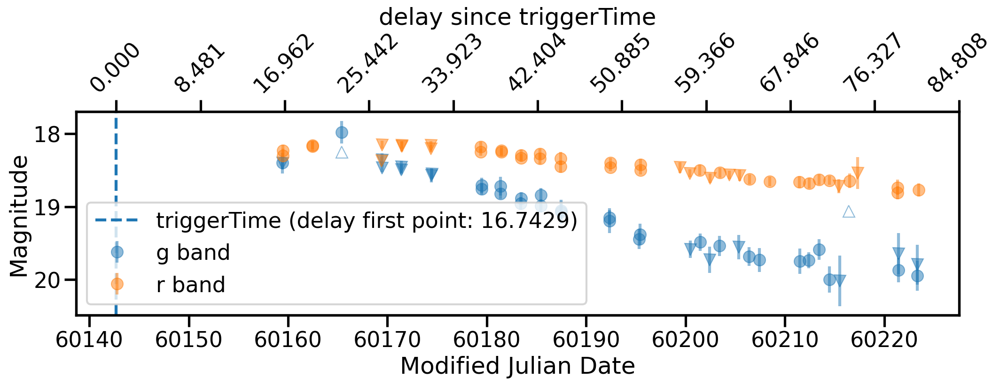

In [46]:
ZTF23aavvdix.plot_lighcurve()

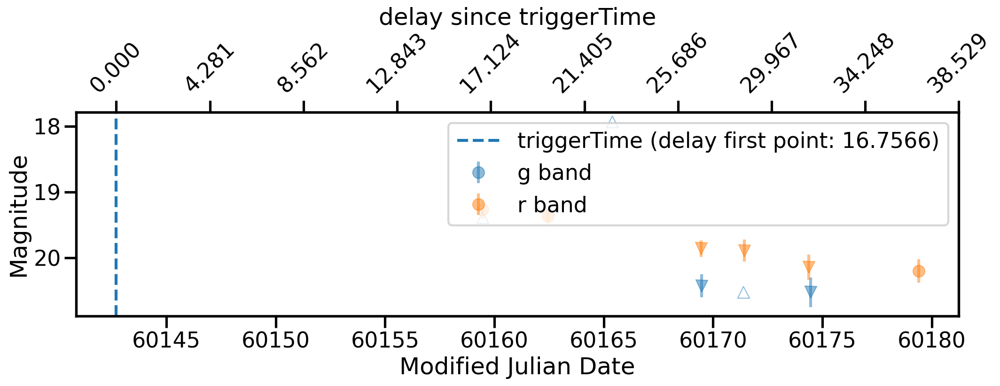

In [51]:
ZTF23aavvipn.plot_lighcurve()

In [34]:
data_join.save_data_analysis("711299080", "initial", "gcn_analysis/with_kilonova")

|                | GCN INFO                   |
|:---------------|:---------------------------|
| triggerId      | 711299080                  |
| ackTime        | 2023-07-17 19:05:44.323796 |
| triggerTimeUTC | 2023-07-17 17:04:35.890000 |
| observatory    | Fermi                      |
| instrument     | GBM                        |
| event          |                            |
| gcn_status     | initial                    |
| gcn_loc_error  | 412.998                    |


/spark_mongo_tmp/roman.le-montagner/Doctorat/Fink_MM/notebook/datajoin.py:604: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


nb silver or gold alerts: 0


In [52]:
sn_pdf = no_filter_pdf[no_filter_pdf["fink_class"] == "SN candidate"].sort_values("gcn_loc_error")

In [76]:
sn_pdf_bronze = bronze_pdf[bronze_pdf["fink_class"] == "SN candidate"].sort_values("gcn_loc_error")

In [68]:
sn_pdf[sn_pdf["gcn_loc_error"] <= 300][["triggerId", "gcn_status", "gcn_loc_error"]]

,triggerId,gcn_status,gcn_loc_error
486186,13819321103478,initial,1.87
435994,716007606,initial,171.60
613856,709410255,initial,207.00
433742,709410255,initial,207.00
188078,709864601,initial,237.60
439803,709864601,initial,237.60
383316,716835508,update_0,244.80
398466,716835508,update_0,244.80
398464,716835508,update_0,244.80
578929,715534985,initial,249.00


In [79]:
sn_pdf_bronze[sn_pdf_bronze["gcn_loc_error"] <= 300][["observatory", "instrument", "event", "triggerId", "gcn_status", "gcn_loc_error"]].drop_duplicates("triggerId")

,observatory,instrument,event,triggerId,gcn_status,gcn_loc_error
615469,Fermi,GBM,,708758776,initial,60.000
536199,Fermi,GBM,,714771169,initial,121.200
576298,Fermi,GBM,,716007606,initial,171.600
565659,Fermi,GBM,,718100620,update_1,202.200
400195,Fermi,GBM,,709410255,initial,207.000
330380,Fermi,GBM,,711805358,initial,215.400
535407,Fermi,GBM,,709864601,initial,237.600
441964,Fermi,GBM,,715534985,initial,249.000
401387,Fermi,GBM,,715523296,initial,250.002
434188,Fermi,GBM,,709083929,initial,272.400


In [65]:
def plot_SN_lc(triggerId, status):
    gcn = data_join.get_gcn_join(triggerId, status)
    data_join.save_data_analysis(triggerId, status, "gcn_analysis/with_supernova")
    for objId in gcn.gcn_pdf[gcn.gcn_pdf["fink_class"] == "SN candidate"]["objectId"].unique():
        print(objId)
        gcn.get_ztf_obj(objId).plot_lighcurve()
        print()
        print()

|                | GCN INFO                   |
|:---------------|:---------------------------|
| triggerId      | 13819321103478             |
| ackTime        | 2023-07-26 06:23:36.467309 |
| triggerTimeUTC | 2023-07-25 23:30:51.060000 |
| observatory    | ICECUBE                    |
| instrument     |                            |
| event          | BRONZE                     |
| gcn_status     | initial                    |
| gcn_loc_error  | 1.87                       |


/spark_mongo_tmp/roman.le-montagner/Doctorat/Fink_MM/notebook/datajoin.py:604: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


nb silver or gold alerts: 0
ZTF23aawyvap


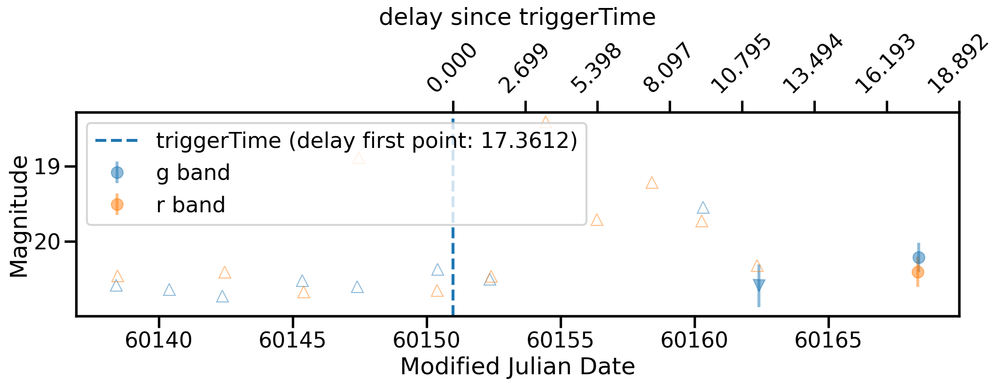

In [67]:
plot_SN_lc("13819321103478", "initial")

|                | GCN INFO                   |
|:---------------|:---------------------------|
| triggerId      | 716835508                  |
| ackTime        | 2023-09-19 20:59:13.112713 |
| triggerTimeUTC | 2023-09-19 18:58:23.860000 |
| observatory    | Fermi                      |
| instrument     | GBM                        |
| event          |                            |
| gcn_status     | update_0                   |
| gcn_loc_error  | 244.8                      |


/spark_mongo_tmp/roman.le-montagner/Doctorat/Fink_MM/notebook/datajoin.py:604: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


nb silver or gold alerts: 0
ZTF23abgtnlg


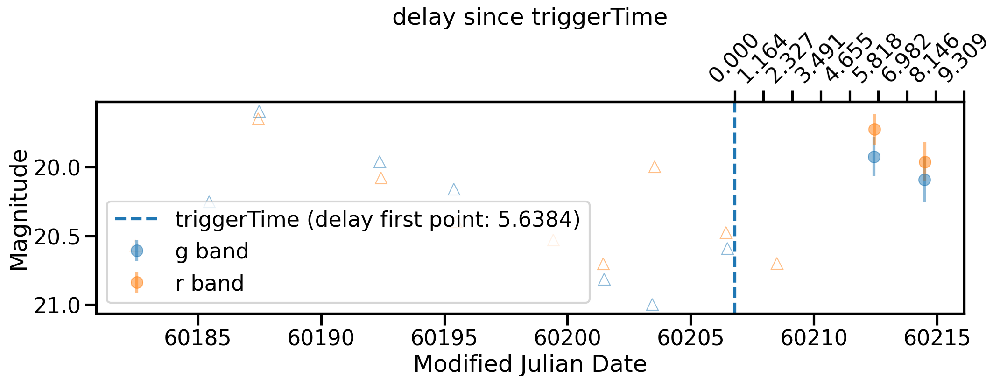

In [69]:
plot_SN_lc("716835508", "update_0")

|                | GCN INFO                   |
|:---------------|:---------------------------|
| triggerId      | 715534985                  |
| ackTime        | 2023-09-04 19:44:11.749182 |
| triggerTimeUTC | 2023-09-04 17:43:00.520000 |
| observatory    | Fermi                      |
| instrument     | GBM                        |
| event          |                            |
| gcn_status     | initial                    |
| gcn_loc_error  | 249.00000000000003         |
nb silver or gold alerts: 0
ZTF23abdxree


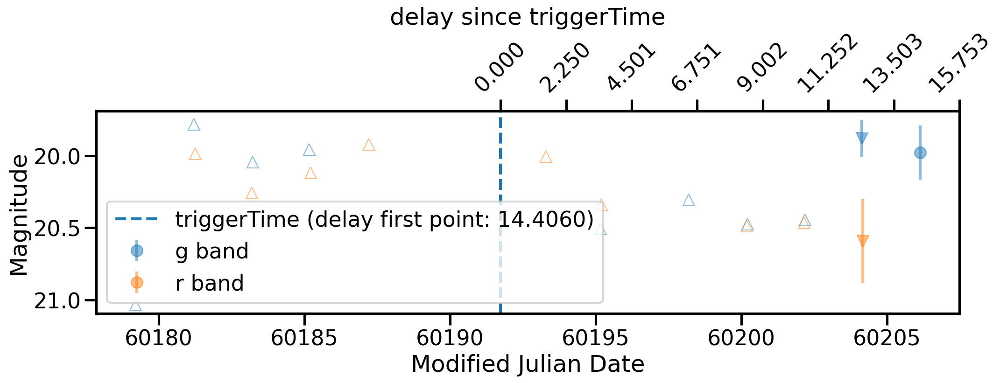



ZTF23abcqzvm


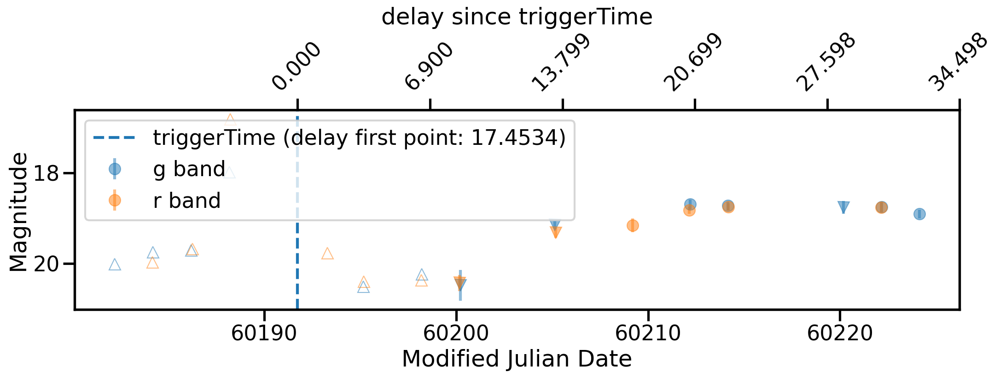

In [72]:
plot_SN_lc("715534985", "initial")

|                | GCN INFO                   |
|:---------------|:---------------------------|
| triggerId      | 715429986                  |
| ackTime        | 2023-09-03 14:42:24.449788 |
| triggerTimeUTC | 2023-09-03 12:33:01.610000 |
| observatory    | Fermi                      |
| instrument     | GBM                        |
| event          |                            |
| gcn_status     | initial                    |
| gcn_loc_error  | 276.6                      |
nb silver or gold alerts: 0
ZTF23abceswn


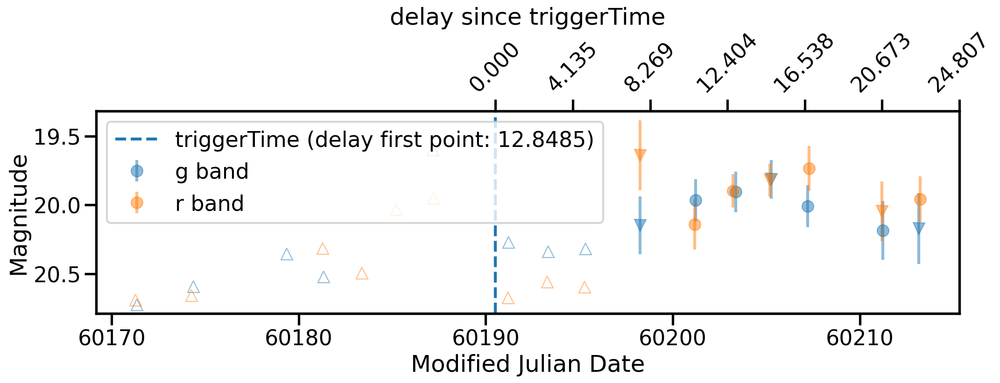



ZTF23abdmgav


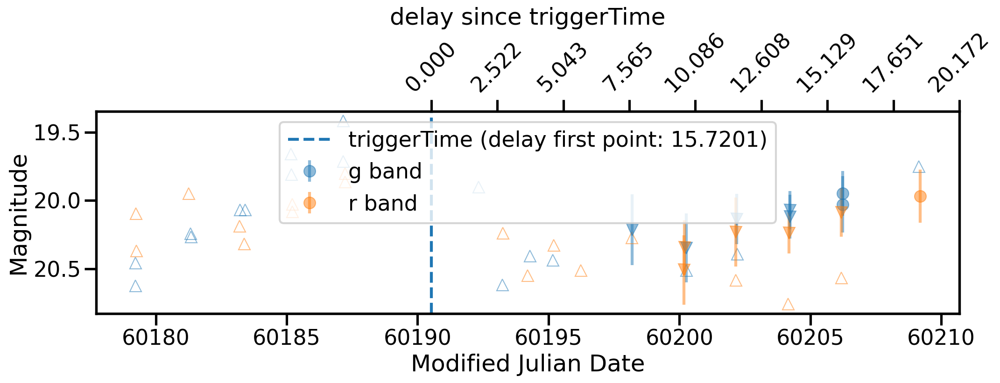



ZTF23abdyiuo


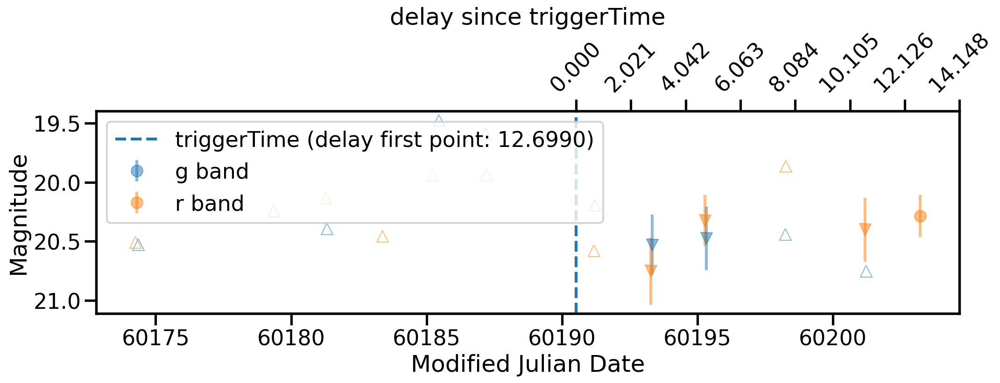

In [73]:
plot_SN_lc("715429986", "initial")

|                | GCN INFO                   |
|:---------------|:---------------------------|
| triggerId      | 708758776                  |
| ackTime        | 2023-06-18 09:36:26.750599 |
| triggerTimeUTC | 2023-06-18 07:26:11.930000 |
| observatory    | Fermi                      |
| instrument     | GBM                        |
| event          |                            |
| gcn_status     | initial                    |
| gcn_loc_error  | 60.0                       |


/spark_mongo_tmp/roman.le-montagner/Doctorat/Fink_MM/notebook/datajoin.py:604: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


nb silver or gold alerts: 173
too much ztf object
ZTF23aaotsdz


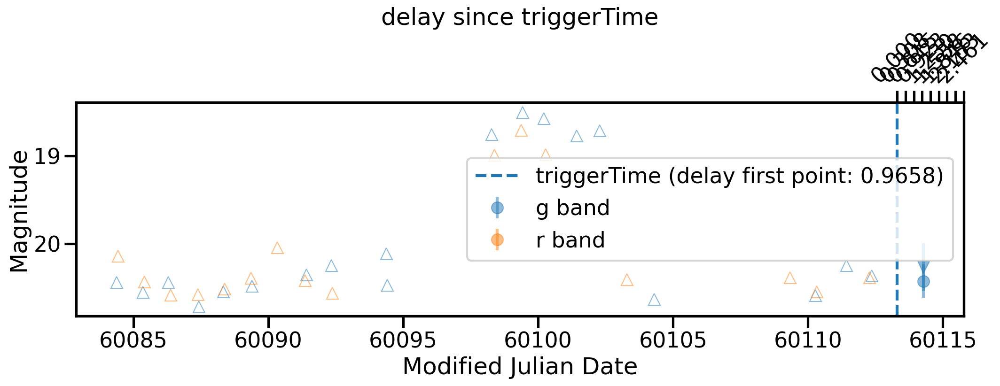

In [80]:
plot_SN_lc("708758776", "initial")

|                | GCN INFO                   |
|:---------------|:---------------------------|
| triggerId      | 714771169                  |
| ackTime        | 2023-08-26 23:42:10.736537 |
| triggerTimeUTC | 2023-08-26 21:32:44.530000 |
| observatory    | Fermi                      |
| instrument     | GBM                        |
| event          |                            |
| gcn_status     | initial                    |
| gcn_loc_error  | 121.2                      |
nb silver or gold alerts: 0
ZTF23abbkyty


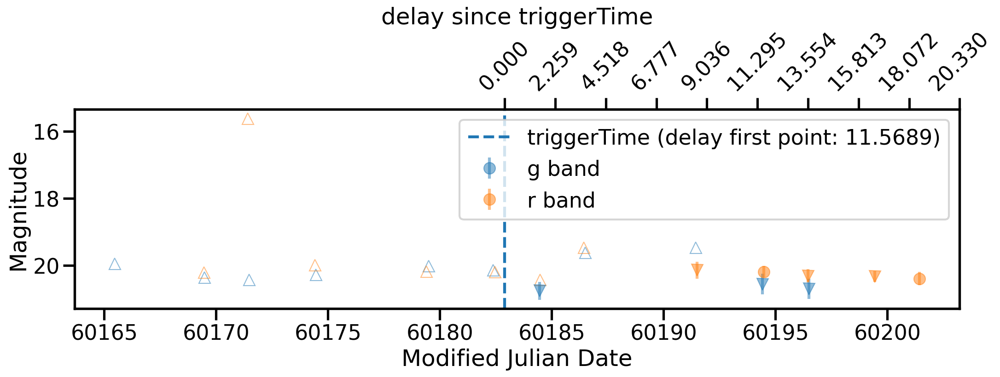

In [81]:
plot_SN_lc("714771169", "initial")

|                | GCN INFO                   |
|:---------------|:---------------------------|
| triggerId      | 718100620                  |
| ackTime        | 2023-10-04 12:32:43.654585 |
| triggerTimeUTC | 2023-10-04 10:23:35.110000 |
| observatory    | Fermi                      |
| instrument     | GBM                        |
| event          |                            |
| gcn_status     | update_1                   |
| gcn_loc_error  | 202.20000000000002         |
nb silver or gold alerts: 0
ZTF23abhyroo


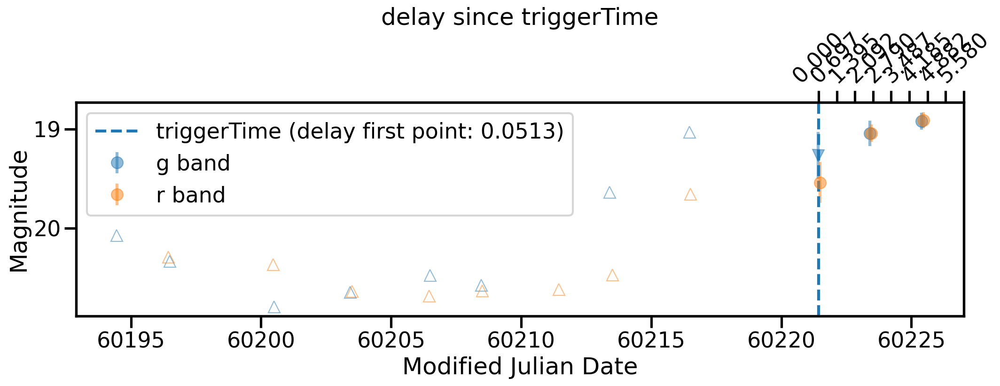

In [83]:
plot_SN_lc("718100620", "update_1")

|                | GCN INFO                   |
|:---------------|:---------------------------|
| triggerId      | 710711405                  |
| ackTime        | 2023-07-10 23:59:23.575529 |
| triggerTimeUTC | 2023-07-10 21:50:00.790000 |
| observatory    | Fermi                      |
| instrument     | GBM                        |
| event          |                            |
| gcn_status     | initial                    |
| gcn_loc_error  | 286.8                      |
nb silver or gold alerts: 0
ZTF23aaufzym


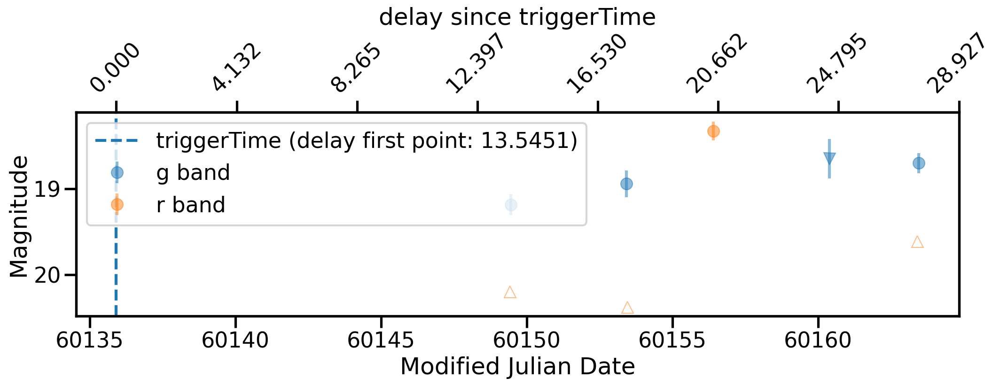

In [85]:
plot_SN_lc("710711405", "initial")

# Look at the ambiguous class

In [8]:
amb_pdf = no_filter_pdf[no_filter_pdf["fink_class"] == "Ambiguous"].sort_values("gcn_loc_error")
amb_bronze_pdf = bronze_pdf[bronze_pdf["fink_class"] == "Ambiguous"].sort_values("gcn_loc_error")

In [10]:
amb_pdf[["triggerId", "observatory", "instrument", "gcn_loc_error", "objectId"]]

,triggerId,observatory,instrument,gcn_loc_error,objectId
433705,709410255,Fermi,GBM,207.000,ZTF23aaqqqhe
74823,712243612,Fermi,GBM,496.800,ZTF23aavmehh
533328,715454583,Fermi,GBM,997.800,ZTF23abflghg
74855,711248946,Fermi,GBM,1027.002,ZTF23aavmehh
376793,711248946,Fermi,GBM,1027.002,ZTF23aauyyxk
...,...,...,...,...,...
165553,710291672,Fermi,GBM,3000.000,ZTF23aatqlve
149379,710291672,Fermi,GBM,3000.000,ZTF23aatytda
144504,710291672,Fermi,GBM,3000.000,ZTF23aaumhir
119949,711293230,Fermi,GBM,3000.000,ZTF23aasolbd


In [14]:
amb_bronze_pdf[amb_bronze_pdf["gcn_loc_error"] < 600][[
    "triggerId", 
    "observatory", 
    "instrument", 
    "gcn_loc_error", 
    "objectId"
]]

,triggerId,observatory,instrument,gcn_loc_error,objectId
564085,709410255,Fermi,GBM,207.0,ZTF23aaqkmpe
523397,709410255,Fermi,GBM,207.0,ZTF23aasbmoa
478853,711805358,Fermi,GBM,215.4,ZTF23aauvhrs
33007,712243612,Fermi,GBM,496.8,ZTF23aavmdsc
171819,712243612,Fermi,GBM,496.8,ZTF23aavmdiy


## Look at neutrino match

In [38]:
icecube = online_pdf[online_pdf["observatory"] == "ICECUBE"]

In [39]:
icecube["fink_class"].value_counts()

Unknown                   140
Solar System candidate    133
SN candidate                8
Name: fink_class, dtype: int64

In [82]:
sn_icecube = icecube[icecube["fink_class"] == "SN candidate"]
uniq_objid = sn_icecube.drop_duplicates(["triggerId", "objectId"])
uniq_trid = uniq_objid.drop_duplicates(["triggerId", "gcn_status"])

13806972184188   initial   ZTF23aawyvap


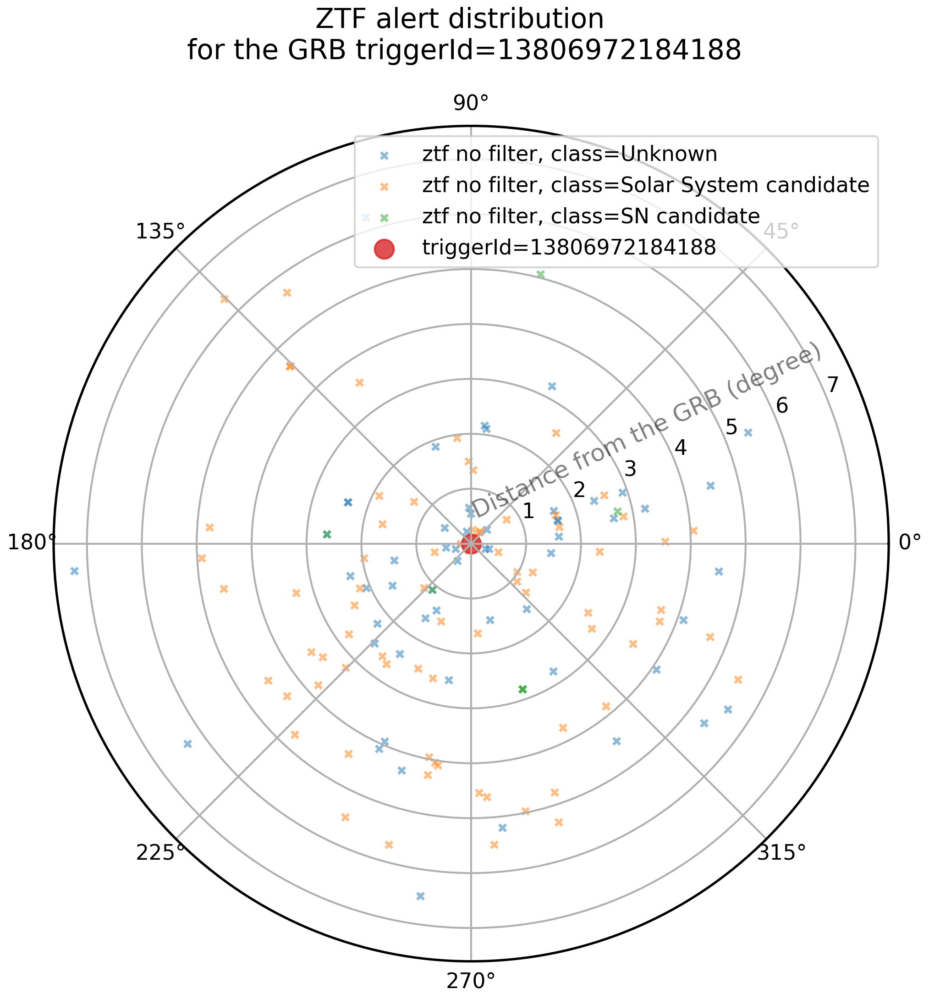

ZTF23aaqmiqx
distance to the gcn: 2.6046934385846945 deg


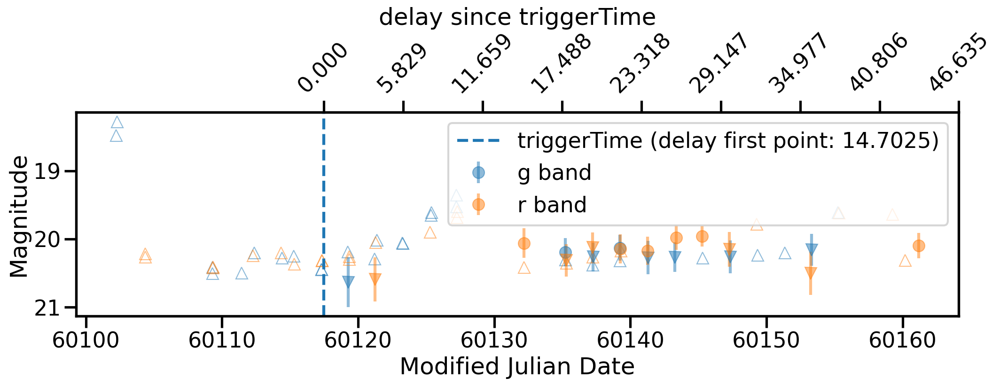

ZTF23aaqmimr
distance to the gcn: 3.1236269187961043 deg


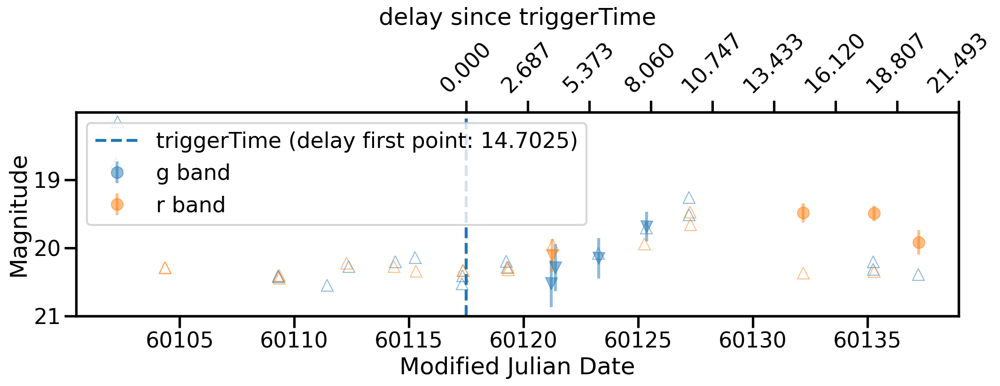

ZTF23aaqxcbb
distance to the gcn: 7.612459201153908 deg


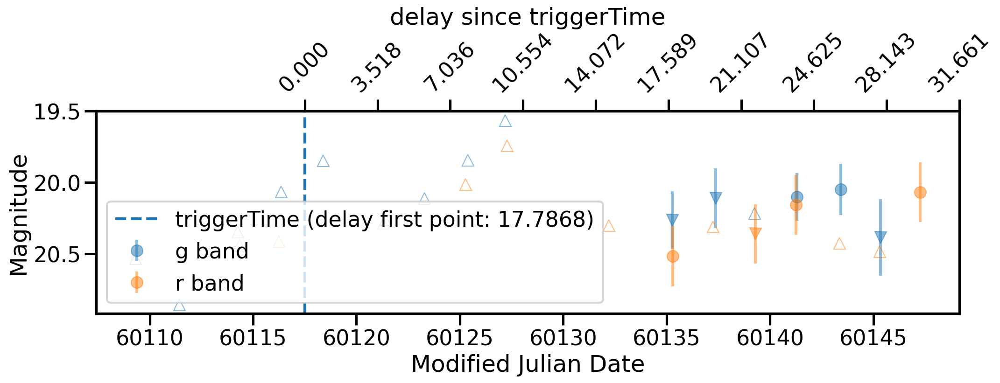

ZTF23aaqbnwl
distance to the gcn: 5.193593597265796 deg


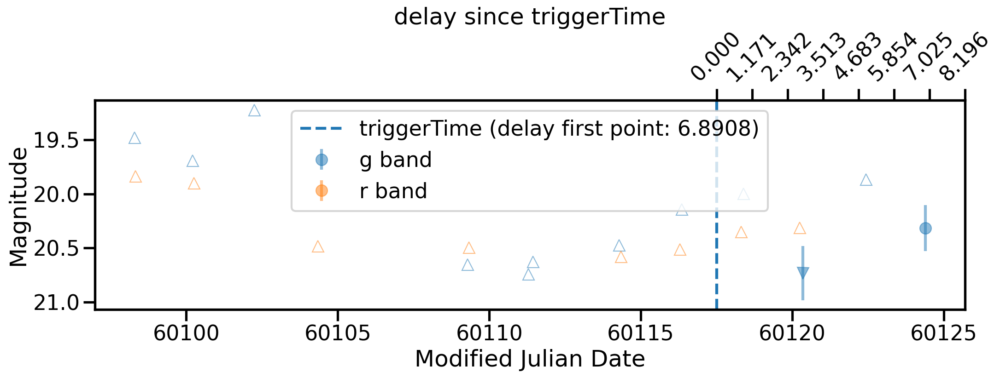

ZTF23aapxaws
distance to the gcn: 4.291220093853674 deg


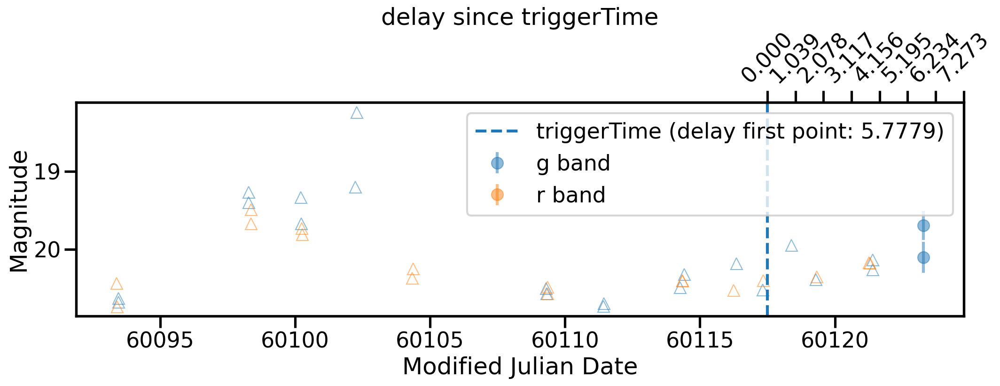

----------------------------------------------




13819321103478   initial   ZTF23aapxaws


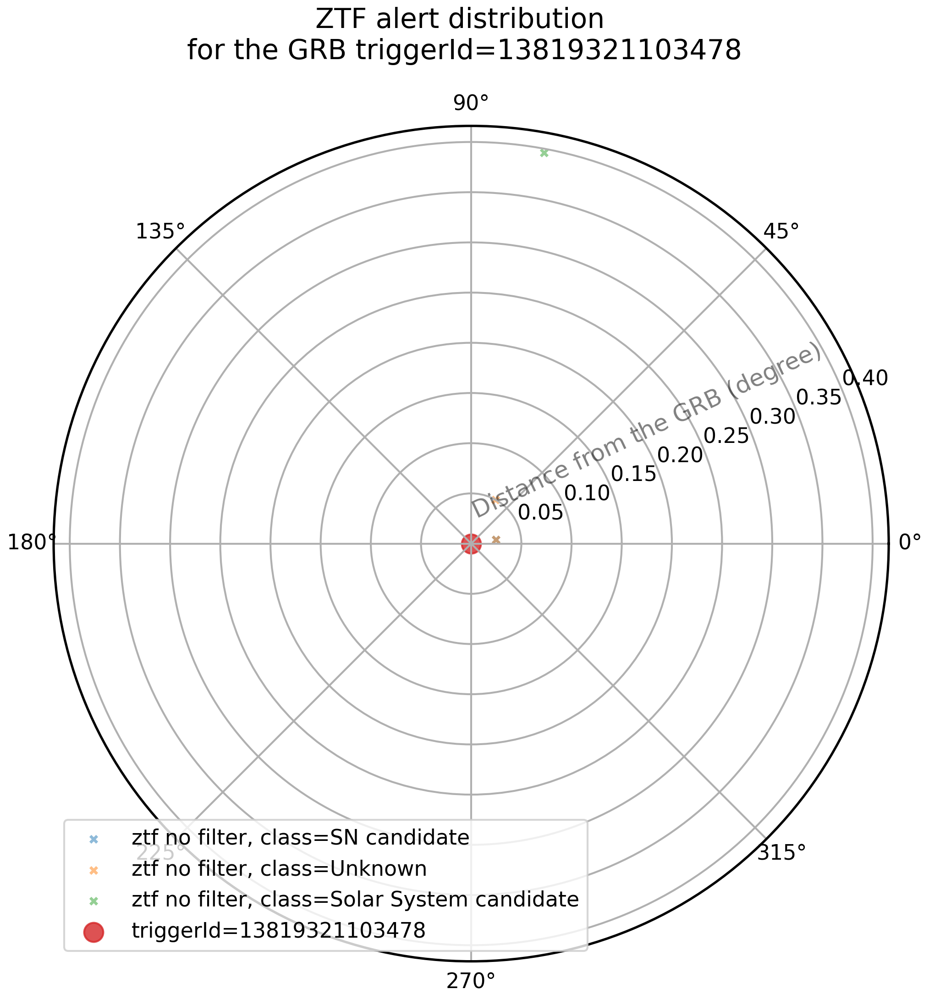

ZTF23aawyvap
distance to the gcn: 0.1549093253859302 deg


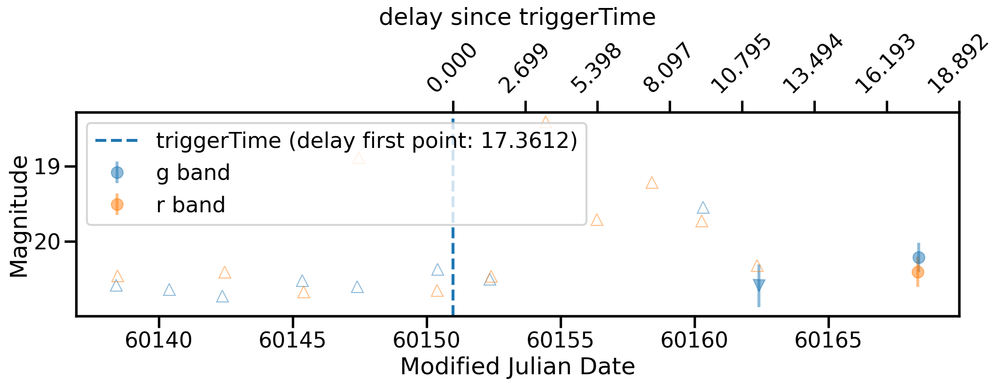

----------------------------------------------






In [83]:
for trId, status in zip(uniq_trid["triggerId"], uniq_trid["gcn_status"]):
    print(trId, " ", status, " ", objId)
    gcn = data_join.get_gcn_join(trId, status)
    gcn_ra, gcn_dec = gcn.gcn_pdf["gcn_ra"].values[0], gcn.gcn_pdf["gcn_dec"].values[0]
    gcn.plot_alert_distribution()
    gcn_sn = gcn.gcn_pdf[gcn.gcn_pdf["fink_class"] == "SN candidate"]
    for objId in gcn_sn["objectId"].unique():
        print(objId)
        ztf = gcn.get_ztf_obj(objId)
        ztf_ra, ztf_dec = ztf.ztf_pdf["ztf_ra"].values[0], ztf.ztf_pdf["ztf_dec"].values[0]
        dist = SkyCoord(ztf_ra, ztf_dec, unit="deg").separation(
            SkyCoord(gcn_ra, gcn_dec, unit="deg")
        )
        print(f"distance to the gcn: {dist}")
        ztf.plot_lighcurve()
    print("----------------------------------------------")
    print("\n")
    print("\n")

#### the most points

In [73]:
icecube.groupby(["triggerId", "gcn_status", "objectId"]).count().sort_values("observatory")

observatory  instrument  event  \
triggerId      gcn_status objectId                                       
13806972184188 initial    ZTF23aaphvnx            1           1      1   
13812511333473 initial    ZTF23aatccsw            1           1      1   
                          ZTF23aatcdbb            1           1      1   
                          ZTF23aatcfal            1           1      1   
                          ZTF23aatojku            1           1      1   
...                                             ...         ...    ...   
13819321103478 initial    ZTF23aawyvap            2           2      2   
13818166037171 initial    ZTF23aavechc            2           2      2   
13806972184188 initial    ZTF23aaqmiqx            2           2      2   
                          ZTF23aapxaws            2           2      2   
                          ZTF23aaqmimr            3           3      3   

                                        gcn_ra  gcn_dec  gcn_loc_error  \
triggerId      gcn_status objectId                                       
13806972184188 initial    ZTF23aaphvnx       1        1              1   
13812511333473 initial    ZTF23aatccsw       1        1              1   
                          ZTF23aatcdbb       1        1              1   
                          ZTF23aatcfal       1        1              1   
                          ZTF23aatojku       1        1              1   
...                                        ...      ...            ...   
13819321103478 initial    ZTF23aawyvap       2        2              2   
13818166037171 initial    ZTF23aavechc       2        2              2   
13806972184188 initial    ZTF23aaqmiqx       2        2              2   
                          ZTF23aapxaws       2        2              2   
                          ZTF23aaqmimr       3        3              3   

                                        ackTime  triggerTimeUTC  cdsxmatch  \
triggerId      gcn_status objectId                                           
13806972184188 initial    ZTF23aaphvnx        1               1          1   
13812511333473 initial    ZTF23aatccsw        1               1          1   
                          ZTF23aatcdbb        1               1          1   
                          ZTF23aatcfal        1               1          1   
                          ZTF23aatojku        1               1          1   
...                                         ...             ...        ...   
13819321103478 initial    ZTF23aawyvap        2               2          2   
13818166037171 initial    ZTF23aavechc        2               2          2   
13806972184188 initial    ZTF23aaqmiqx        2               2          2   
                          ZTF23aapxaws        2               2          2   
                          ZTF23aaqmimr        3               3          3   

                                        DR3Name  ...  is_gw_bronze  year  \
triggerId      gcn_status objectId               ...                       
13806972184188 initial    ZTF23aaphvnx        1  ...             1     1   
13812511333473 initial    ZTF23aatccsw        1  ...             1     1   
                          ZTF23aatcdbb        1  ...             1     1   
                          ZTF23aatcfal        1  ...             1     1   
                          ZTF23aatojku        1  ...             1     1   
...                                         ...  ...           ...   ...   
13819321103478 initial    ZTF23aawyvap        2  ...             2     2   
13818166037171 initial    ZTF23aavechc        2  ...             2     2   
13806972184188 initial    ZTF23aaqmiqx        2  ...             2     2   
                          ZTF23aapxaws        2  ...             2     2   
                          ZTF23aaqmimr        3  ...             3     3   

                                        month  day  triggerTimejd  ackTimejd  \
triggerId      gcn_status obje

## Look more into details on swift gcn

In [99]:
swift = online_pdf[online_pdf["observatory"] == "SWIFT"]

In [100]:
swift["fink_class"].value_counts()

Unknown                   113
Solar System candidate     26
SN candidate                2
Name: fink_class, dtype: int64

In [101]:
sn_swift = swift[swift["fink_class"] == "SN candidate"]
uniq_objid_swift = sn_swift.drop_duplicates(["triggerId", "objectId"])
uniq_trid_swift = uniq_objid_swift.drop_duplicates(["triggerId", "gcn_status"])

1187463   initial   ZTF23abbkyty


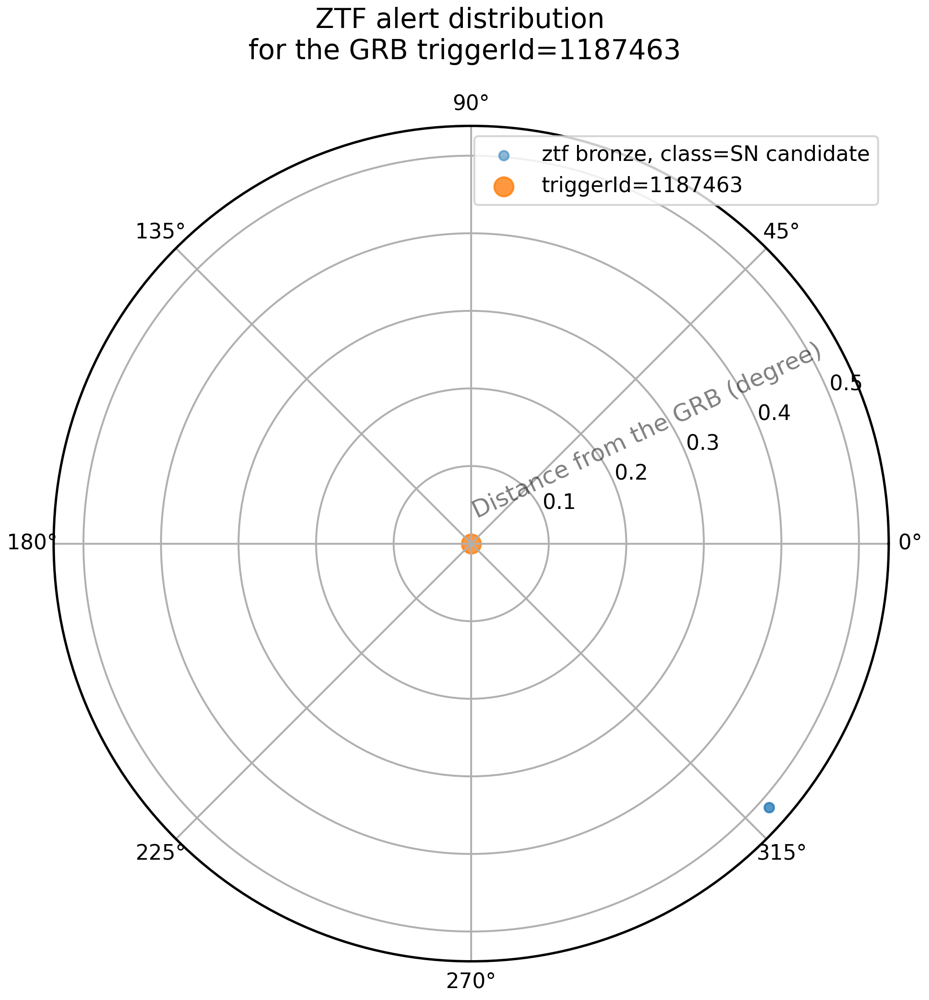

ZTF23abbkyty
distance to the gcn: 0.8939633603879775 deg


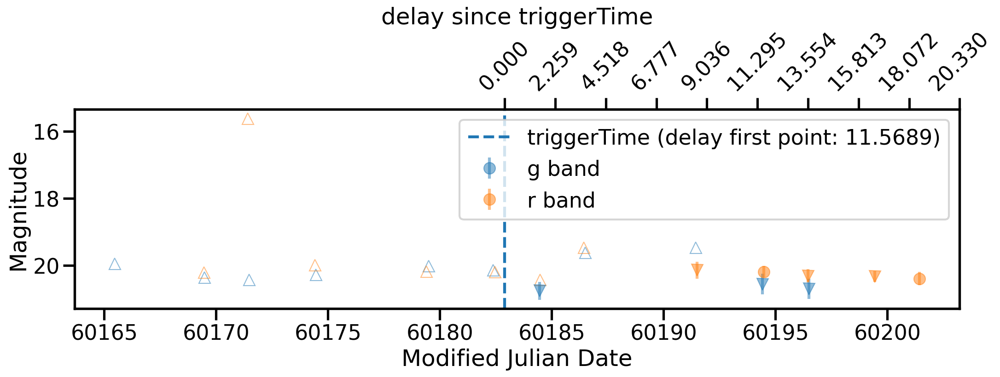

----------------------------------------------






In [102]:
for trId, status in zip(uniq_trid_swift["triggerId"], uniq_trid_swift["gcn_status"]):
    print(trId, " ", status, " ", objId)
    gcn = data_join.get_gcn_join(trId, status)
    gcn_ra, gcn_dec = gcn.gcn_pdf["gcn_ra"].values[0], gcn.gcn_pdf["gcn_dec"].values[0]
    gcn.plot_alert_distribution()
    gcn_sn = gcn.gcn_pdf[gcn.gcn_pdf["fink_class"] == "SN candidate"]
    for objId in gcn_sn["objectId"].unique():
        print(objId)
        ztf = gcn.get_ztf_obj(objId)
        ztf_ra, ztf_dec = ztf.ztf_pdf["ztf_ra"].values[0], ztf.ztf_pdf["ztf_dec"].values[0]
        dist = SkyCoord(ztf_ra, ztf_dec, unit="deg").separation(
            SkyCoord(gcn_ra, gcn_dec, unit="deg")
        )
        print(f"distance to the gcn: {dist}")
        ztf.plot_lighcurve()
    print("----------------------------------------------")
    print("\n")
    print("\n")

## Look more into details on fermi gcn

In [5]:
fermi = online_pdf[online_pdf["observatory"] == "Fermi"]

In [6]:
fermi_prec = fermi[fermi["gcn_loc_error"] < 500]

In [7]:
fermi_prec["fink_class"].value_counts()

Unknown                   3714
Solar System candidate    2489
SN candidate               150
Early SN Ia candidate       13
Ambiguous                    8
Kilonova candidate           2
Name: fink_class, dtype: int64

In [8]:
count_fermi = (fermi_prec
               .groupby(["triggerId", "gcn_status", "objectId"])
               .agg(
                   nb_obs=("observatory", "count"),
                   class_=("fink_class", list)
               )
               .sort_values("nb_obs")
               .reset_index()
              )

In [9]:
count_fermi[count_fermi["nb_obs"] > 1]

,triggerId,gcn_status,objectId,nb_obs,class_
6067,712243612,initial,ZTF23aavmnjb,2,"[Unknown, Unknown]"
6068,709410255,initial,ZTF23aaqkhye,2,"[Solar System candidate, Solar System candidate]"
6069,710120768,initial,ZTF23aarzjdz,2,"[Solar System candidate, Unknown]"
6070,714809315,initial,ZTF23abaanxz,2,"[Unknown, Unknown]"
6071,717348234,update_0,ZTF23abhvpvp,2,"[Unknown, SN candidate]"
...,...,...,...,...,...
6170,713966581,initial,ZTF23ababkmo,7,"[Unknown, SN candidate, SN candidate, Unknown,..."
6171,709410255,initial,ZTF23aaptbvm,7,"[SN candidate, SN candidate, SN candidate, SN ..."
6172,716007606,initial,ZTF23abcneqm,8,"[Unknown, Early SN Ia candidate, SN candidate,..."
6173,716284577,initial,ZTF23abejxgc,10,"[SN candidate, SN candidate, Early SN Ia candi..."


In [10]:
count_fermi["mask_class"] = (count_fermi["class_"]
                             .apply(
                                 lambda x: "SN candidate" in list(x) or (np.array(x) == "Unknown").all()))

In [28]:
count_fermi_mask = count_fermi[count_fermi["mask_class"] & (count_fermi["nb_obs"] > 1)]

In [29]:
count_fermi_mask

,triggerId,gcn_status,objectId,nb_obs,class_,mask_class
6067,712243612,initial,ZTF23aavmnjb,2,"[Unknown, Unknown]",True
6070,714809315,initial,ZTF23abaanxz,2,"[Unknown, Unknown]",True
6071,717348234,update_0,ZTF23abhvpvp,2,"[Unknown, SN candidate]",True
6072,712912581,initial,ZTF23aaxzhor,2,"[Unknown, SN candidate]",True
6075,717348234,update_0,ZTF23abhvpvq,2,"[Unknown, SN candidate]",True
...,...,...,...,...,...,...
6170,713966581,initial,ZTF23ababkmo,7,"[Unknown, SN candidate, SN candidate, Unknown,...",True
6171,709410255,initial,ZTF23aaptbvm,7,"[SN candidate, SN candidate, SN candidate, SN ...",True
6172,716007606,initial,ZTF23abcneqm,8,"[Unknown, Early SN Ia candidate, SN candidate,...",True
6173,716284577,initial,ZTF23abejxgc,10,"[SN candidate, SN candidate, Early SN Ia candi...",True


In [30]:
uniq_objid_fermi = count_fermi_mask.drop_duplicates(["triggerId", "objectId"])
uniq_trid_fermi = uniq_objid_fermi.drop_duplicates(["triggerId", "gcn_status"])

712243612   initial
+-----------+----------------------------+-------------+------------+-------+--------------------+------------+
| triggerId |       triggerTimeUTC       | observatory | instrument | event |   gcn_loc_error    | gcn_status |
+-----------+----------------------------+-------------+------------+-------+--------------------+------------+
| 712243612 | 2023-07-28 15:26:47.250000 |    Fermi    |    GBM     |       | 496.79999999999995 |  initial   |
+-----------+----------------------------+-------------+------------+-------+--------------------+------------+


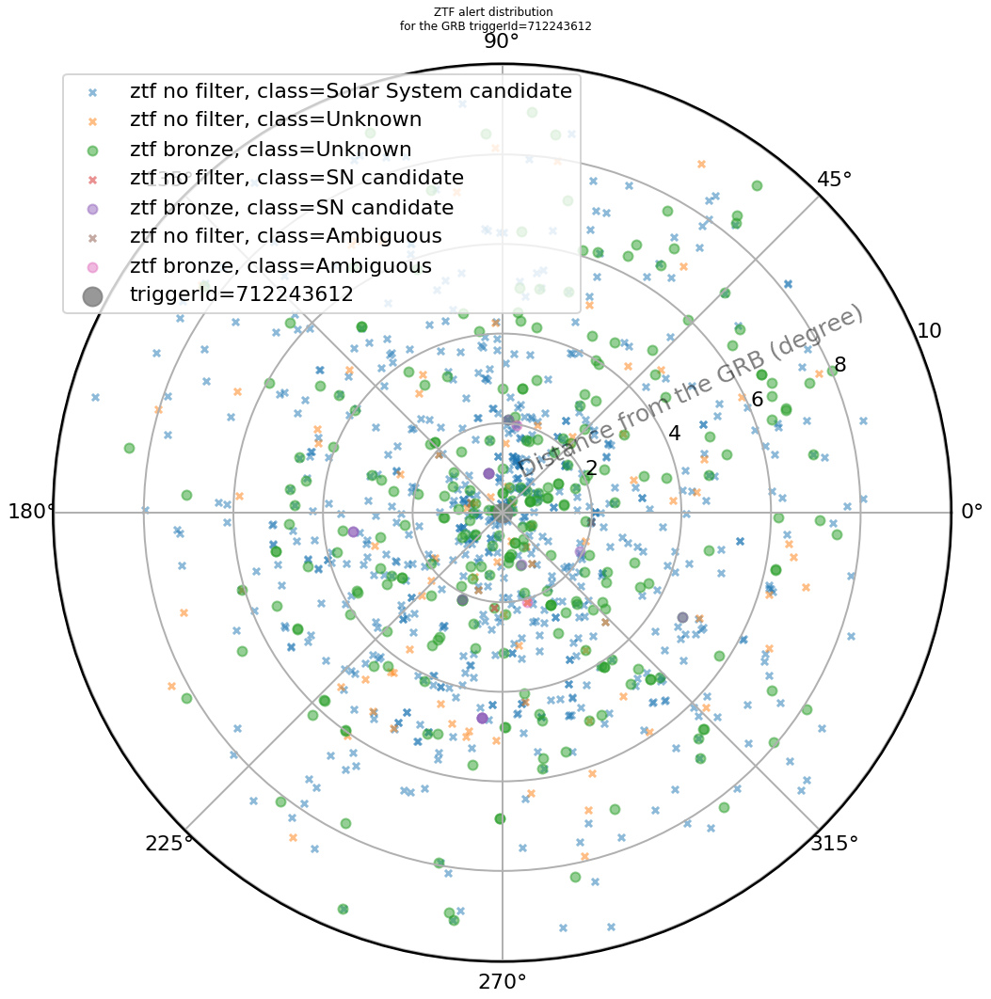

nb objId = 13
ZTF23aavmnjb
['Unknown']
distance to the gcn: 4.80774413965404 deg


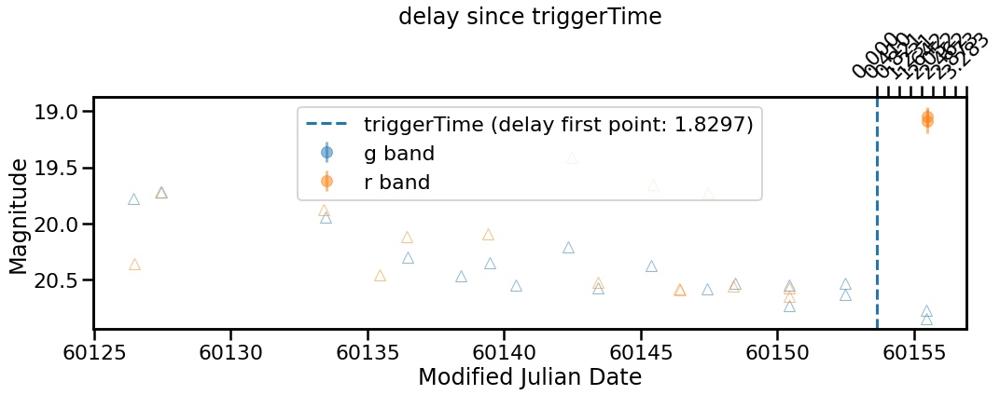

ZTF23aavqqhe
['Unknown']
distance to the gcn: 5.66073404811765 deg


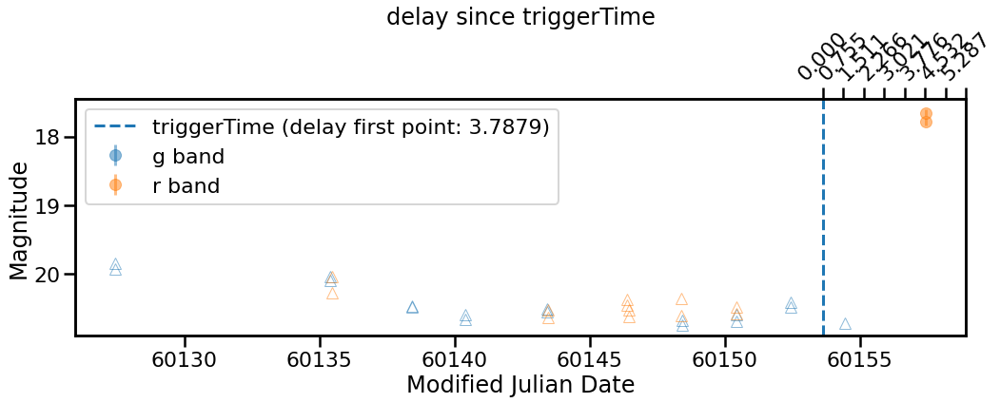

ZTF23aavqrcb
['SN candidate' 'Unknown']
distance to the gcn: 4.669810477511663 deg


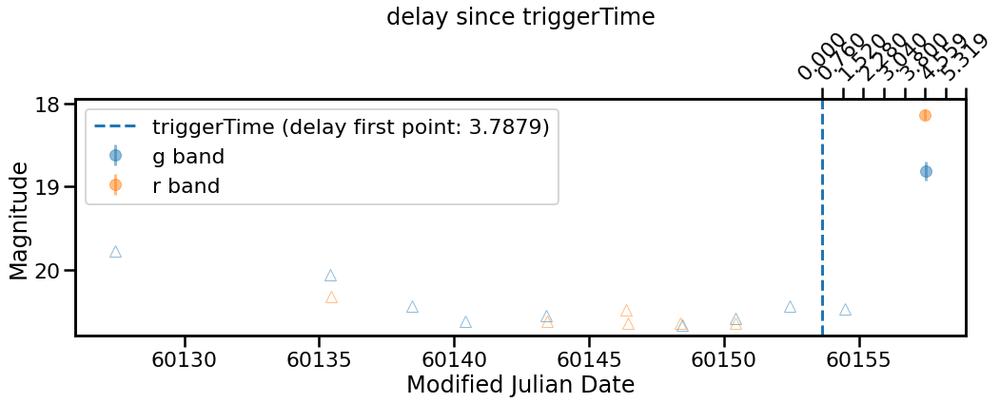

ZTF23aaxafxd
['SN candidate']
distance to the gcn: 4.70573574719934 deg


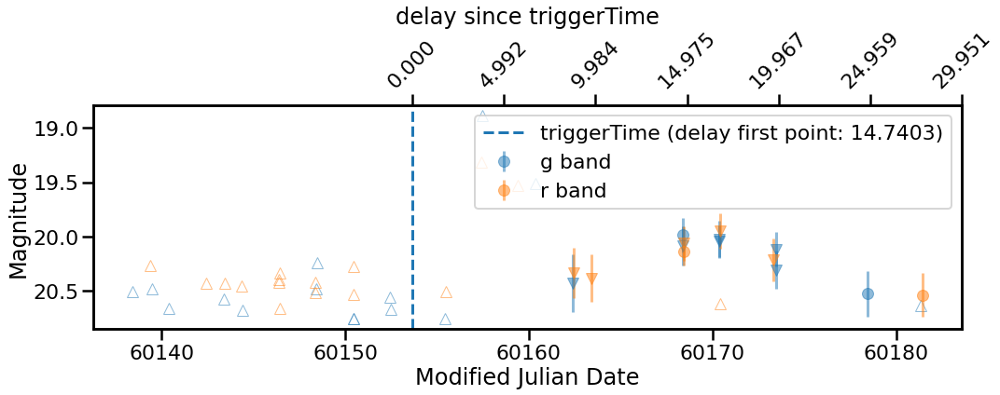

ZTF23aawknar
['Unknown']
distance to the gcn: 7.014306491883038 deg


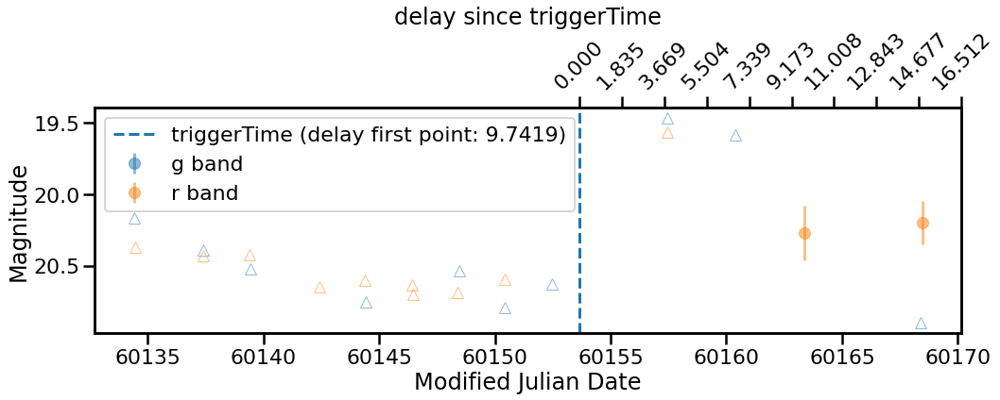

ZTF23aavptwi
['Unknown']
distance to the gcn: 4.531276472156394 deg


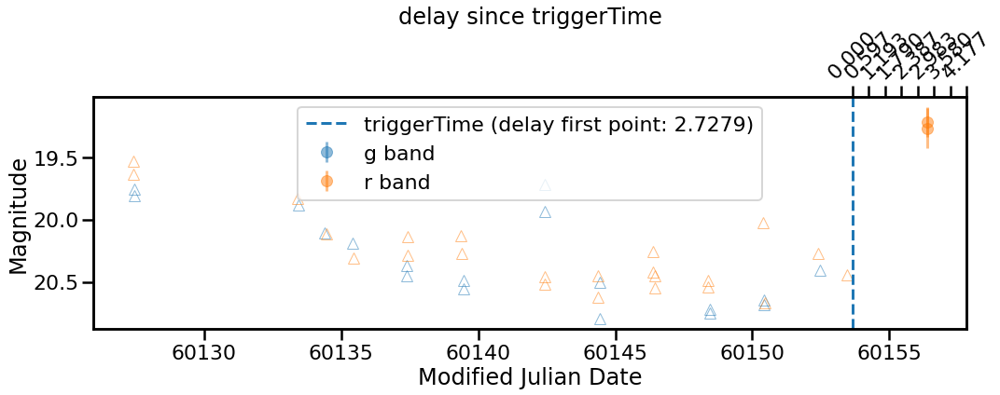

ZTF23aavmdsu
['Unknown']
distance to the gcn: 6.690409972106053 deg


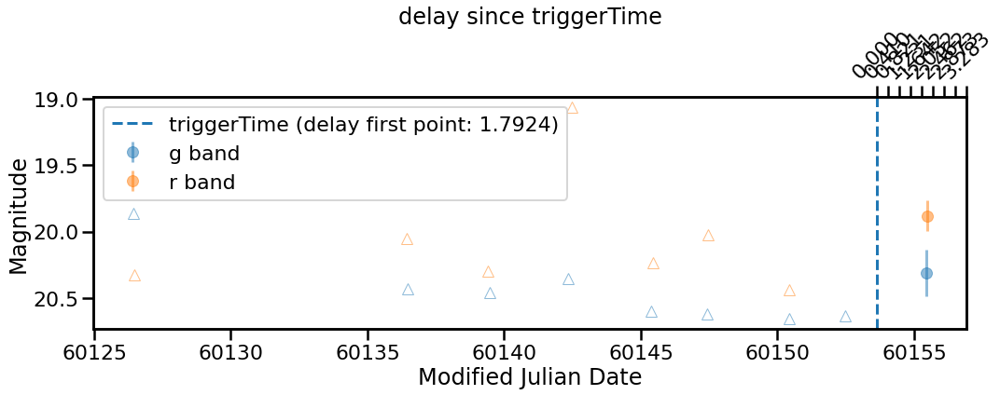

ZTF23aavmdsg
['Unknown' 'SN candidate']
distance to the gcn: 9.604751061530004 deg


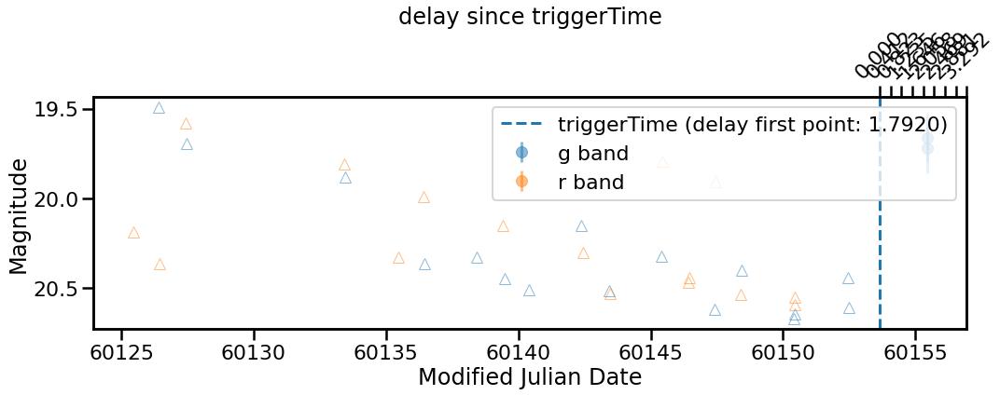

ZTF23aavmmvx
['Unknown']
distance to the gcn: 6.908653282289301 deg


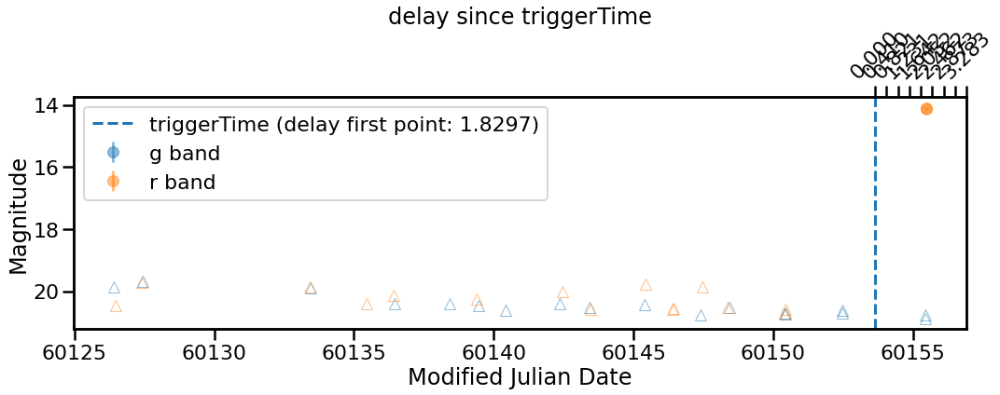

ZTF23aavmbjf
['SN candidate' 'Unknown']
distance to the gcn: 4.804060698848154 deg


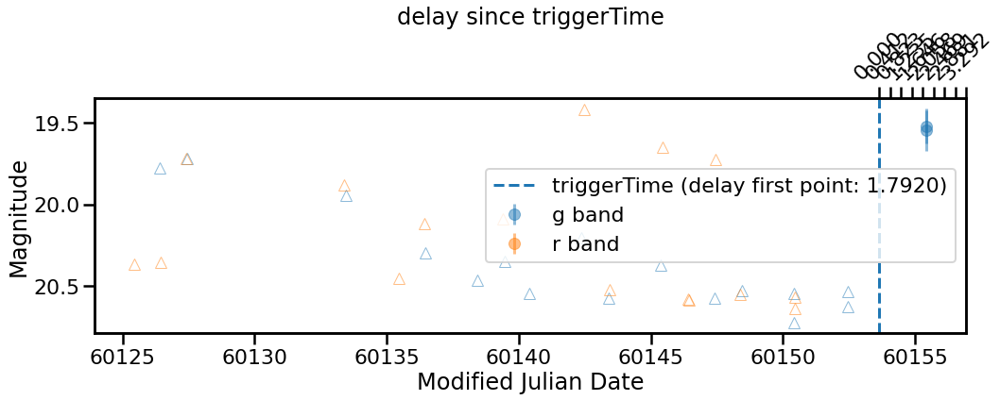

ZTF23aavmbji
['Unknown' 'SN candidate']
distance to the gcn: 5.120594763658811 deg


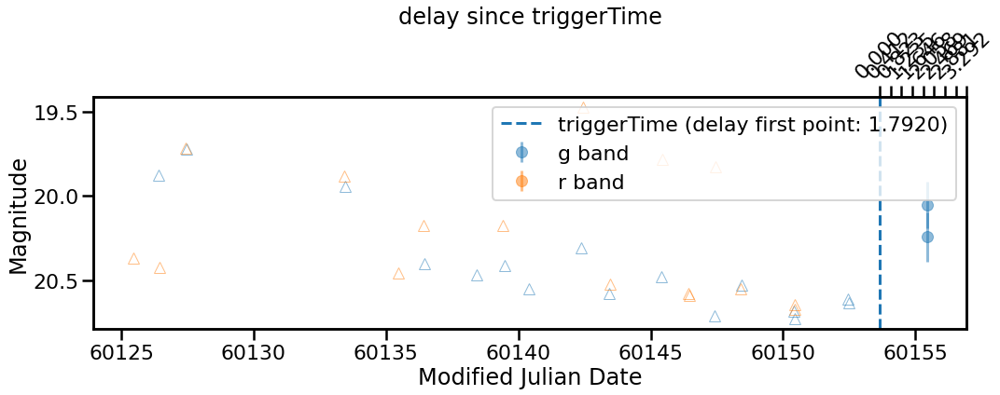

ZTF23aawkjdx
['SN candidate' 'Unknown']
distance to the gcn: 2.11743223732028 deg


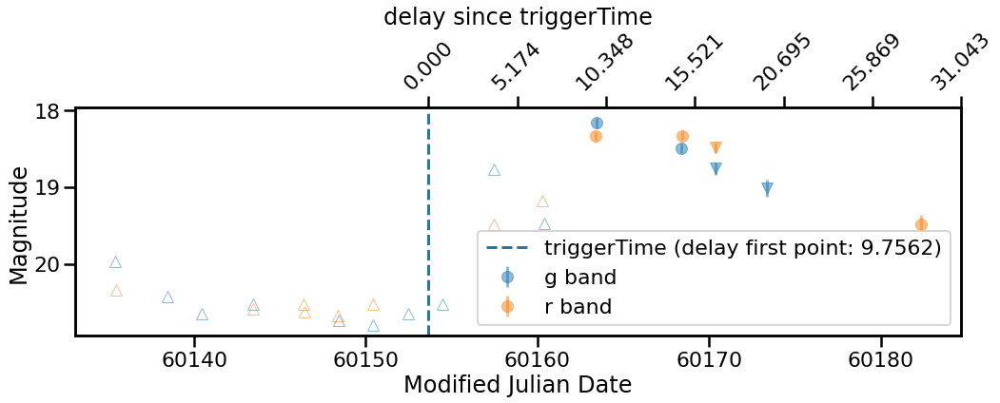

ZTF23aawkpmp
['SN candidate']
distance to the gcn: 9.142563537292732 deg


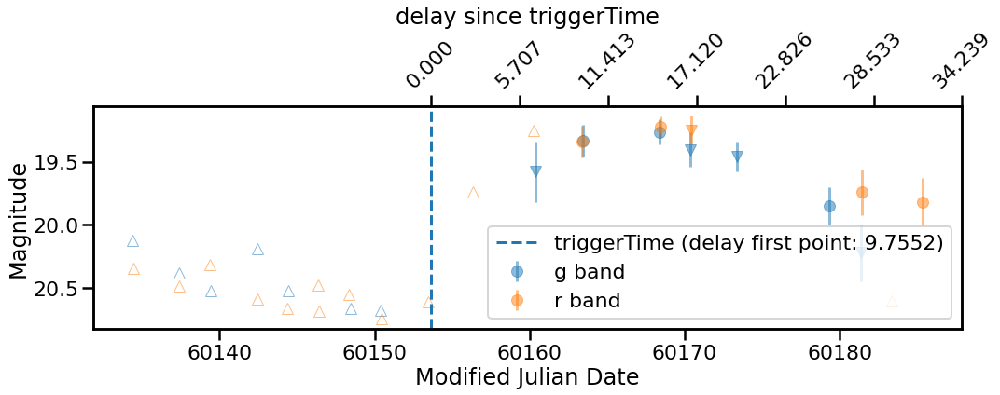

----------------------------------------------




714809315   initial
+-----------+----------------------------+-------------+------------+-------+---------------+------------+
| triggerId |       triggerTimeUTC       | observatory | instrument | event | gcn_loc_error | gcn_status |
+-----------+----------------------------+-------------+------------+-------+---------------+------------+
| 714809315 | 2023-08-27 08:08:30.730000 |    Fermi    |    GBM     |       |     130.2     |  initial   |
+-----------+----------------------------+-------------+------------+-------+---------------+------------+


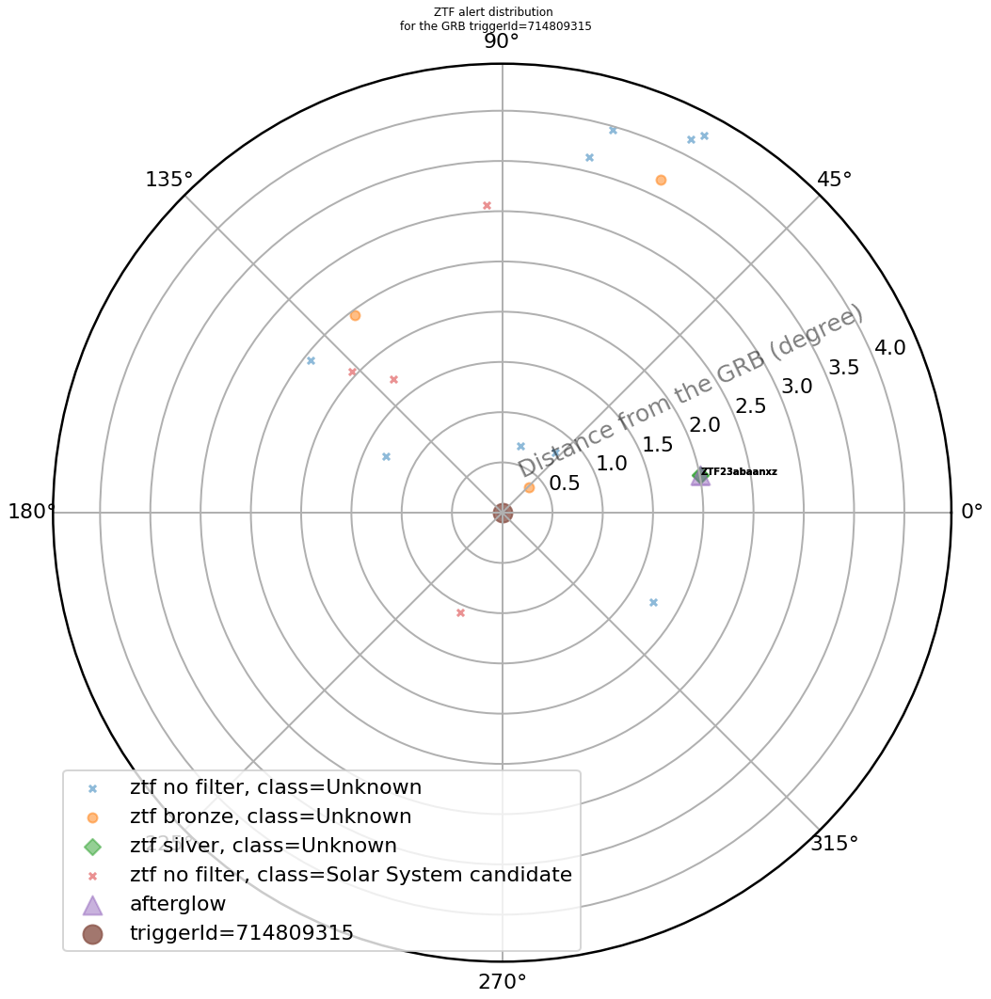

nb objId = 1
ZTF23abaanxz
['Unknown']
distance to the gcn: 2.0148255412626335 deg


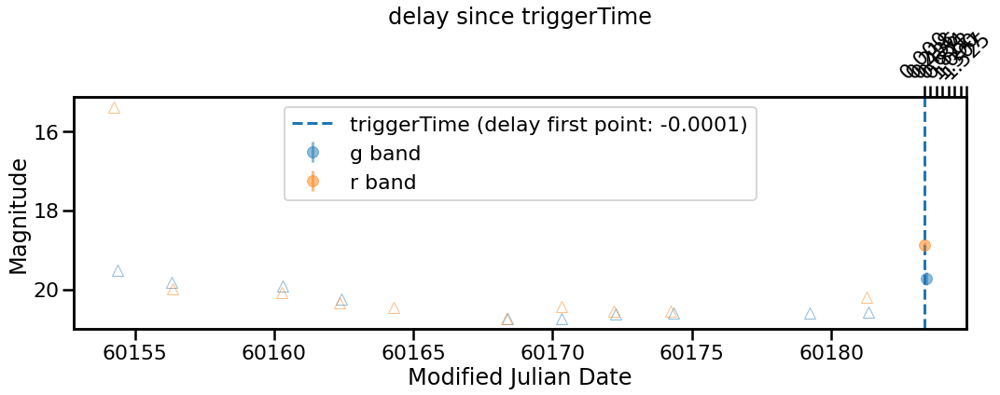

----------------------------------------------




717348234   update_0
+-----------+----------------------------+-------------+------------+-------+---------------+------------+
| triggerId |       triggerTimeUTC       | observatory | instrument | event | gcn_loc_error | gcn_status |
+-----------+----------------------------+-------------+------------+-------+---------------+------------+
| 717348234 | 2023-09-25 17:23:49.930000 |    Fermi    |    GBM     |       |    487.002    |  update_0  |
+-----------+----------------------------+-------------+------------+-------+---------------+------------+


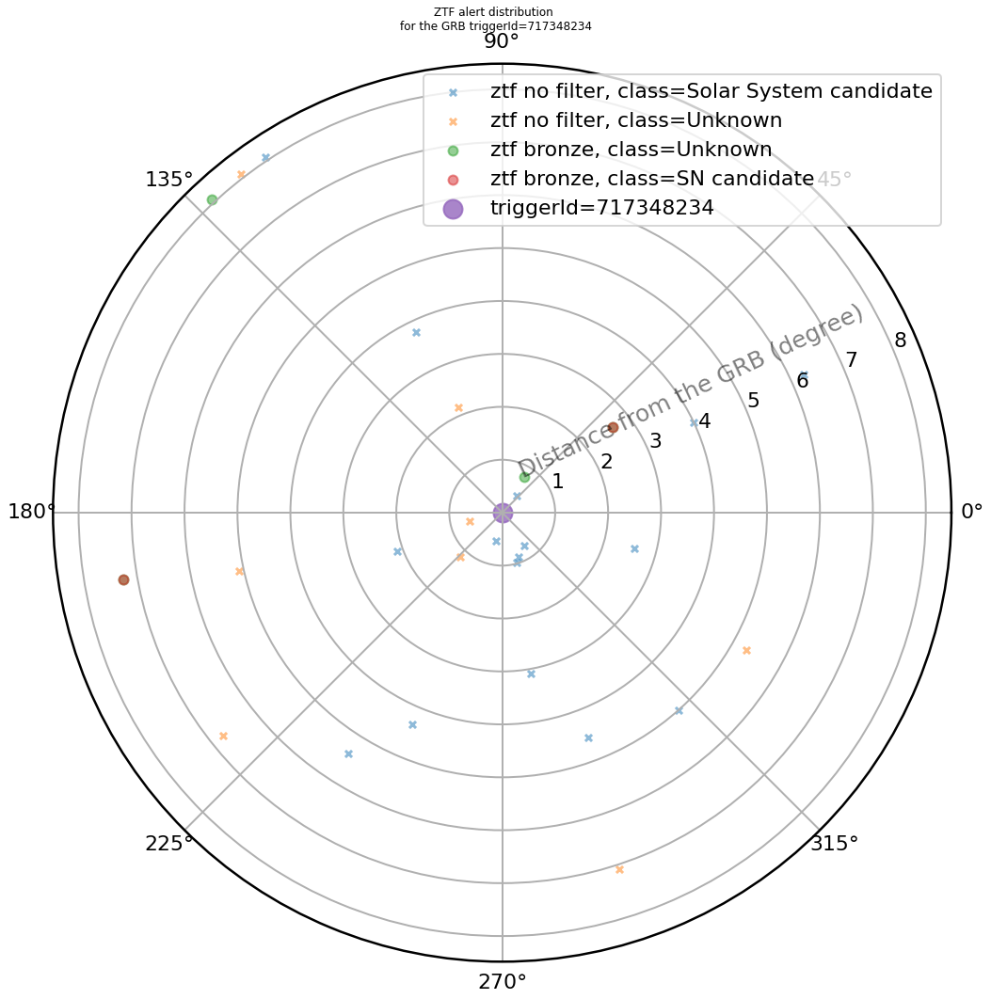

nb objId = 2
ZTF23abhvpvp
['Unknown' 'SN candidate']
distance to the gcn: 5.852036217333197 deg


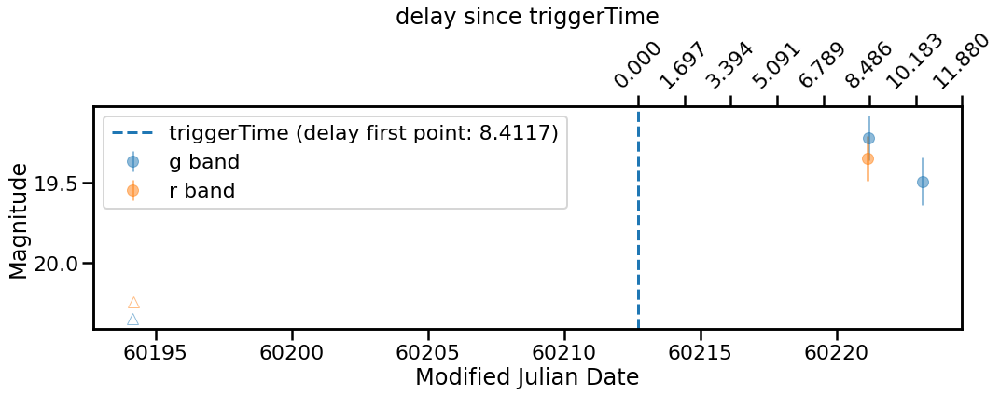

ZTF23abhvpvq
['Unknown' 'SN candidate']
distance to the gcn: 7.677750511920907 deg


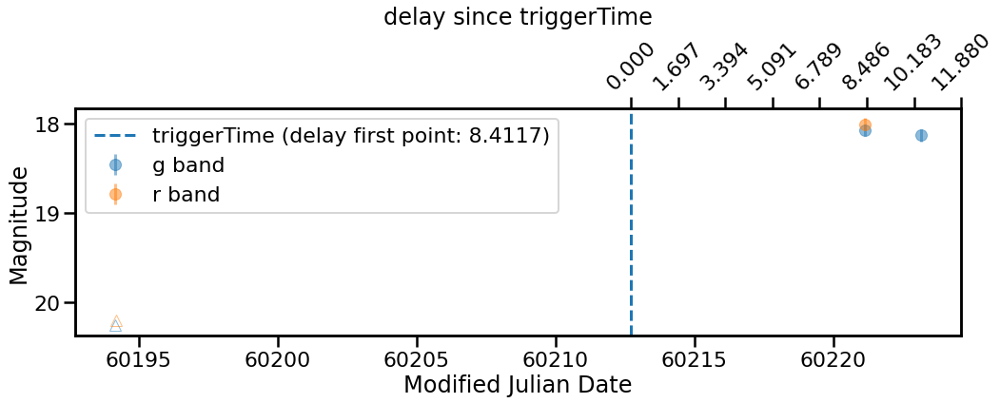

----------------------------------------------




712912581   initial
+-----------+----------------------------+-------------+------------+-------+---------------+------------+
| triggerId |       triggerTimeUTC       | observatory | instrument | event | gcn_loc_error | gcn_status |
+-----------+----------------------------+-------------+------------+-------+---------------+------------+
| 712912581 | 2023-08-05 09:16:16.500000 |    Fermi    |    GBM     |       |     388.2     |  initial   |
+-----------+----------------------------+-------------+------------+-------+---------------+------------+


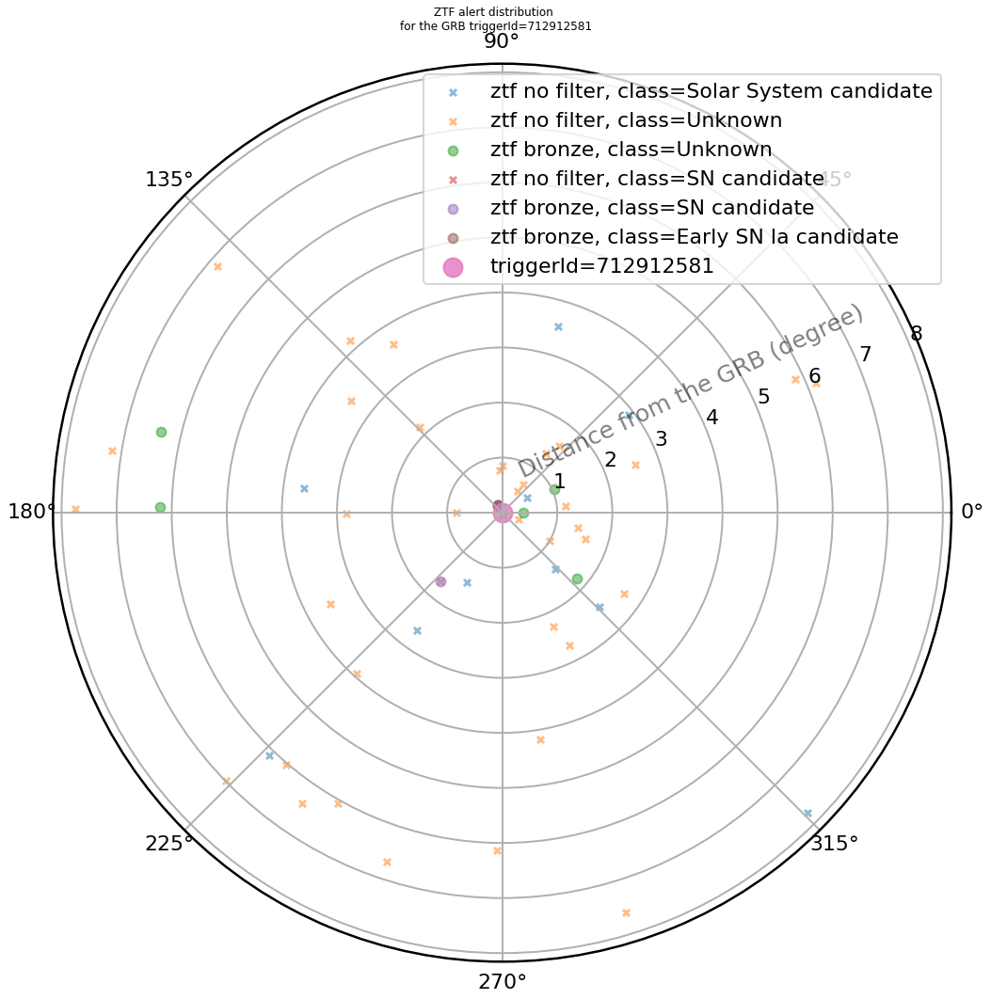

nb objId = 3
ZTF23aaxzhor
['Unknown' 'SN candidate']
distance to the gcn: 1.1410985402400453 deg


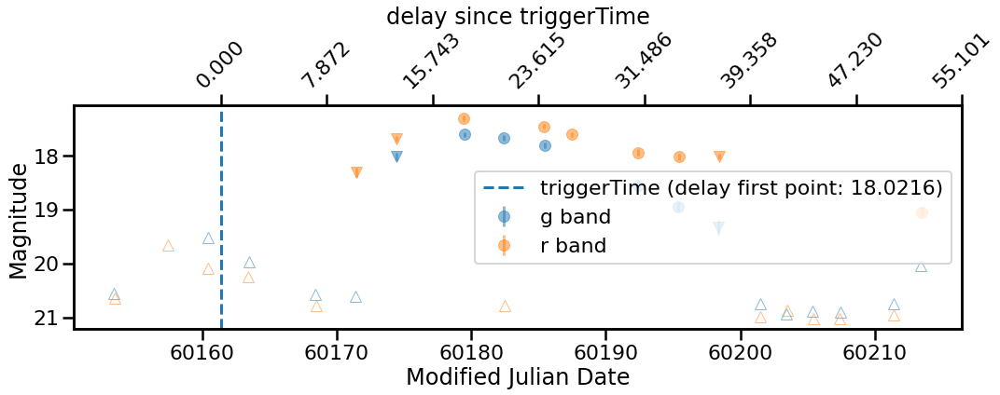

ZTF23aaxcoai
['Unknown' 'SN candidate']
distance to the gcn: 2.8219091790971698 deg


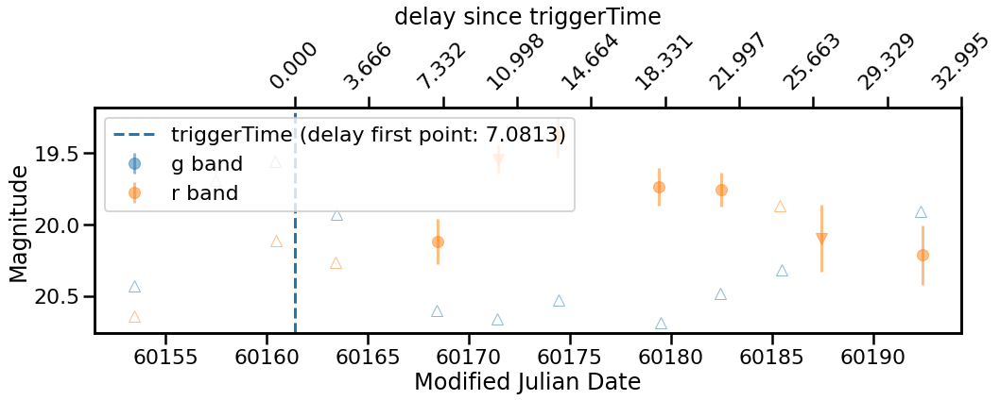

ZTF23aaxboby
['SN candidate' 'Unknown' 'Early SN Ia candidate']
distance to the gcn: 2.0681128104280844 deg


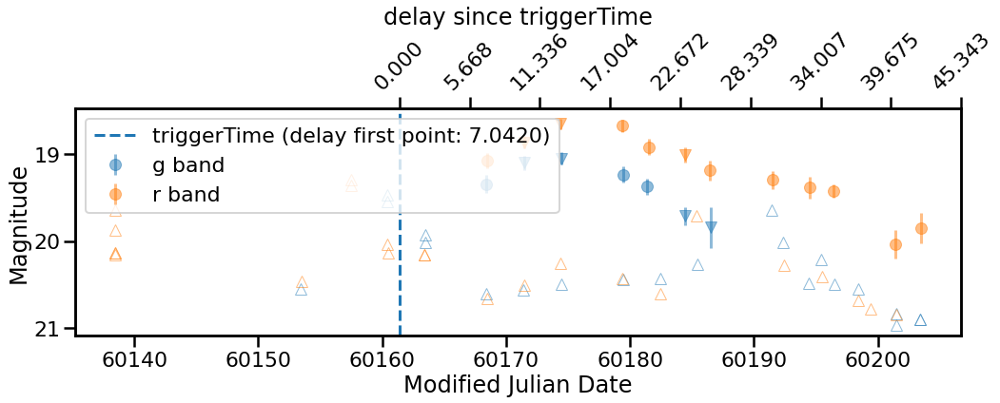

----------------------------------------------




709410255   initial
+-----------+----------------------------+-------------+------------+-------+---------------+------------+
| triggerId |       triggerTimeUTC       | observatory | instrument | event | gcn_loc_error | gcn_status |
+-----------+----------------------------+-------------+------------+-------+---------------+------------+
| 709410255 | 2023-06-25 20:24:10.710000 |    Fermi    |    GBM     |       |     207.0     |  initial   |
+-----------+----------------------------+-------------+------------+-------+---------------+------------+


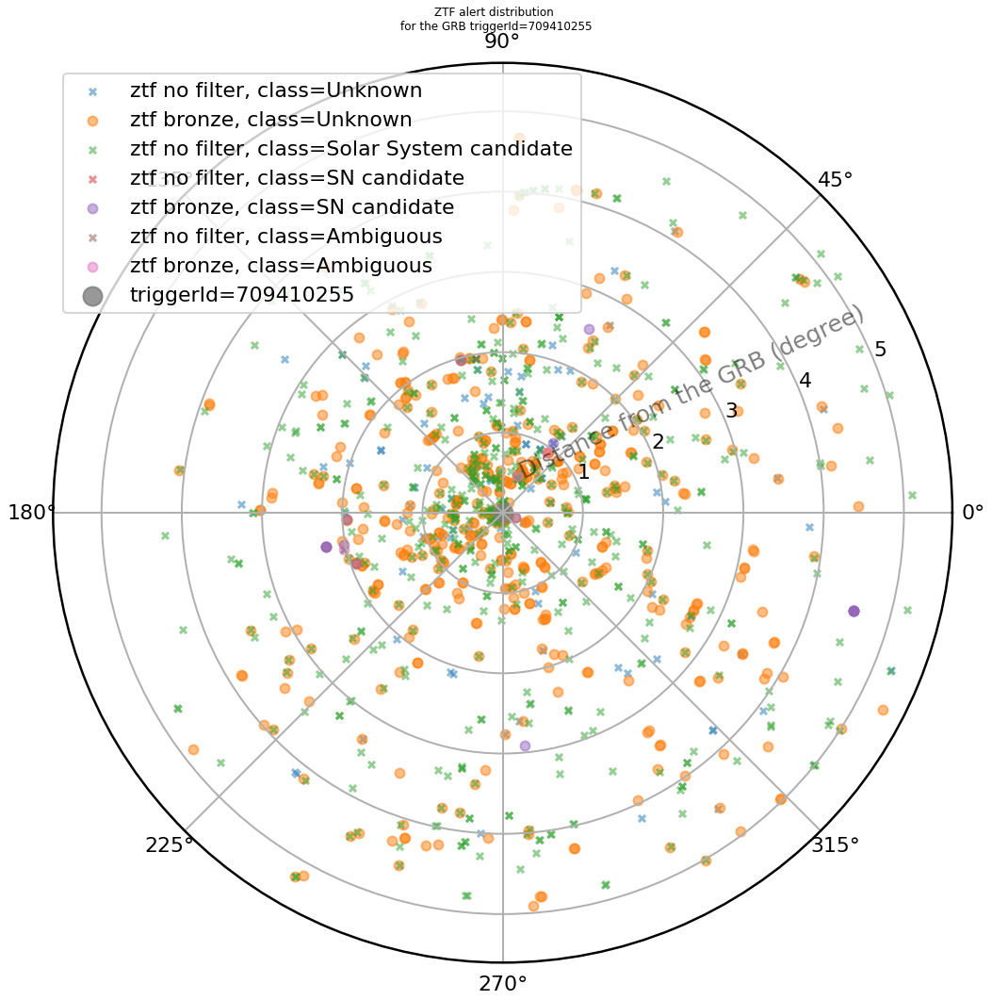

nb objId = 14
ZTF23aasbmog
['SN candidate' 'Unknown']
distance to the gcn: 5.456782507034683 deg


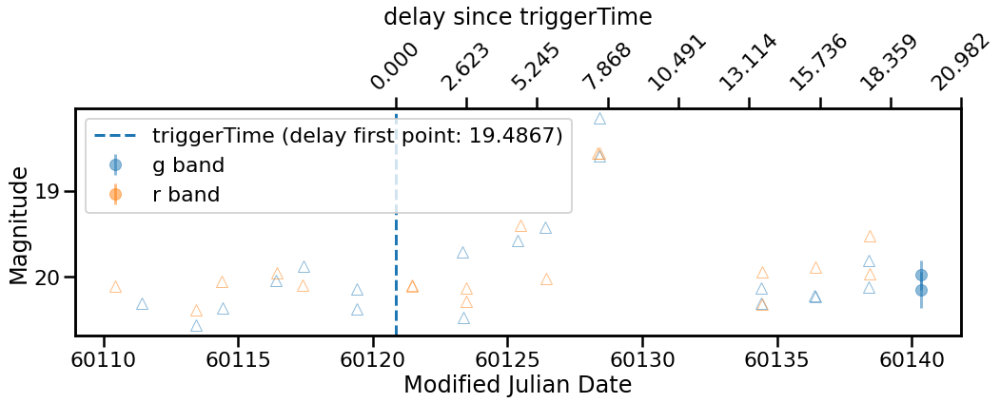

ZTF23aascknn
['SN candidate' 'Unknown']
distance to the gcn: 3.6794199351671537 deg


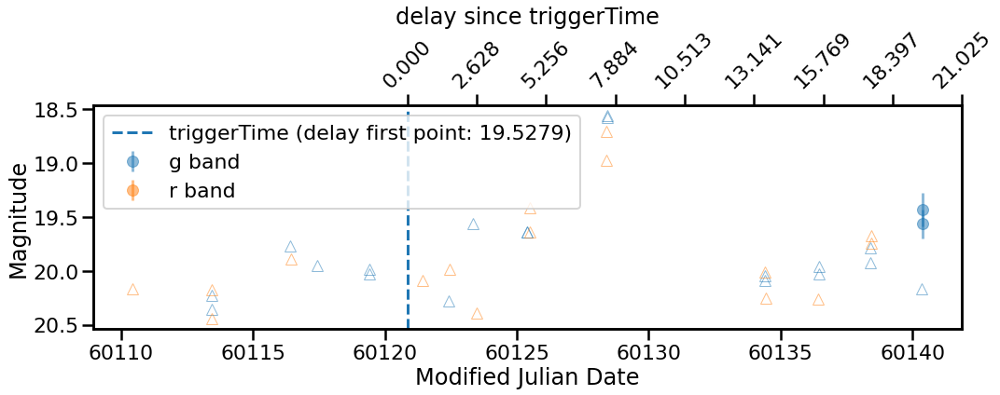

ZTF23aaqunfe
['Unknown']
distance to the gcn: 5.132617142175263 deg


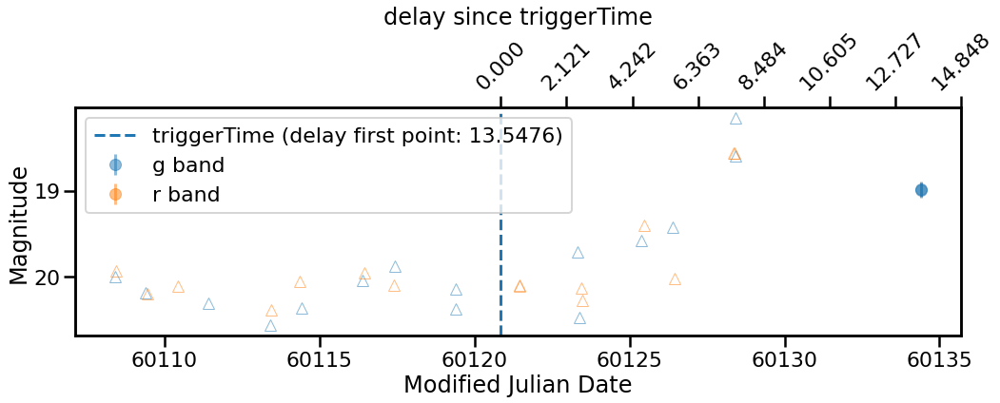

ZTF23aapteoi
['Unknown']
distance to the gcn: 5.147397595224145 deg


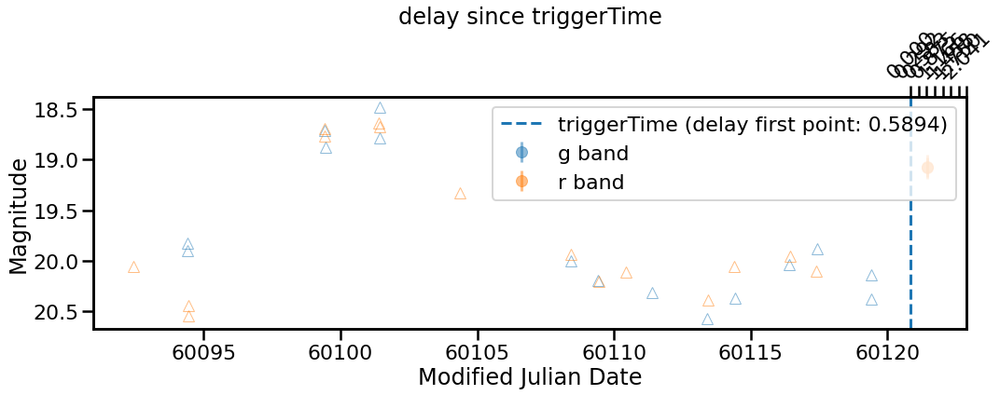

ZTF23aarszuc
['Unknown']
distance to the gcn: 5.132406593127802 deg


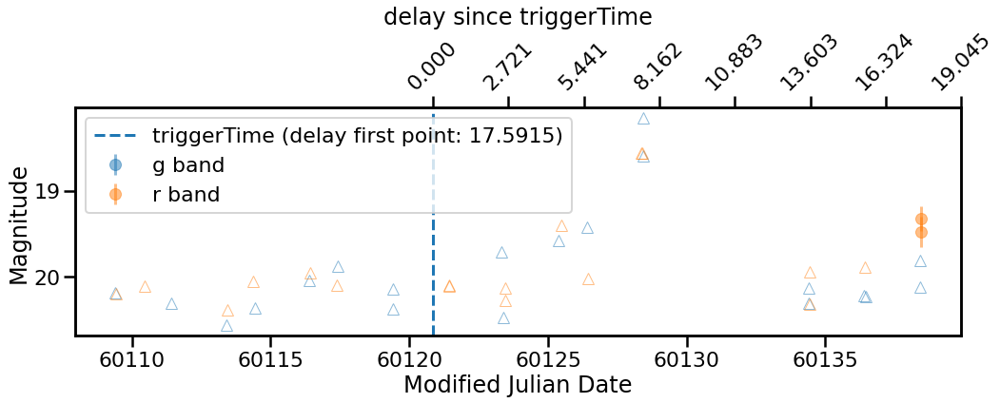

ZTF23aarsztw
['Unknown']
distance to the gcn: 5.621631967874056 deg


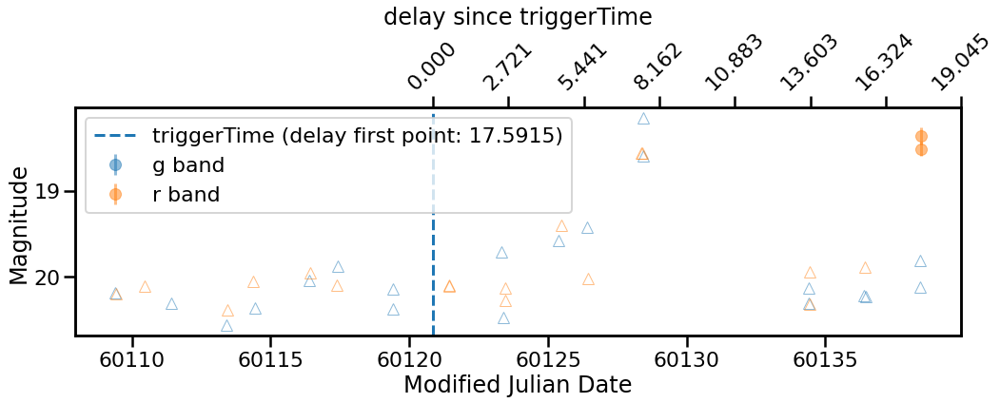

ZTF23aaqvcug
['Unknown']
distance to the gcn: 5.4553666250092485 deg


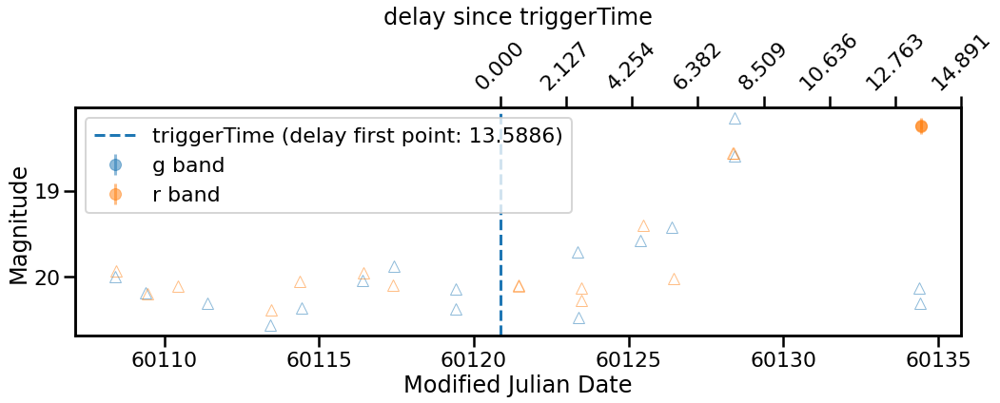

ZTF23aaqzbhl
['Unknown']
distance to the gcn: 2.385668545131863 deg


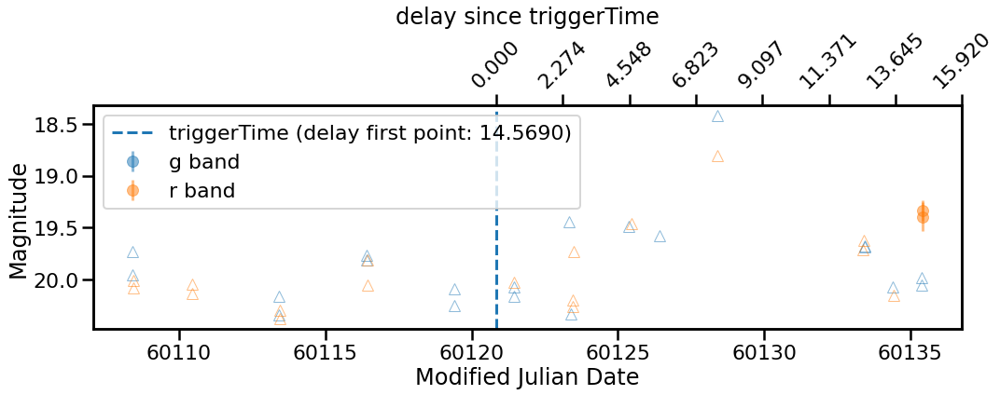

ZTF23aaqunib
['Unknown' 'SN candidate']
distance to the gcn: 4.886333598042507 deg


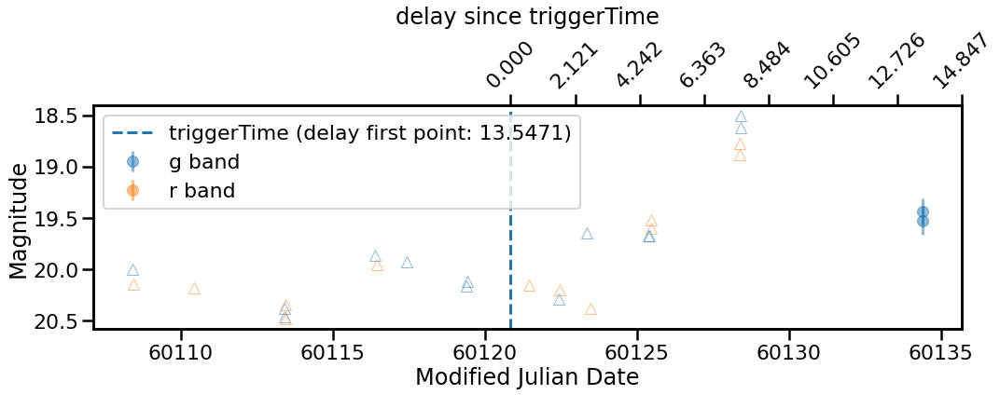

ZTF23aaqefnf
['SN candidate' 'Unknown']
distance to the gcn: 3.423150855295745 deg


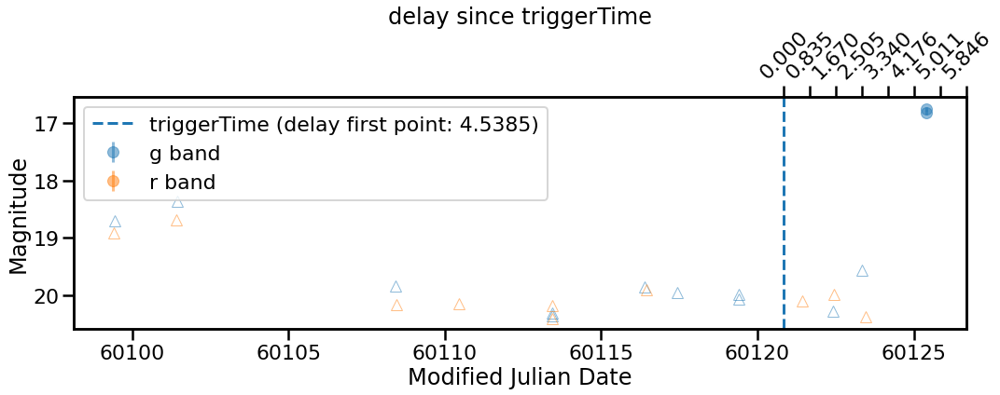

ZTF23aaqfizm
['Unknown']
distance to the gcn: 3.4272000906433204 deg


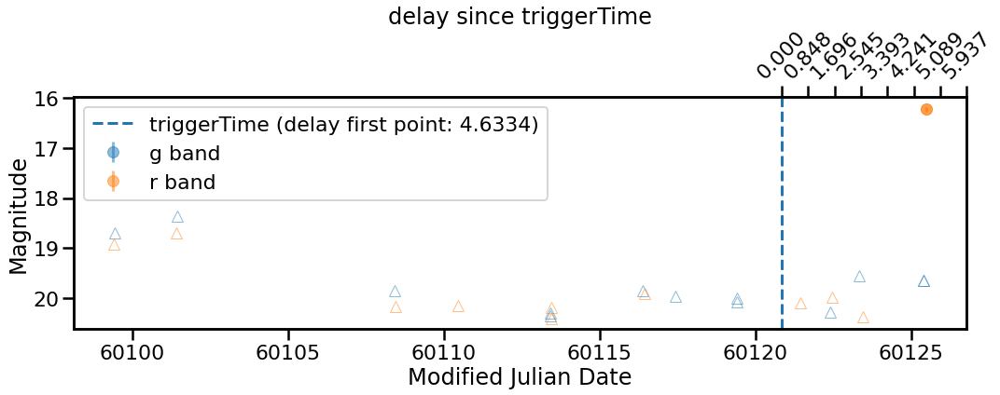

ZTF23aarkzed
['Unknown']
distance to the gcn: 3.049593833866608 deg


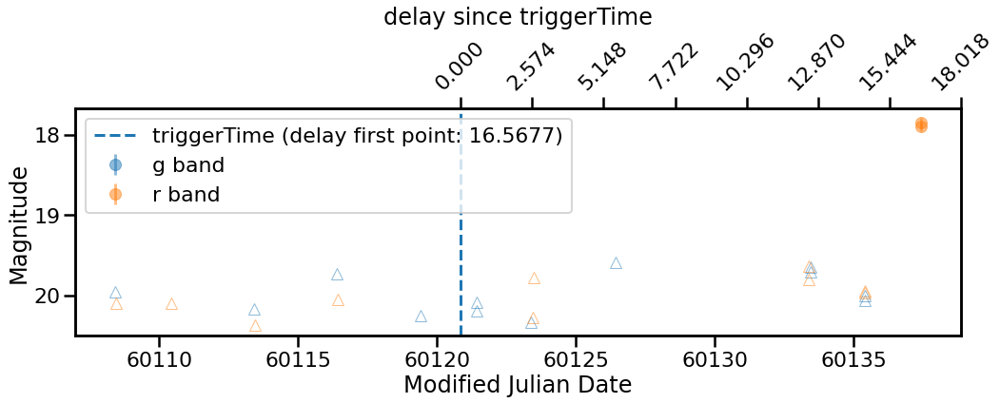

ZTF23aaqukhc
['SN candidate' 'Unknown']
distance to the gcn: 3.693420035880545 deg


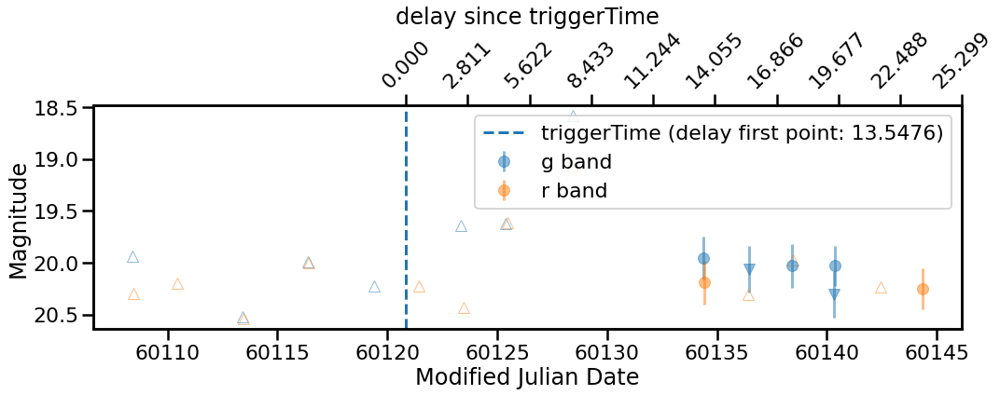

ZTF23aaptbvm
['SN candidate']
distance to the gcn: 4.550728591583719 deg


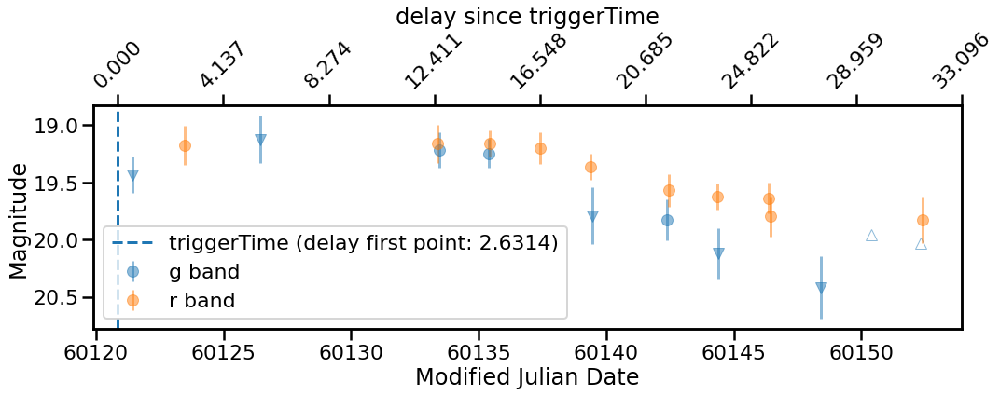

----------------------------------------------




711805358   initial
+-----------+----------------------------+-------------+------------+-------+--------------------+------------+
| triggerId |       triggerTimeUTC       | observatory | instrument | event |   gcn_loc_error    | gcn_status |
+-----------+----------------------------+-------------+------------+-------+--------------------+------------+
| 711805358 | 2023-07-23 13:42:33.030000 |    Fermi    |    GBM     |       | 215.39999999999998 |  initial   |
+-----------+----------------------------+-------------+------------+-------+--------------------+------------+


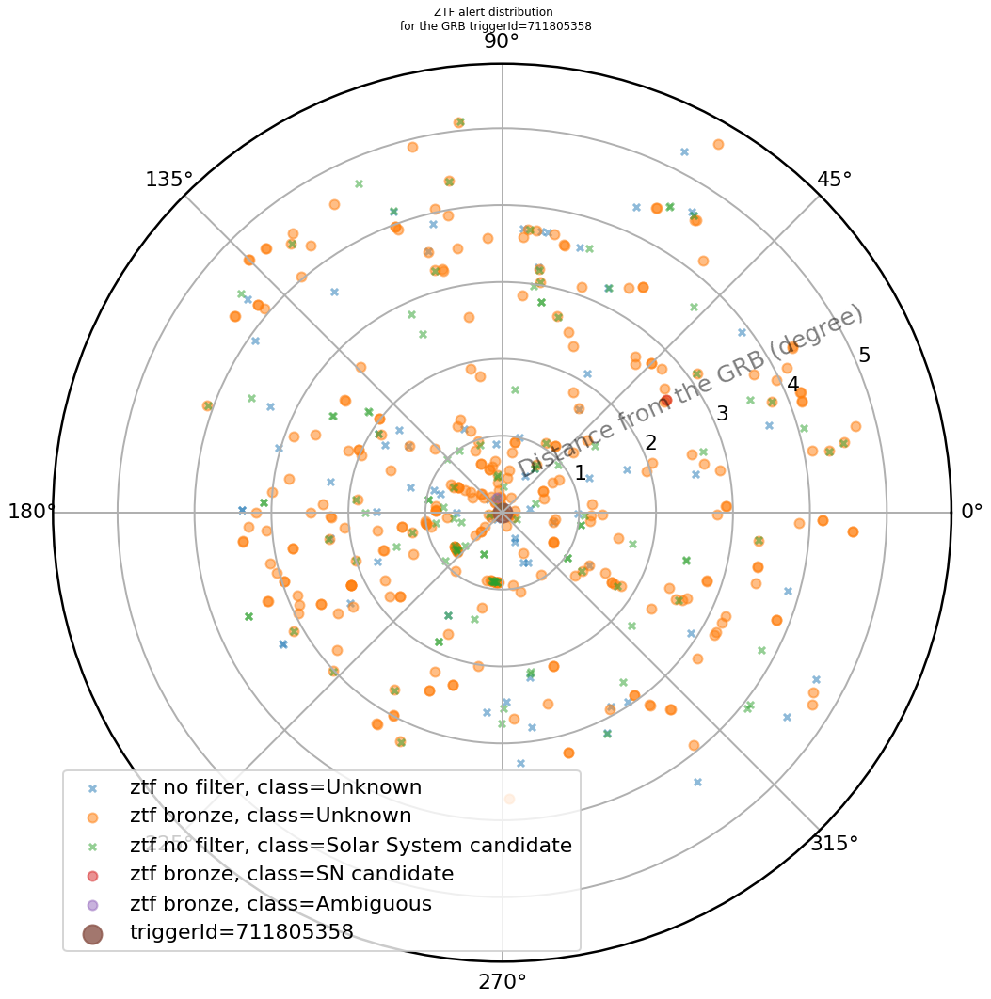

nb objId = 4
ZTF23aauvhty
['Unknown']
distance to the gcn: 0.6966036116917935 deg


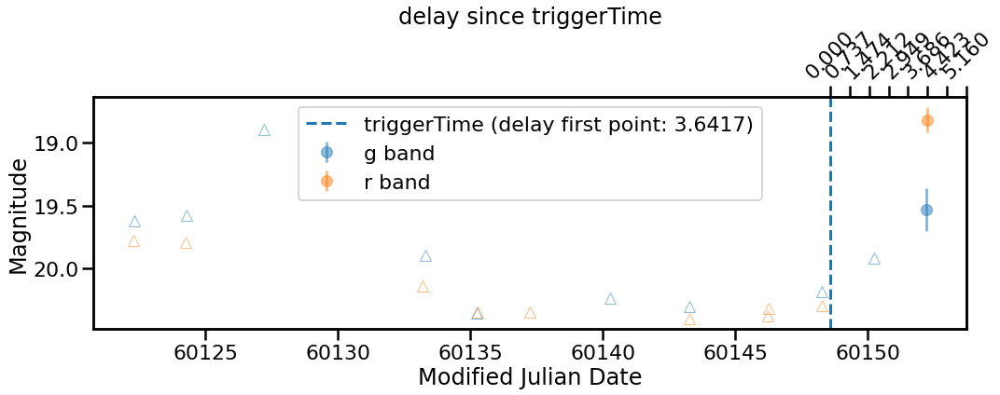

ZTF23aauviag
['SN candidate' 'Unknown']
distance to the gcn: 2.6622212695057703 deg


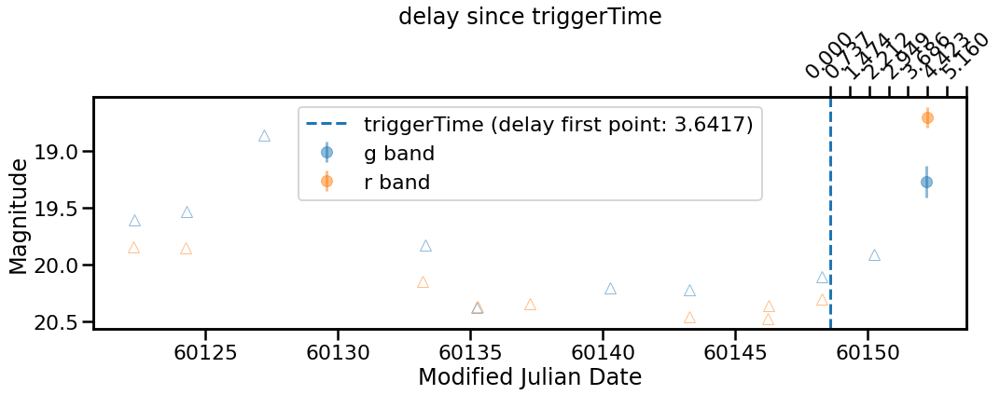

ZTF23aavjygg
['Unknown']
distance to the gcn: 4.60501179591113 deg


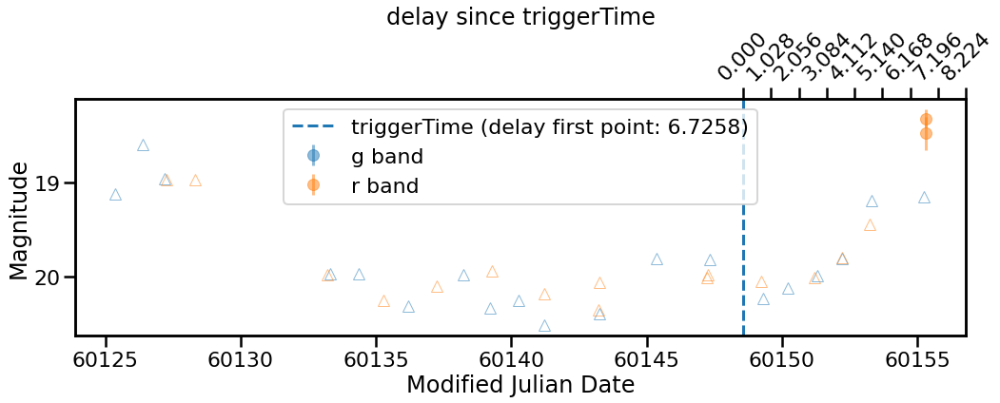

ZTF23aauvnlg
['Unknown']
distance to the gcn: 4.192611447519151 deg


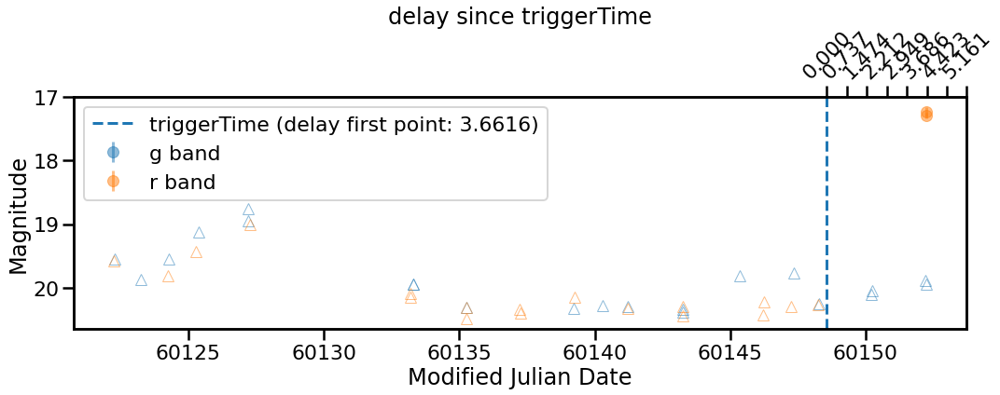

----------------------------------------------




714771169   initial
+-----------+----------------------------+-------------+------------+-------+---------------+------------+
| triggerId |       triggerTimeUTC       | observatory | instrument | event | gcn_loc_error | gcn_status |
+-----------+----------------------------+-------------+------------+-------+---------------+------------+
| 714771169 | 2023-08-26 21:32:44.530000 |    Fermi    |    GBM     |       |     121.2     |  initial   |
+-----------+----------------------------+-------------+------------+-------+---------------+------------+


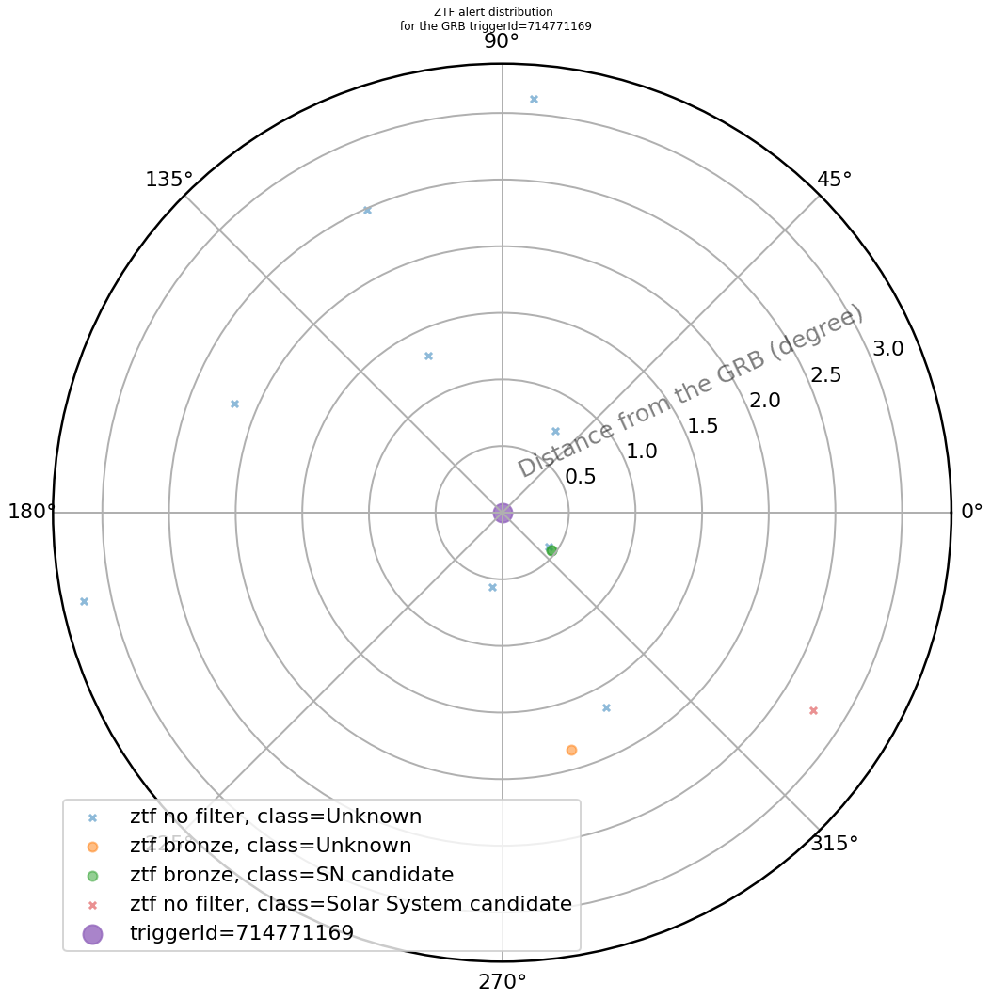

nb objId = 1
ZTF23abbkyty
['SN candidate']
distance to the gcn: 0.7949177002535941 deg


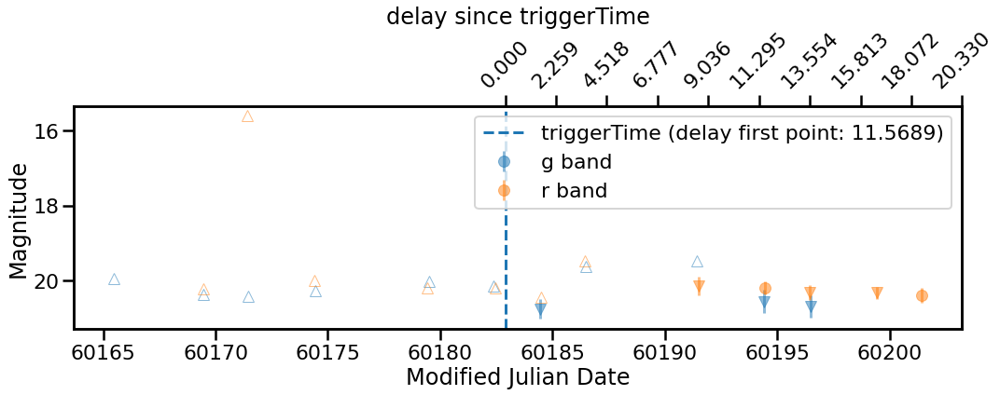

----------------------------------------------




713966581   initial
+-----------+----------------------------+-------------+------------+-------+---------------+------------+
| triggerId |       triggerTimeUTC       | observatory | instrument | event | gcn_loc_error | gcn_status |
+-----------+----------------------------+-------------+------------+-------+---------------+------------+
| 713966581 | 2023-08-17 14:02:56.560000 |    Fermi    |    GBM     |       |     418.2     |  initial   |
+-----------+----------------------------+-------------+------------+-------+---------------+------------+


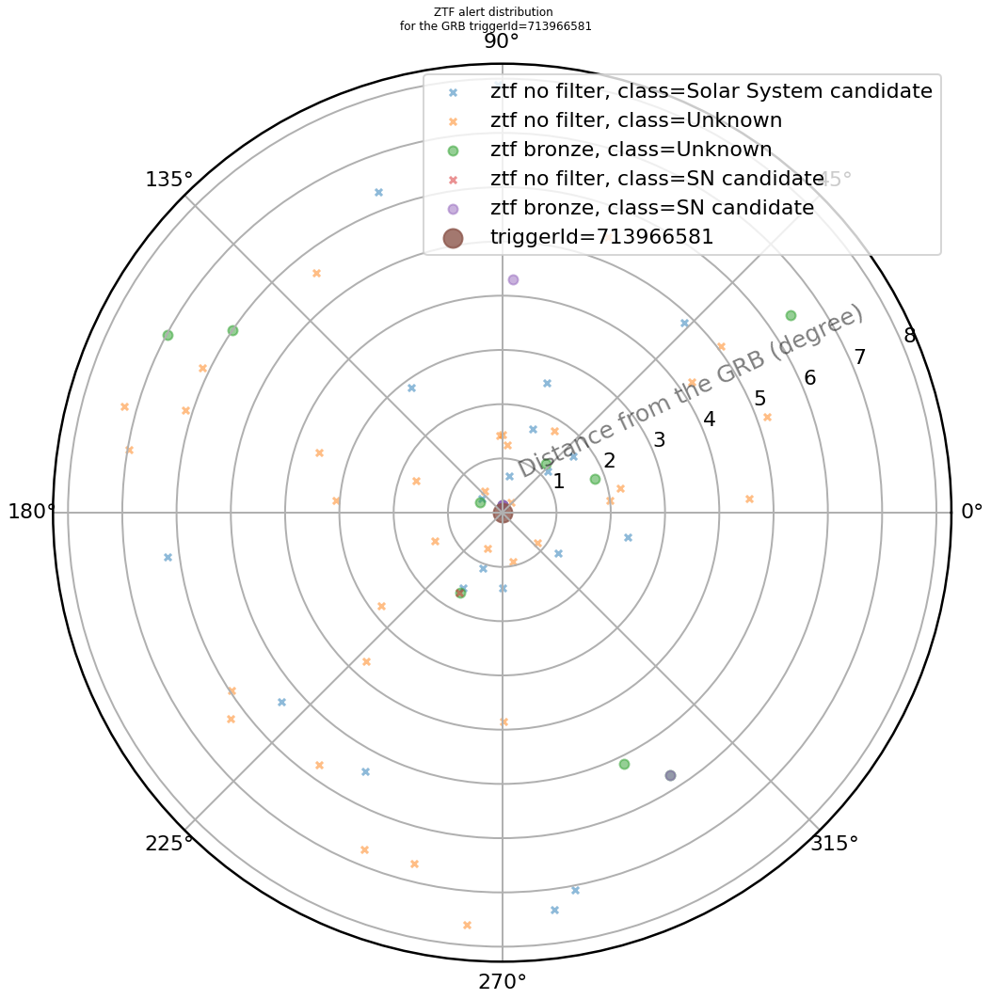

nb objId = 2
ZTF23aazrxwo
['Unknown' 'SN candidate']
distance to the gcn: 5.835420696149487 deg


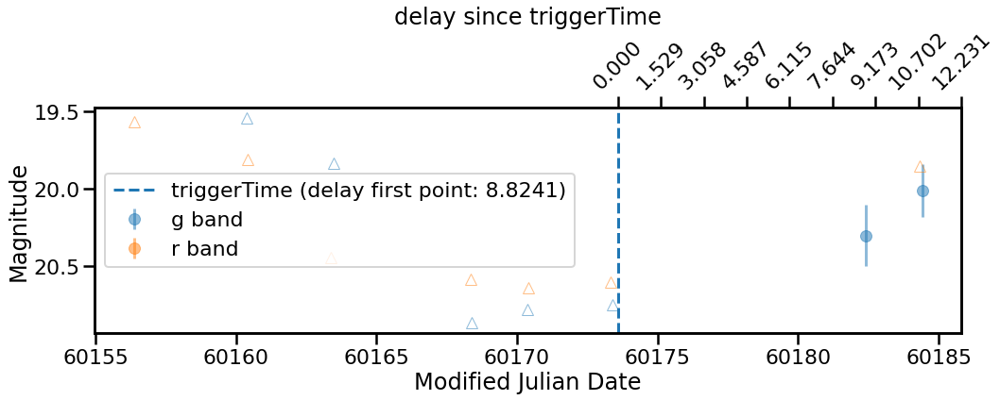

ZTF23ababkmo
['Unknown' 'SN candidate']
distance to the gcn: 4.762673937045961 deg


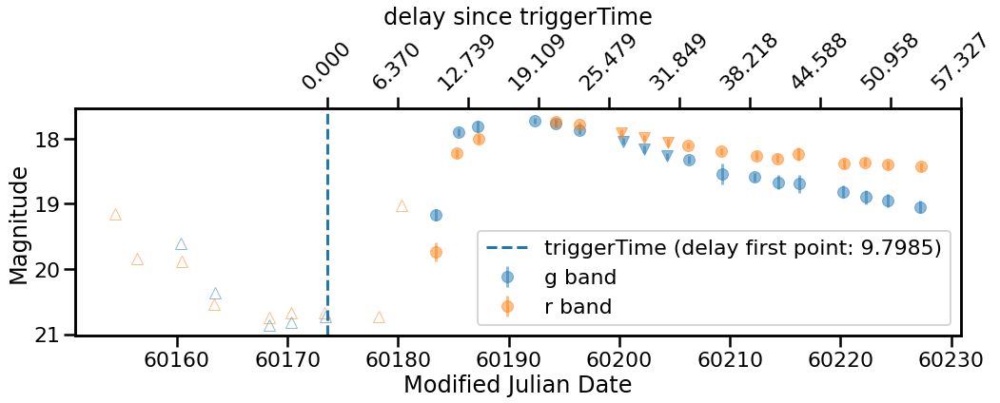

----------------------------------------------




710711405   initial
+-----------+----------------------------+-------------+------------+-------+---------------+------------+
| triggerId |       triggerTimeUTC       | observatory | instrument | event | gcn_loc_error | gcn_status |
+-----------+----------------------------+-------------+------------+-------+---------------+------------+
| 710711405 | 2023-07-10 21:50:00.790000 |    Fermi    |    GBM     |       |     286.8     |  initial   |
+-----------+----------------------------+-------------+------------+-------+---------------+------------+


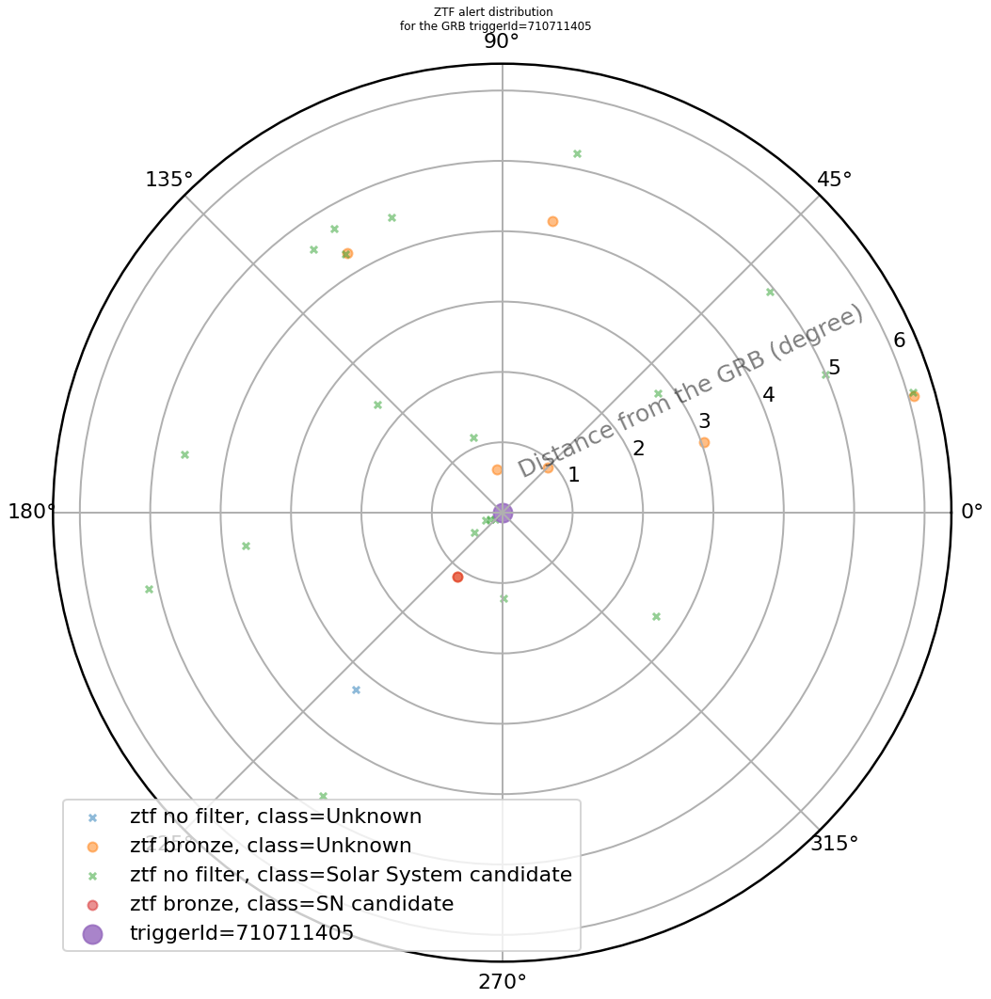

nb objId = 1
ZTF23aaufzym
['Unknown' 'SN candidate']
distance to the gcn: 2.4373301123212077 deg


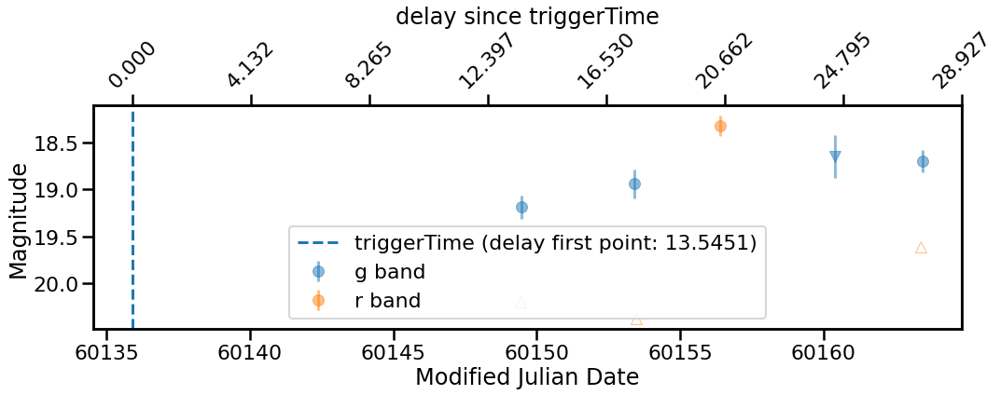

----------------------------------------------




710120768   initial
+-----------+----------------------------+-------------+------------+-------+---------------+------------+
| triggerId |       triggerTimeUTC       | observatory | instrument | event | gcn_loc_error | gcn_status |
+-----------+----------------------------+-------------+------------+-------+---------------+------------+
| 710120768 | 2023-07-04 01:46:03.510000 |    Fermi    |    GBM     |       |    415.998    |  initial   |
+-----------+----------------------------+-------------+------------+-------+---------------+------------+


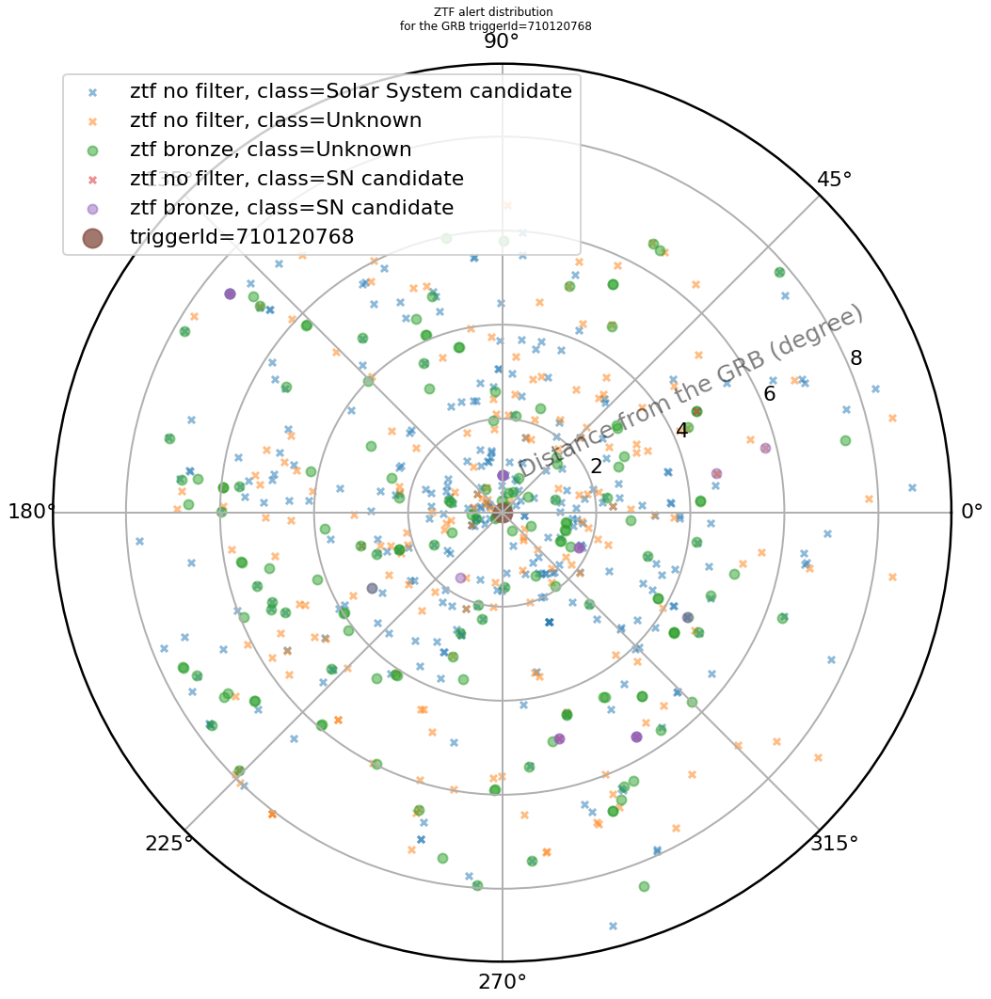

nb objId = 13
ZTF23aarxwul
['Unknown']
distance to the gcn: 6.085439188384161 deg


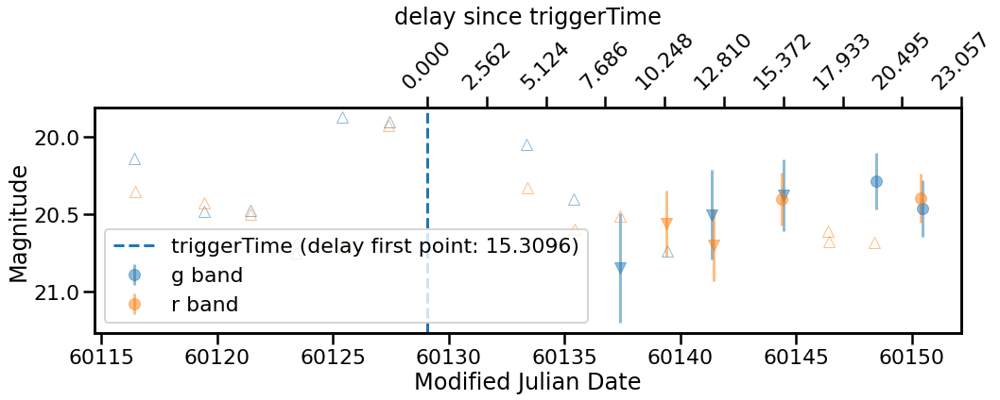

ZTF23aasxuyq
['Unknown' 'SN candidate']
distance to the gcn: 4.6262019662529585 deg


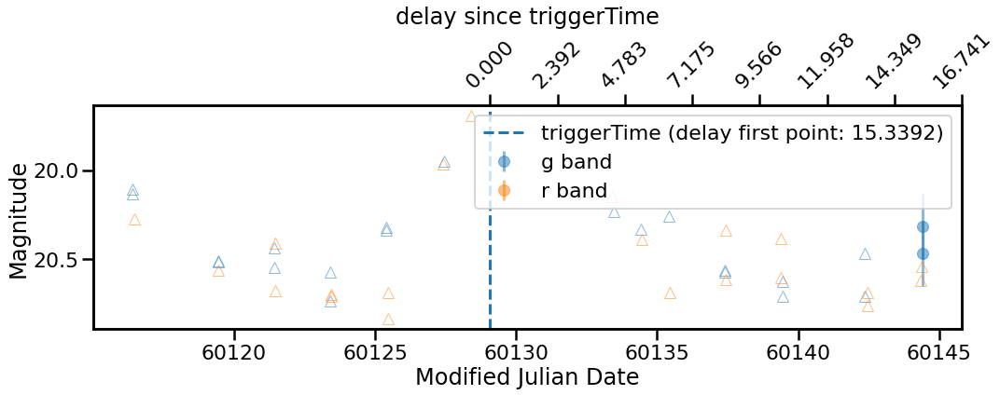

ZTF23aasybka
['Solar System candidate' 'SN candidate']
distance to the gcn: 7.217757994769581 deg


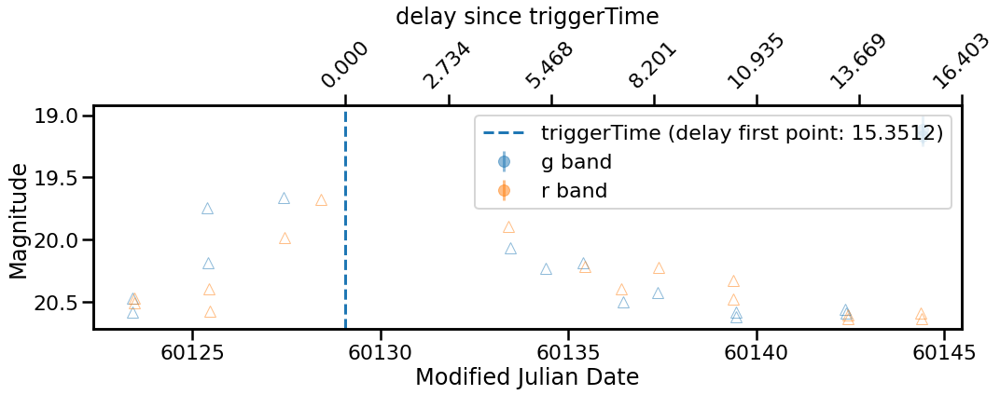

ZTF23aarzkgg
['Unknown' 'SN candidate']
distance to the gcn: 4.811498446295155 deg


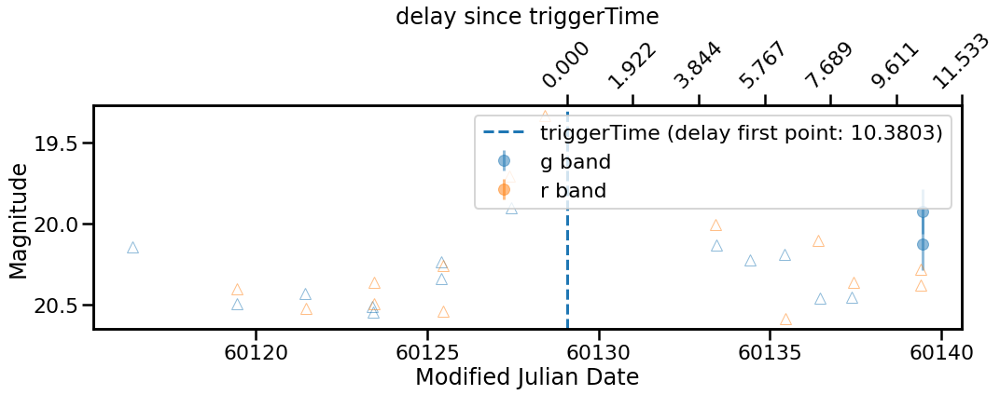

ZTF23aatqmbb
['SN candidate' 'Unknown']
distance to the gcn: 8.222619883224647 deg


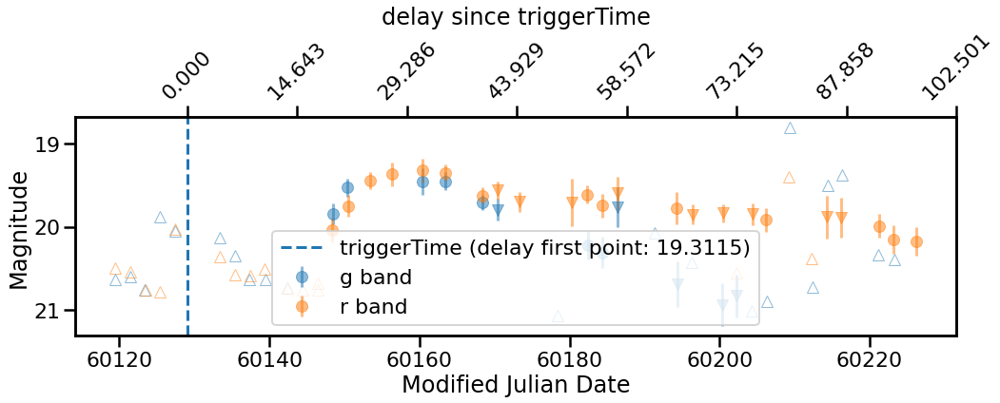

ZTF23aatmmbm
['Unknown']
distance to the gcn: 4.154721936839327 deg


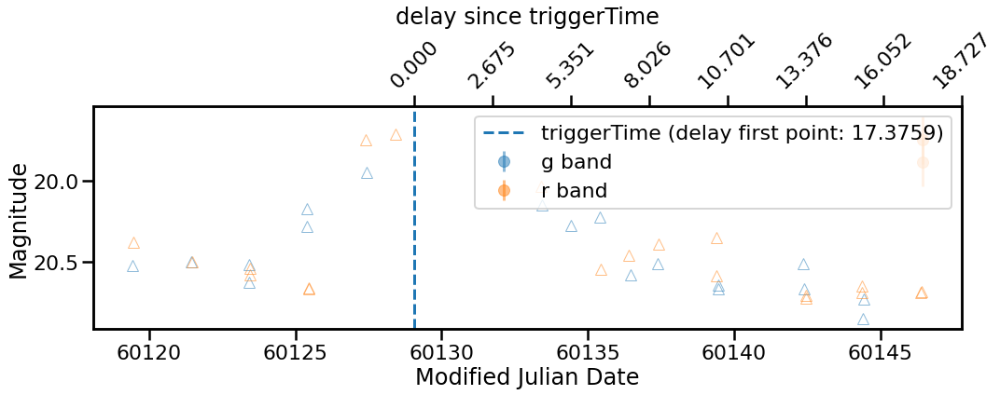

ZTF23aasxtfc
['SN candidate' 'Unknown']
distance to the gcn: 4.684009120136199 deg


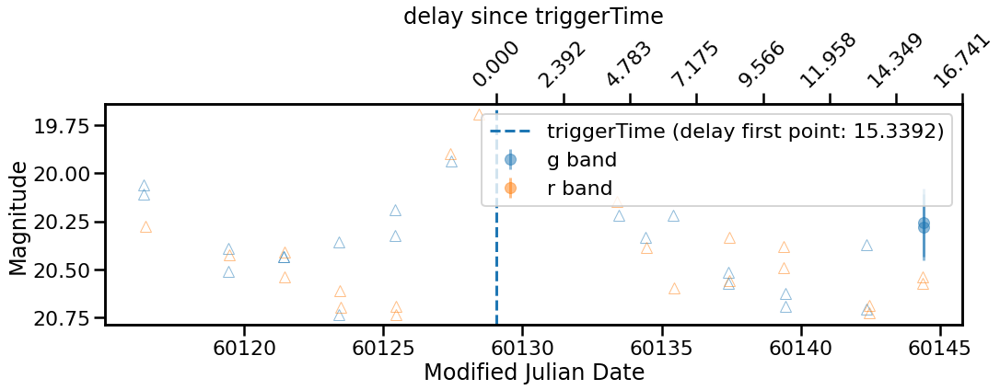

ZTF23aaswskf
['Unknown']
distance to the gcn: 8.337683468974678 deg


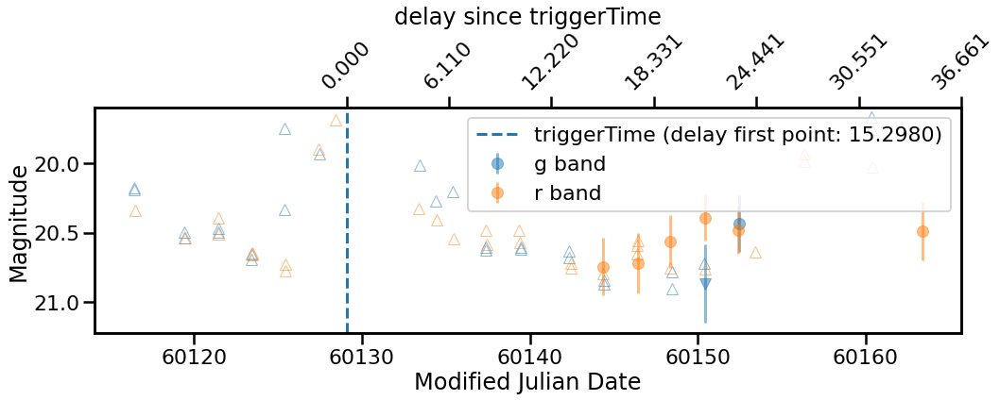

ZTF23aasygqe
['SN candidate']
distance to the gcn: 8.029283375794382 deg


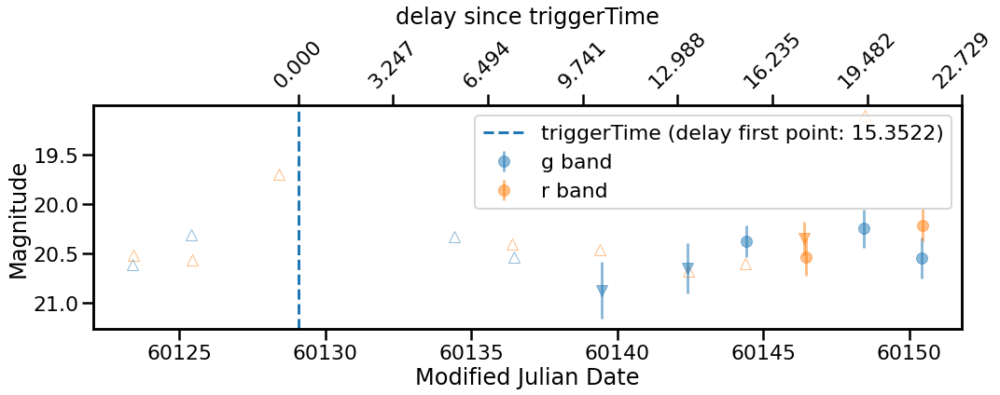

ZTF23aasxenq
['SN candidate']
distance to the gcn: 6.922286015735062 deg


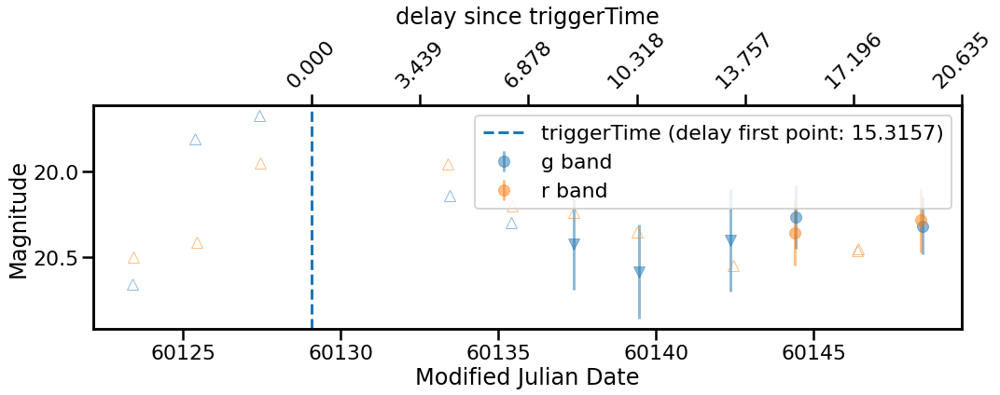

ZTF23aasmafk
['SN candidate']
distance to the gcn: 7.537655310968915 deg


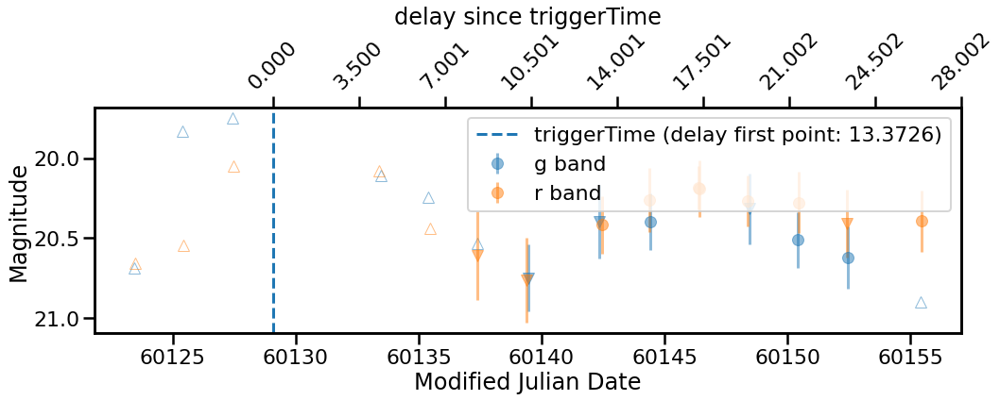

ZTF23aarxuzu
['SN candidate' 'Unknown']
distance to the gcn: 7.8764752794745245 deg


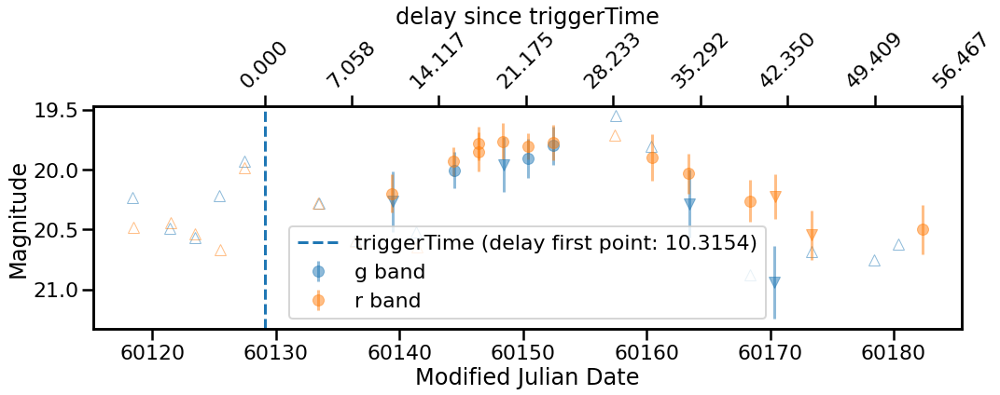

ZTF23aarfodg
['SN candidate']
distance to the gcn: 7.124712269051842 deg


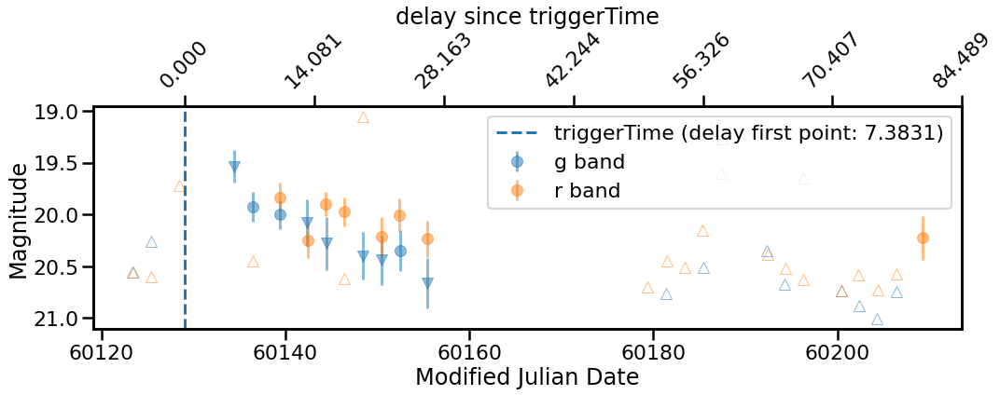

----------------------------------------------




711299080   initial
+-----------+----------------------------+-------------+------------+-------+---------------+------------+
| triggerId |       triggerTimeUTC       | observatory | instrument | event | gcn_loc_error | gcn_status |
+-----------+----------------------------+-------------+------------+-------+---------------+------------+
| 711299080 | 2023-07-17 17:04:35.890000 |    Fermi    |    GBM     |       |    412.998    |  initial   |
+-----------+----------------------------+-------------+------------+-------+---------------+------------+


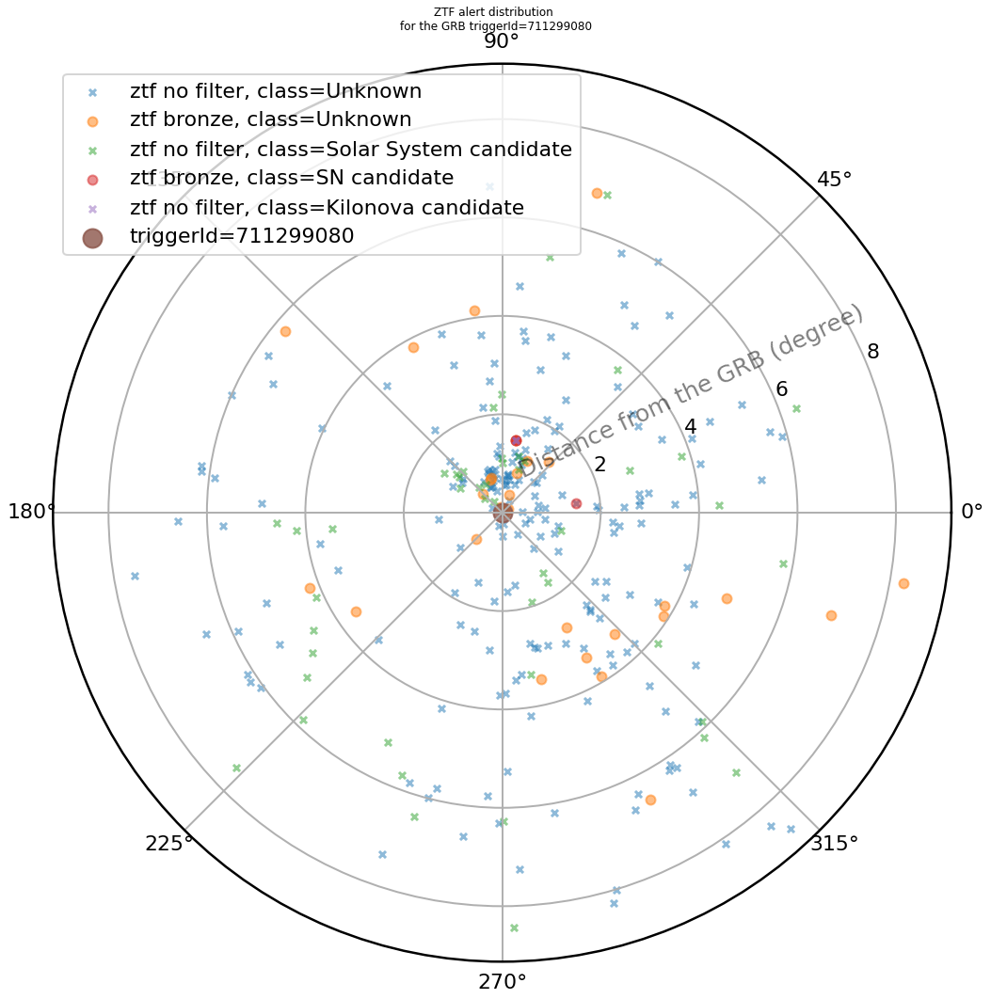

nb objId = 2
ZTF23aavvipn
['SN candidate' 'Unknown']
distance to the gcn: 6.8134519893465475 deg


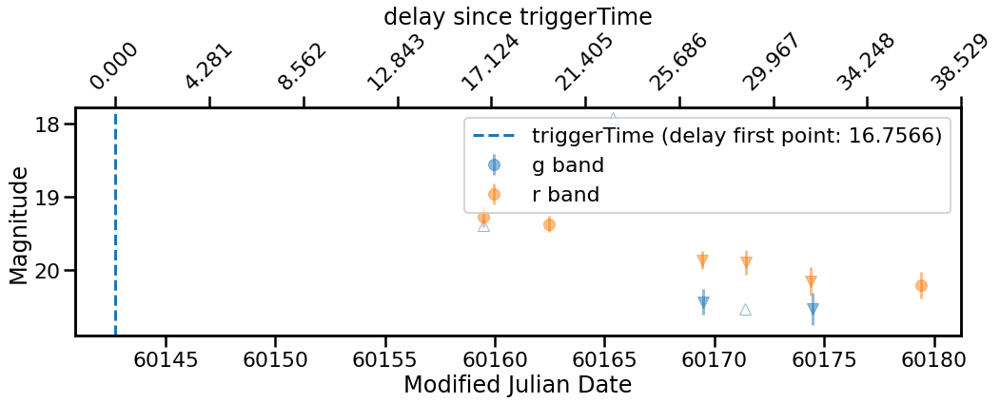

ZTF23aavvdix
['SN candidate' 'Kilonova candidate' 'Unknown']
distance to the gcn: 8.06526778585967 deg


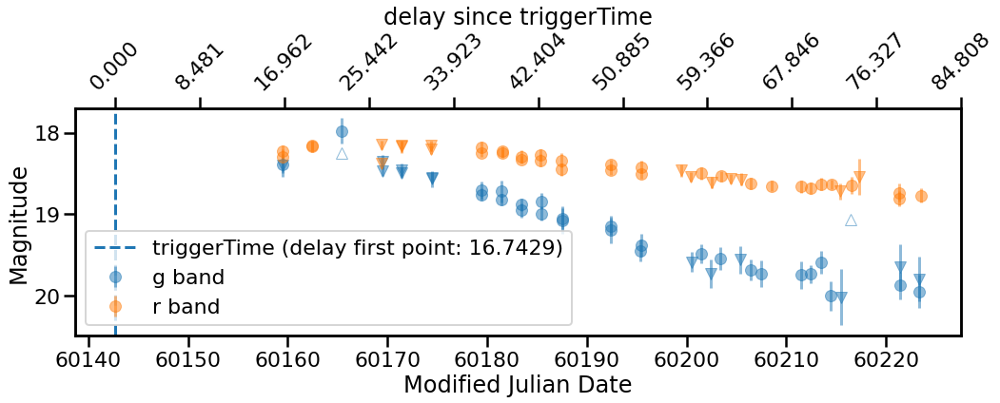

----------------------------------------------




716284577   initial
+-----------+----------------------------+-------------+------------+-------+---------------+------------+
| triggerId |       triggerTimeUTC       | observatory | instrument | event | gcn_loc_error | gcn_status |
+-----------+----------------------------+-------------+------------+-------+---------------+------------+
| 716284577 | 2023-09-13 09:56:12.160000 |    Fermi    |    GBM     |       |     313.8     |  initial   |
+-----------+----------------------------+-------------+------------+-------+---------------+------------+


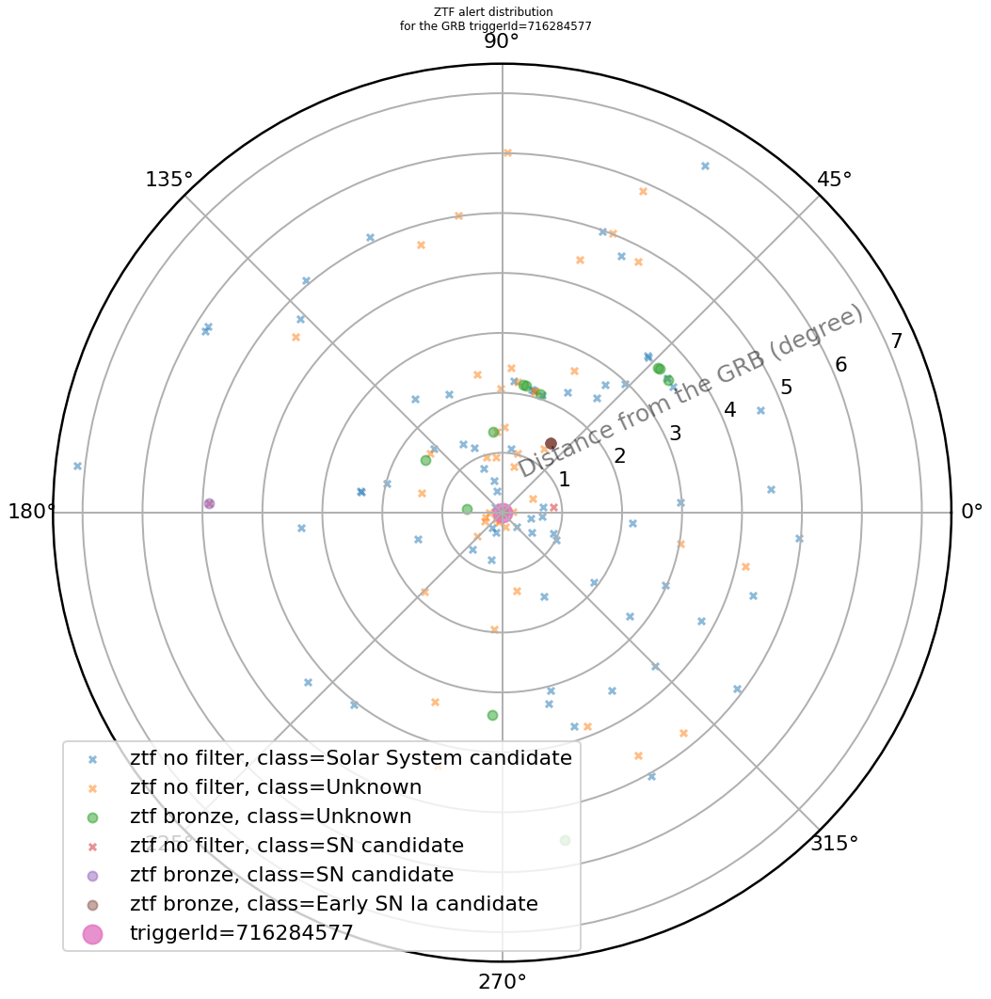

nb objId = 2
ZTF23abhsjed
['SN candidate']
distance to the gcn: 5.5258239531620905 deg


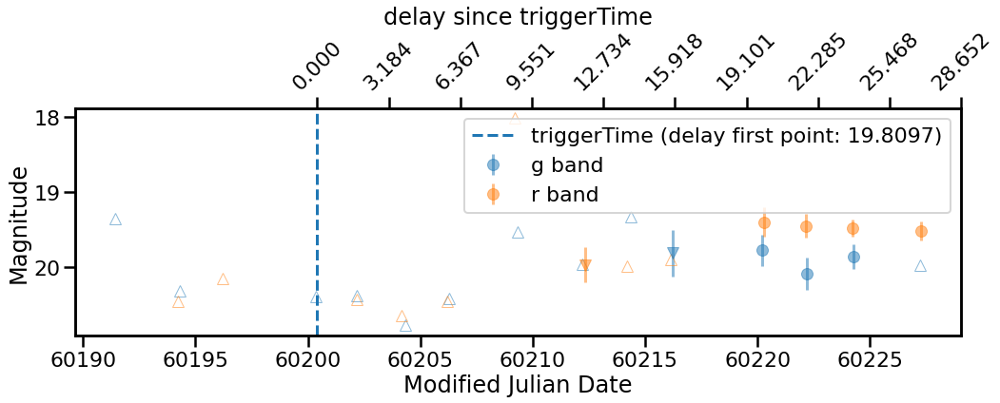

ZTF23abejxgc
['SN candidate' 'Early SN Ia candidate']
distance to the gcn: 1.7605105729740453 deg


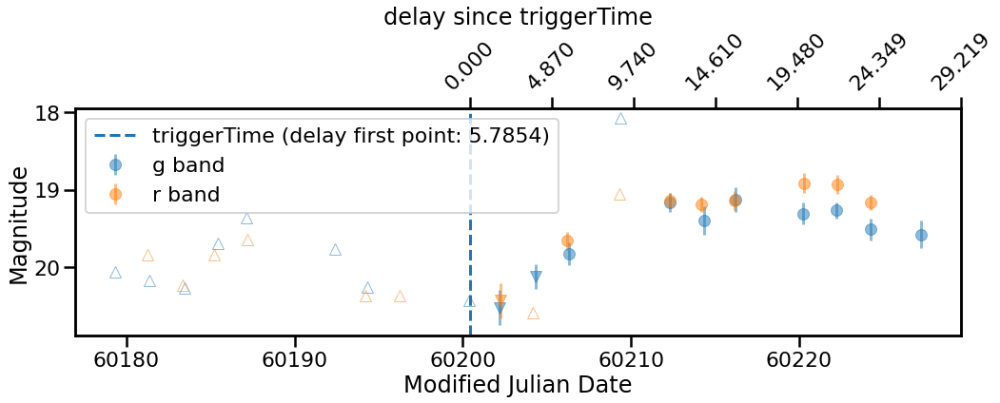

----------------------------------------------




708758776   initial
+-----------+----------------------------+-------------+------------+-------+---------------+------------+
| triggerId |       triggerTimeUTC       | observatory | instrument | event | gcn_loc_error | gcn_status |
+-----------+----------------------------+-------------+------------+-------+---------------+------------+
| 708758776 | 2023-06-18 07:26:11.930000 |    Fermi    |    GBM     |       |     60.0      |  initial   |
+-----------+----------------------------+-------------+------------+-------+---------------+------------+


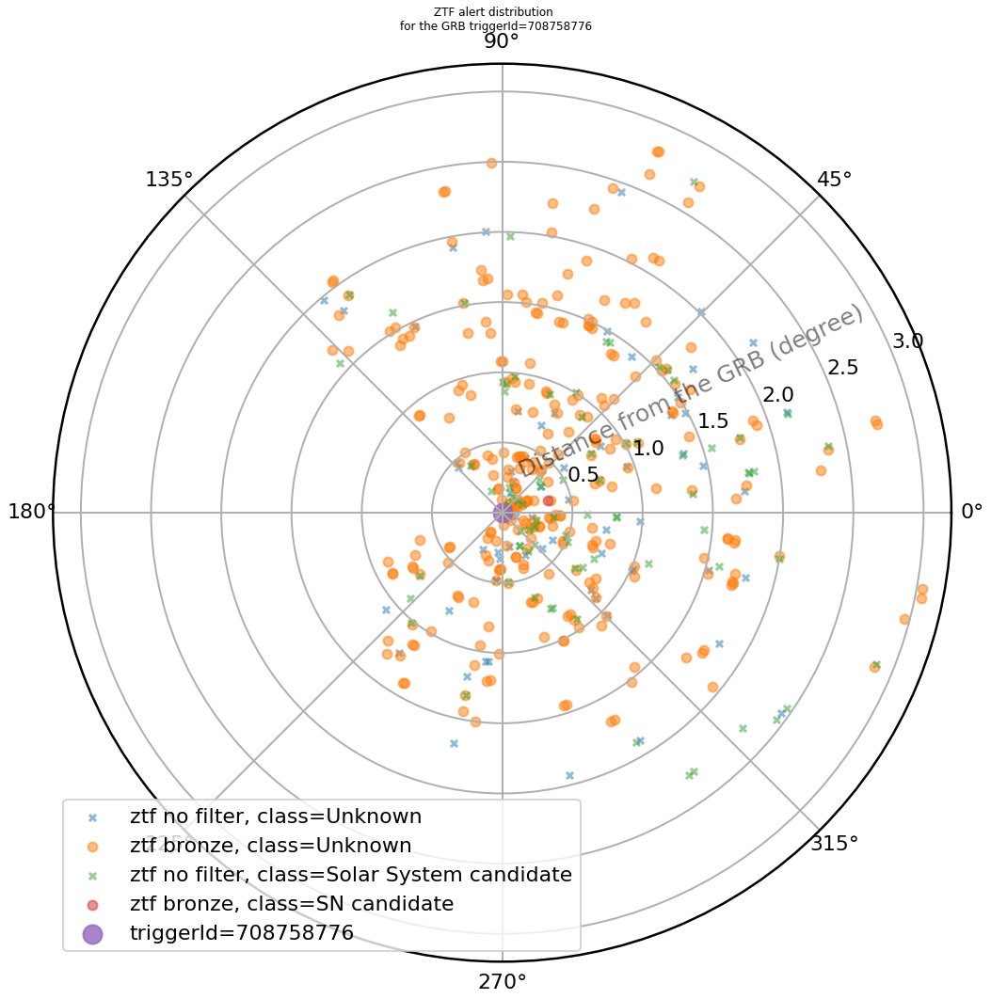

nb objId = 1
ZTF23aapbqiy
['Unknown']
distance to the gcn: 1.7334949357431473 deg


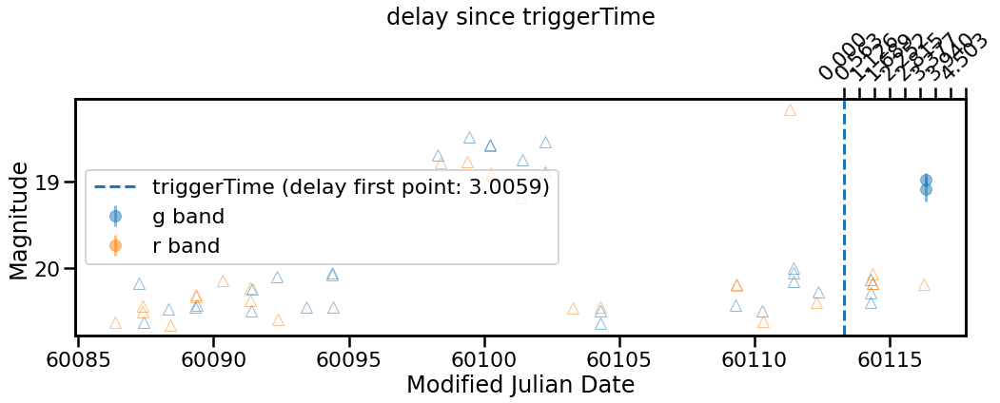

----------------------------------------------




712713532   initial
+-----------+----------------------------+-------------+------------+-------+---------------+------------+
| triggerId |       triggerTimeUTC       | observatory | instrument | event | gcn_loc_error | gcn_status |
+-----------+----------------------------+-------------+------------+-------+---------------+------------+
| 712713532 | 2023-08-03 01:58:47.920000 |    Fermi    |    GBM     |       |     352.8     |  initial   |
+-----------+----------------------------+-------------+------------+-------+---------------+------------+


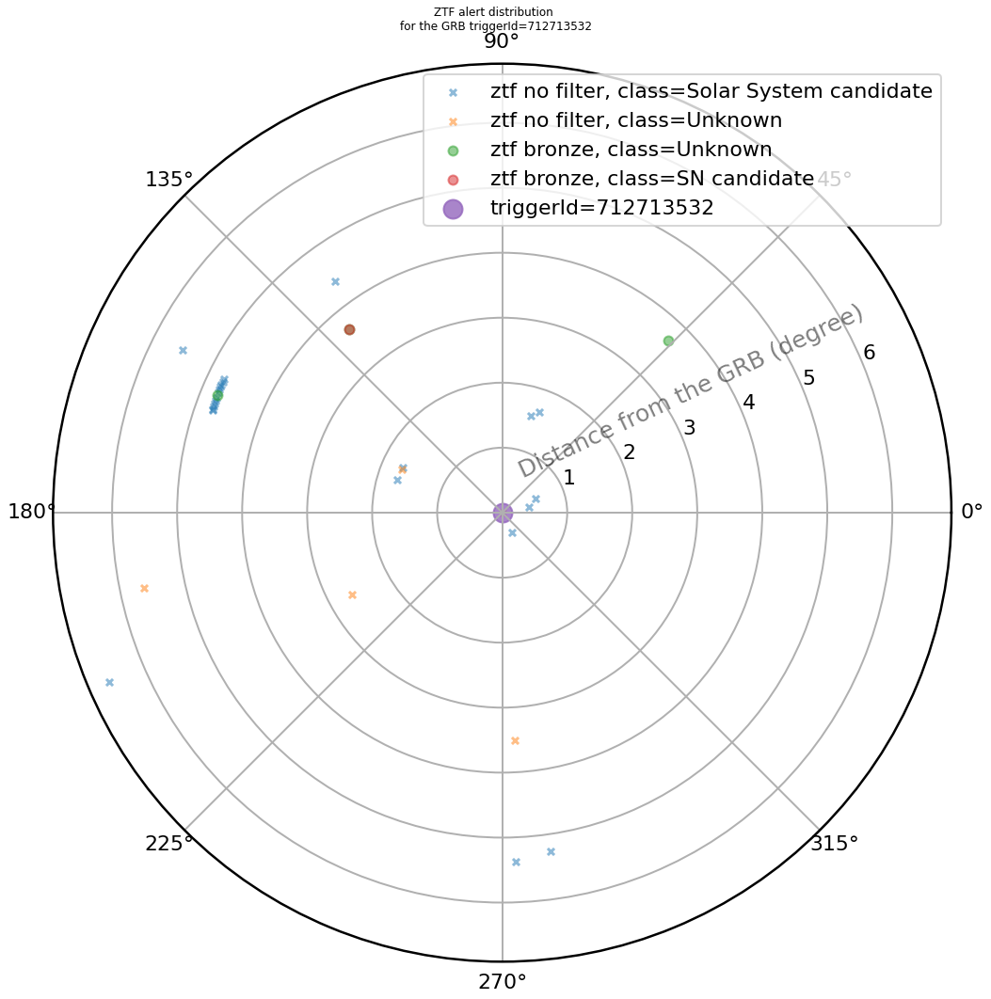

nb objId = 1
ZTF23aaxbfvo
['Unknown' 'SN candidate']
distance to the gcn: 5.430438177183464 deg


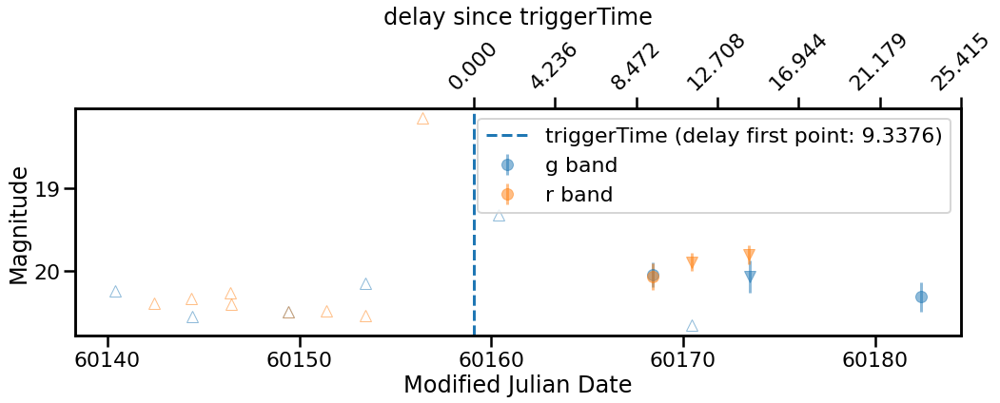

----------------------------------------------




716835508   update_1
+-----------+----------------------------+-------------+------------+-------+--------------------+------------+
| triggerId |       triggerTimeUTC       | observatory | instrument | event |   gcn_loc_error    | gcn_status |
+-----------+----------------------------+-------------+------------+-------+--------------------+------------+
| 716835508 | 2023-09-19 18:58:23.860000 |    Fermi    |    GBM     |       | 404.40000000000003 |  update_1  |
+-----------+----------------------------+-------------+------------+-------+--------------------+------------+


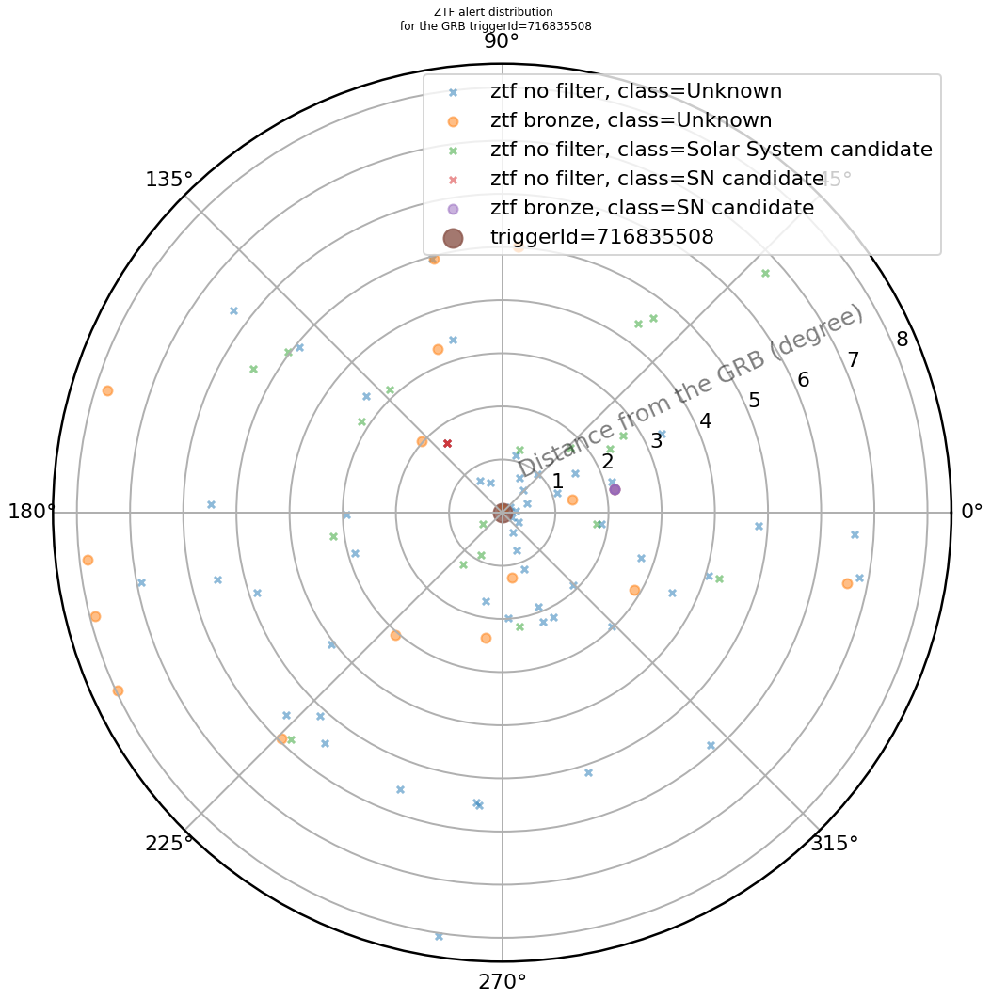

nb objId = 4
ZTF23abhlsha
['Unknown']
distance to the gcn: 5.258273627661189 deg


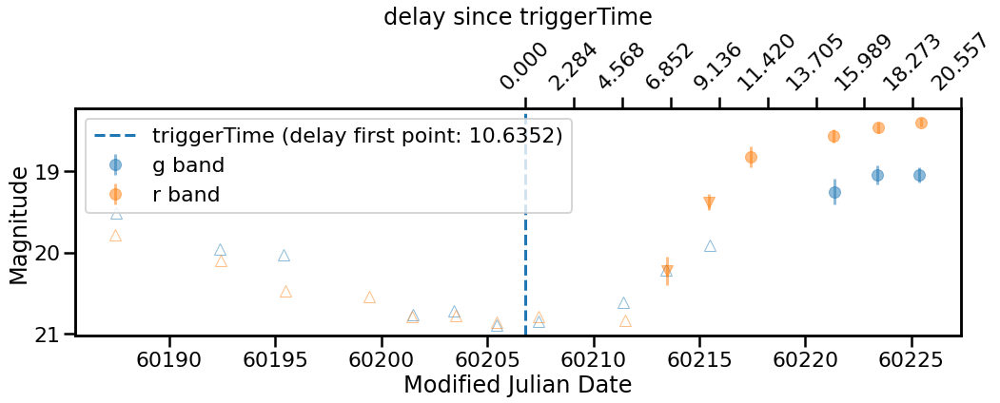

ZTF23abgtmkd
['Unknown']
distance to the gcn: 1.4523464485741102 deg


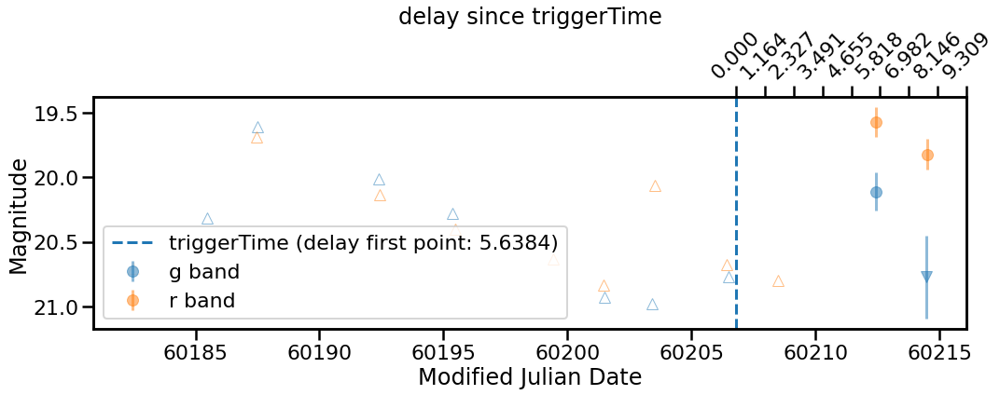

ZTF23abgtnlg
['SN candidate' 'Unknown']
distance to the gcn: 2.8245390787810414 deg


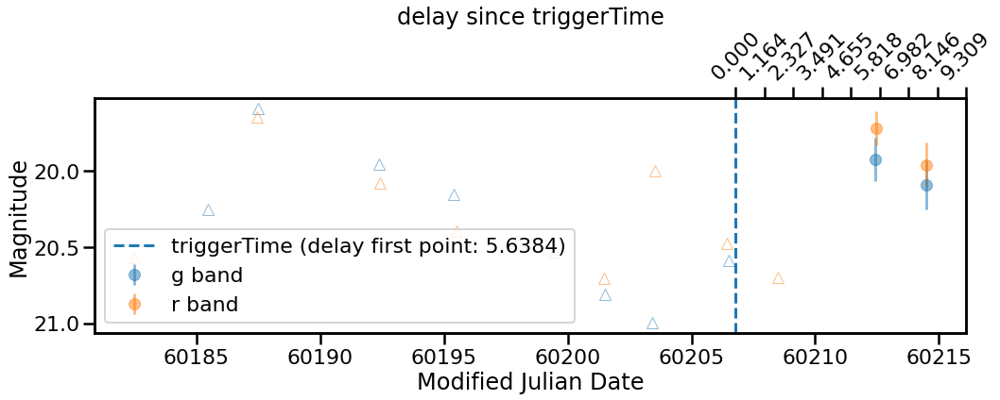

ZTF23abhxwud
['Unknown' 'SN candidate']
distance to the gcn: 6.352991401254887 deg


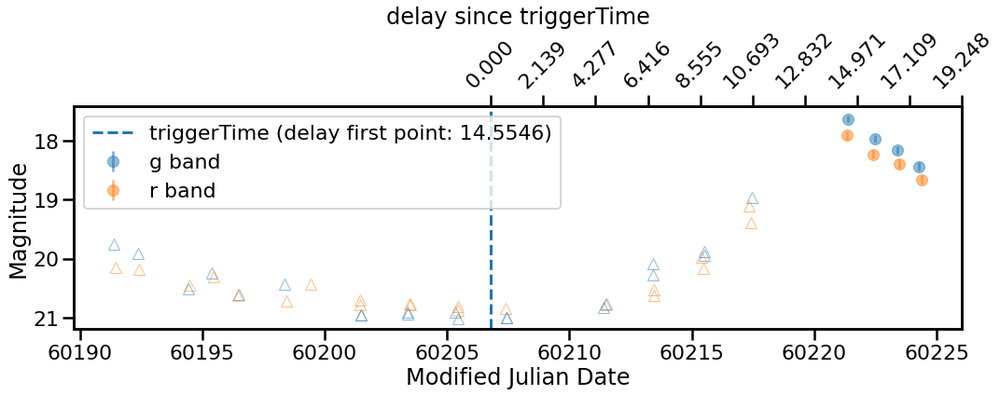

----------------------------------------------




715429986   initial
+-----------+----------------------------+-------------+------------+-------+---------------+------------+
| triggerId |       triggerTimeUTC       | observatory | instrument | event | gcn_loc_error | gcn_status |
+-----------+----------------------------+-------------+------------+-------+---------------+------------+
| 715429986 | 2023-09-03 12:33:01.610000 |    Fermi    |    GBM     |       |     276.6     |  initial   |
+-----------+----------------------------+-------------+------------+-------+---------------+------------+


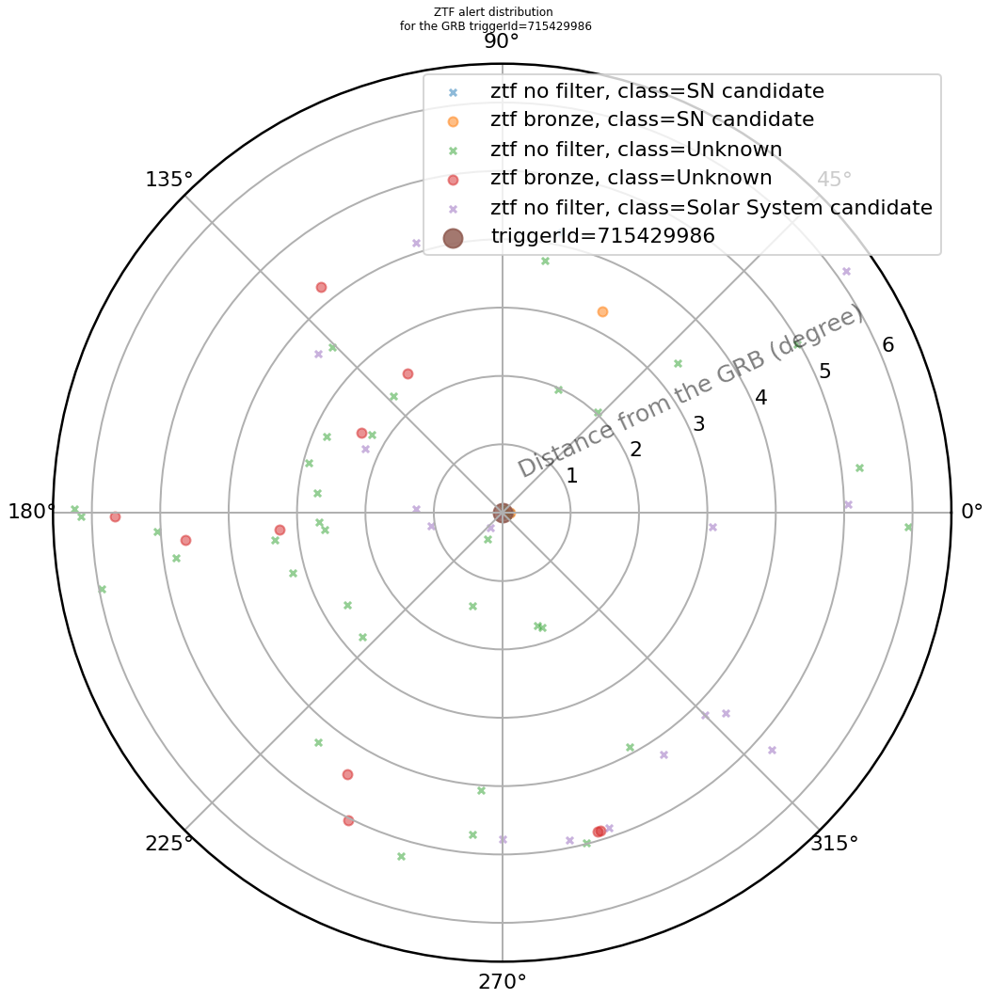

nb objId = 1
ZTF23abdmgav
['SN candidate']
distance to the gcn: 6.243989344194377 deg


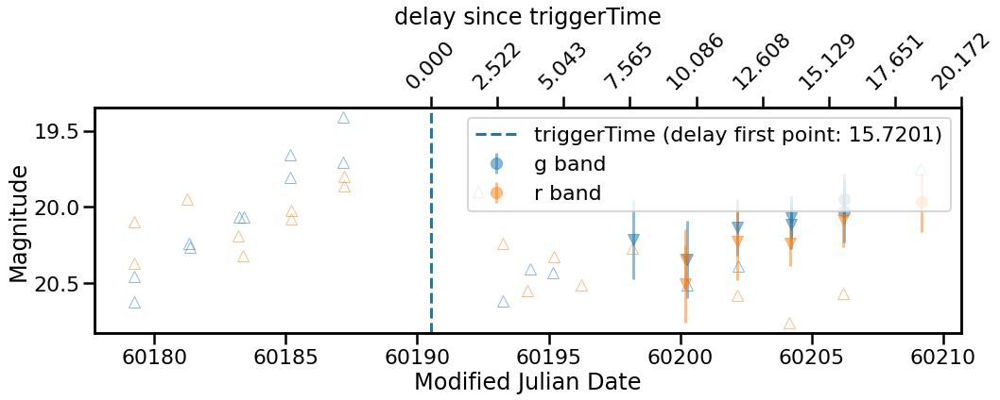

----------------------------------------------




709864601   initial
+-----------+----------------------------+-------------+------------+-------+---------------+------------+
| triggerId |       triggerTimeUTC       | observatory | instrument | event | gcn_loc_error | gcn_status |
+-----------+----------------------------+-------------+------------+-------+---------------+------------+
| 709864601 | 2023-07-01 02:36:36.750000 |    Fermi    |    GBM     |       |     237.6     |  initial   |
+-----------+----------------------------+-------------+------------+-------+---------------+------------+


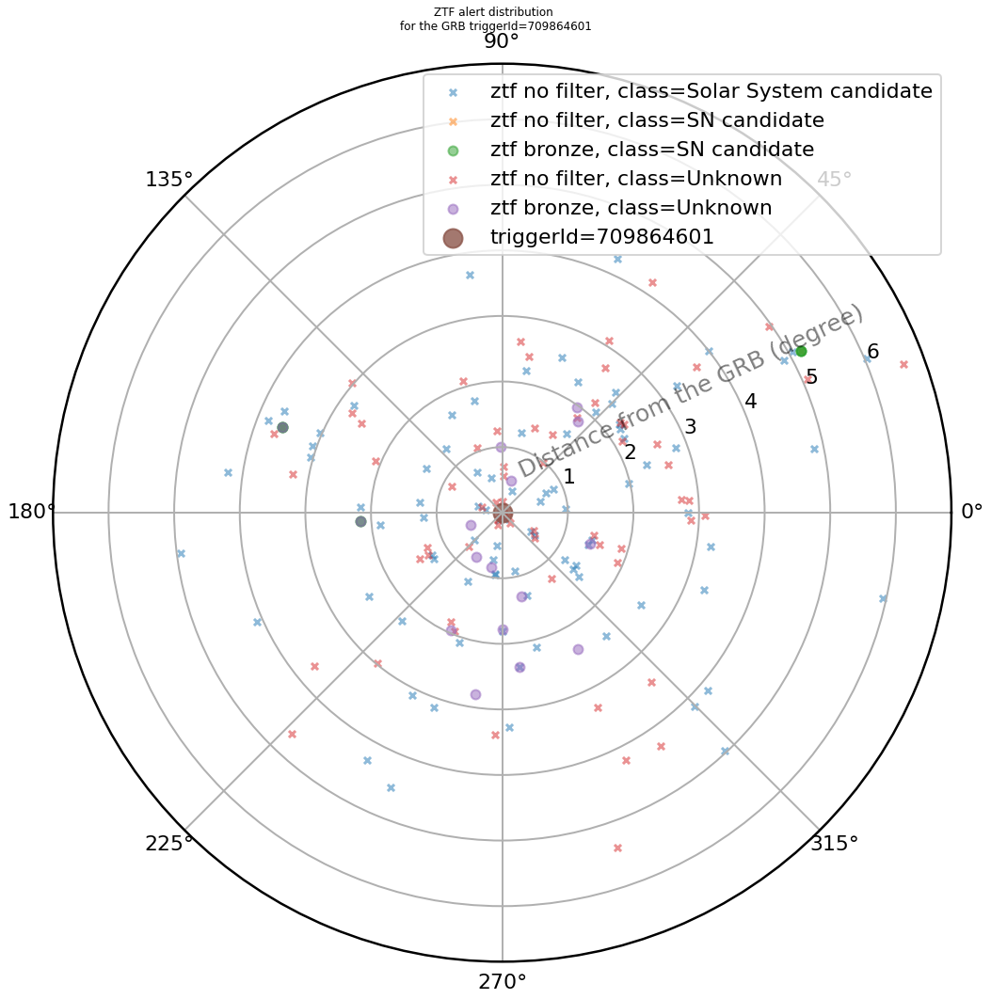

nb objId = 3
ZTF23aarcjdk
['SN candidate' 'Unknown']
distance to the gcn: 3.7146203288870745 deg


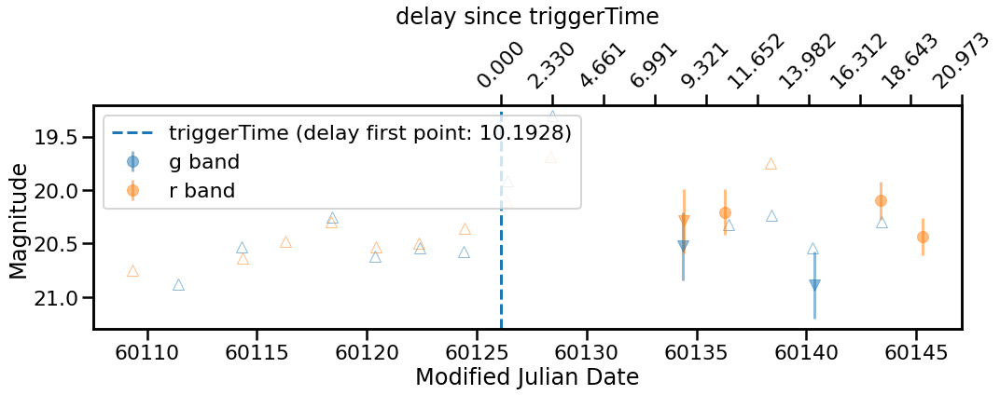

ZTF23aaqxcbb
['SN candidate']
distance to the gcn: 5.2072220610324536 deg


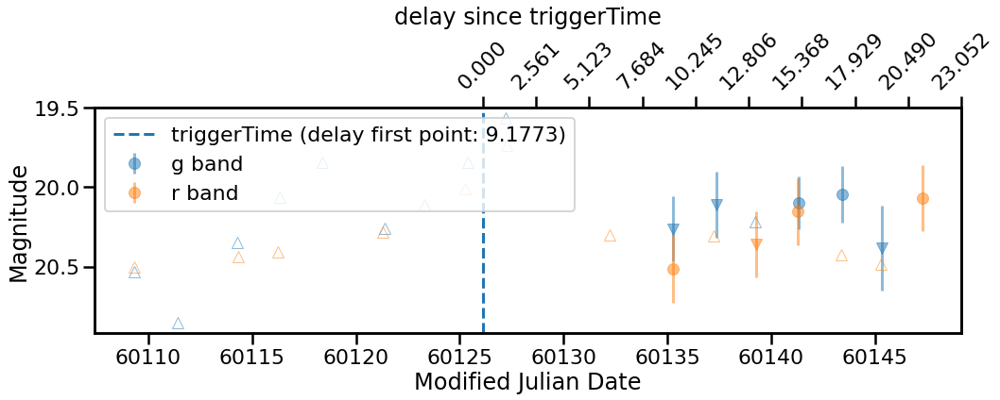

ZTF23aaspcfl
['SN candidate' 'Unknown']
distance to the gcn: 5.327709835892326 deg


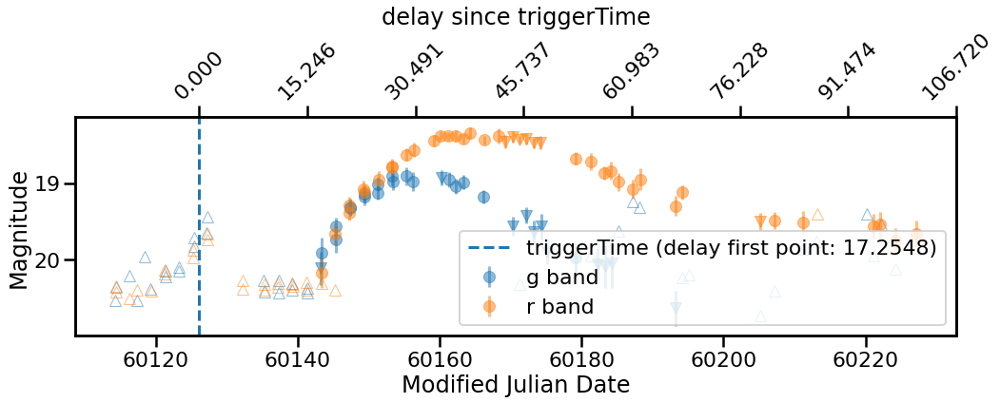

----------------------------------------------




715401383   initial
+-----------+----------------------------+-------------+------------+-------+---------------+------------+
| triggerId |       triggerTimeUTC       | observatory | instrument | event | gcn_loc_error | gcn_status |
+-----------+----------------------------+-------------+------------+-------+---------------+------------+
| 715401383 | 2023-09-03 04:36:18.910000 |    Fermi    |    GBM     |       |    430.998    |  initial   |
+-----------+----------------------------+-------------+------------+-------+---------------+------------+


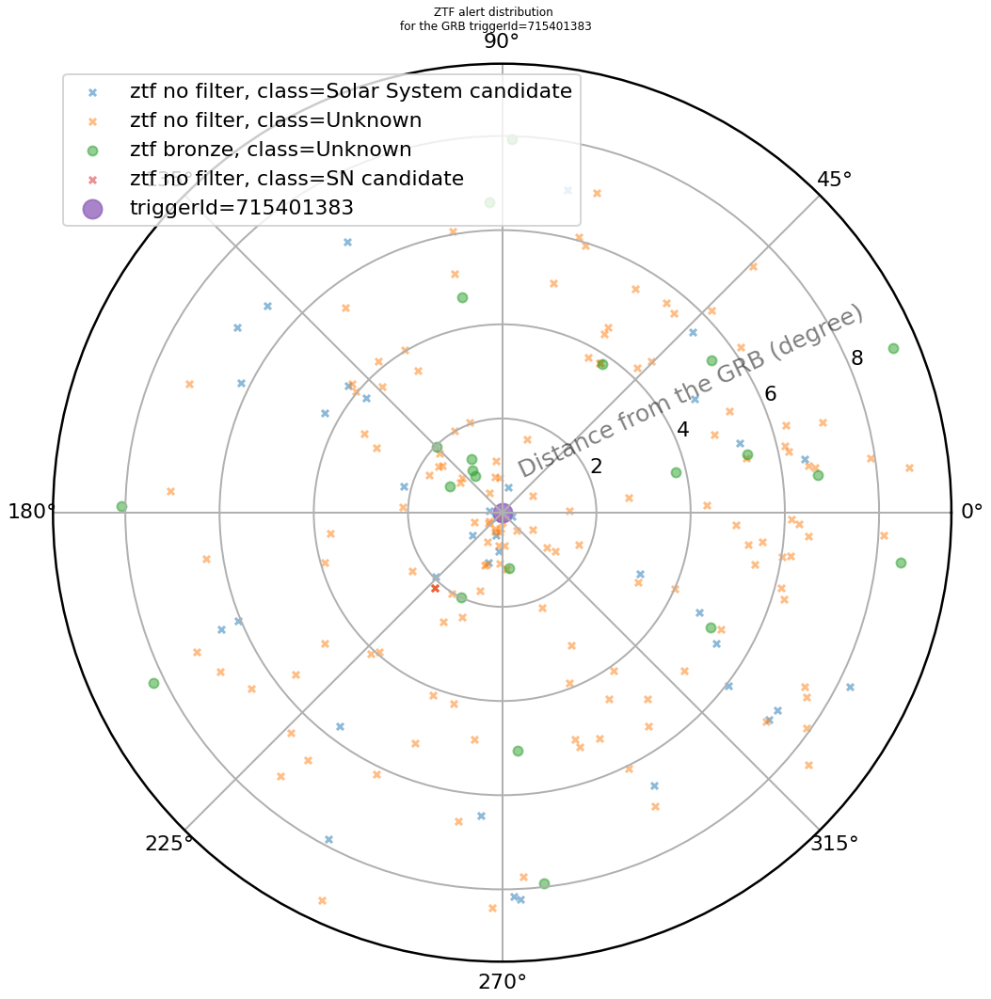

nb objId = 1
ZTF23abayule
['Unknown' 'SN candidate']
distance to the gcn: 4.711718296302235 deg


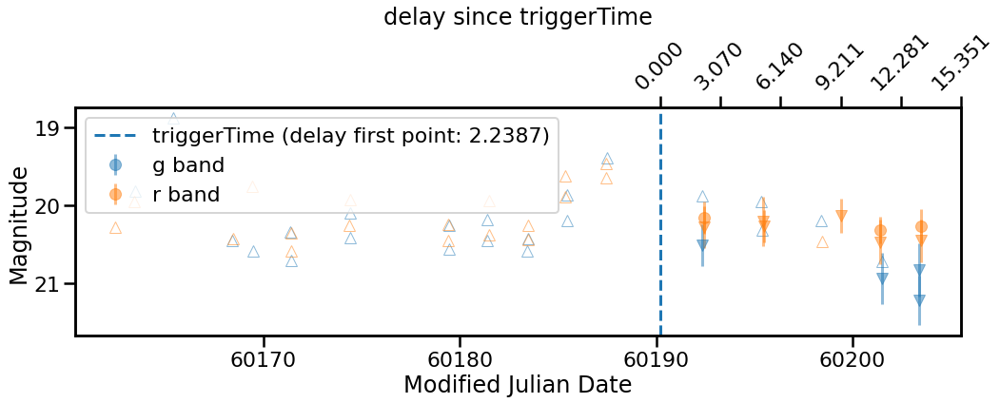

----------------------------------------------




716835508   update_0
+-----------+----------------------------+-------------+------------+-------+---------------+------------+
| triggerId |       triggerTimeUTC       | observatory | instrument | event | gcn_loc_error | gcn_status |
+-----------+----------------------------+-------------+------------+-------+---------------+------------+
| 716835508 | 2023-09-19 18:58:23.860000 |    Fermi    |    GBM     |       |     244.8     |  update_0  |
+-----------+----------------------------+-------------+------------+-------+---------------+------------+


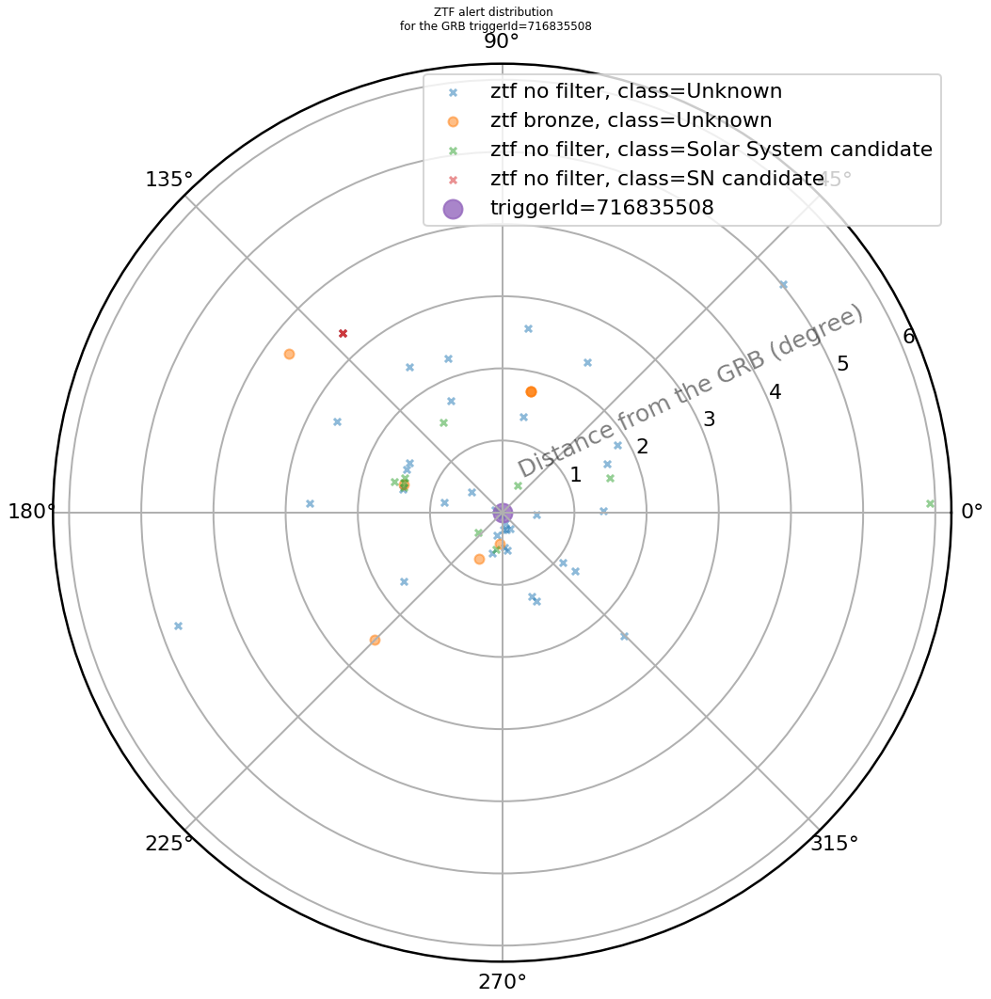

nb objId = 2
ZTF23abgtmkd
['Unknown']
distance to the gcn: 5.295273514512744 deg


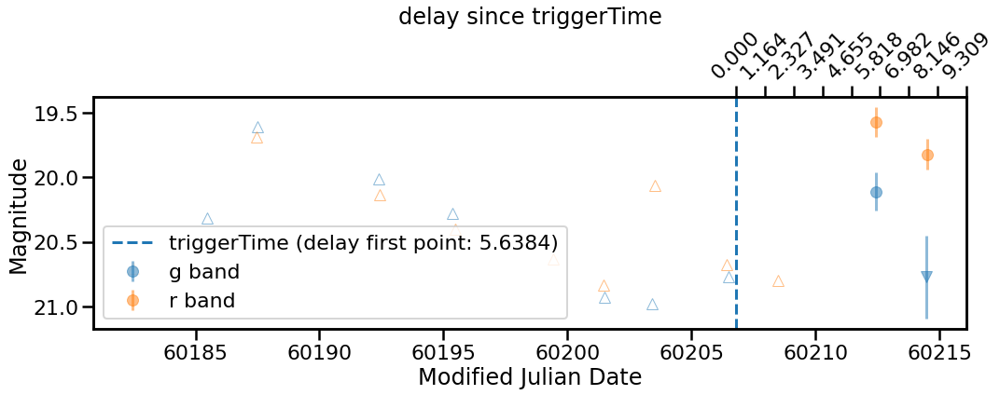

ZTF23abgtnlg
['SN candidate' 'Unknown']
distance to the gcn: 5.277650802149111 deg


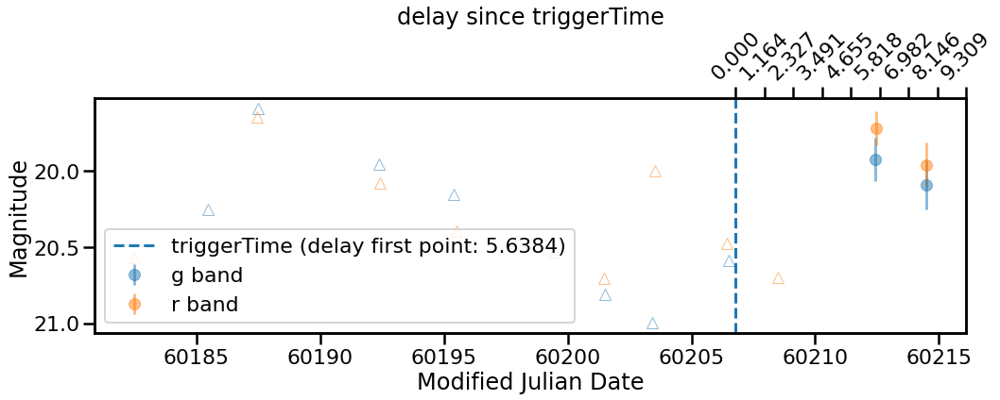

----------------------------------------------




709083929   initial
+-----------+----------------------------+-------------+------------+-------+---------------+------------+
| triggerId |       triggerTimeUTC       | observatory | instrument | event | gcn_loc_error | gcn_status |
+-----------+----------------------------+-------------+------------+-------+---------------+------------+
| 709083929 | 2023-06-22 01:45:24.830000 |    Fermi    |    GBM     |       |     272.4     |  initial   |
+-----------+----------------------------+-------------+------------+-------+---------------+------------+


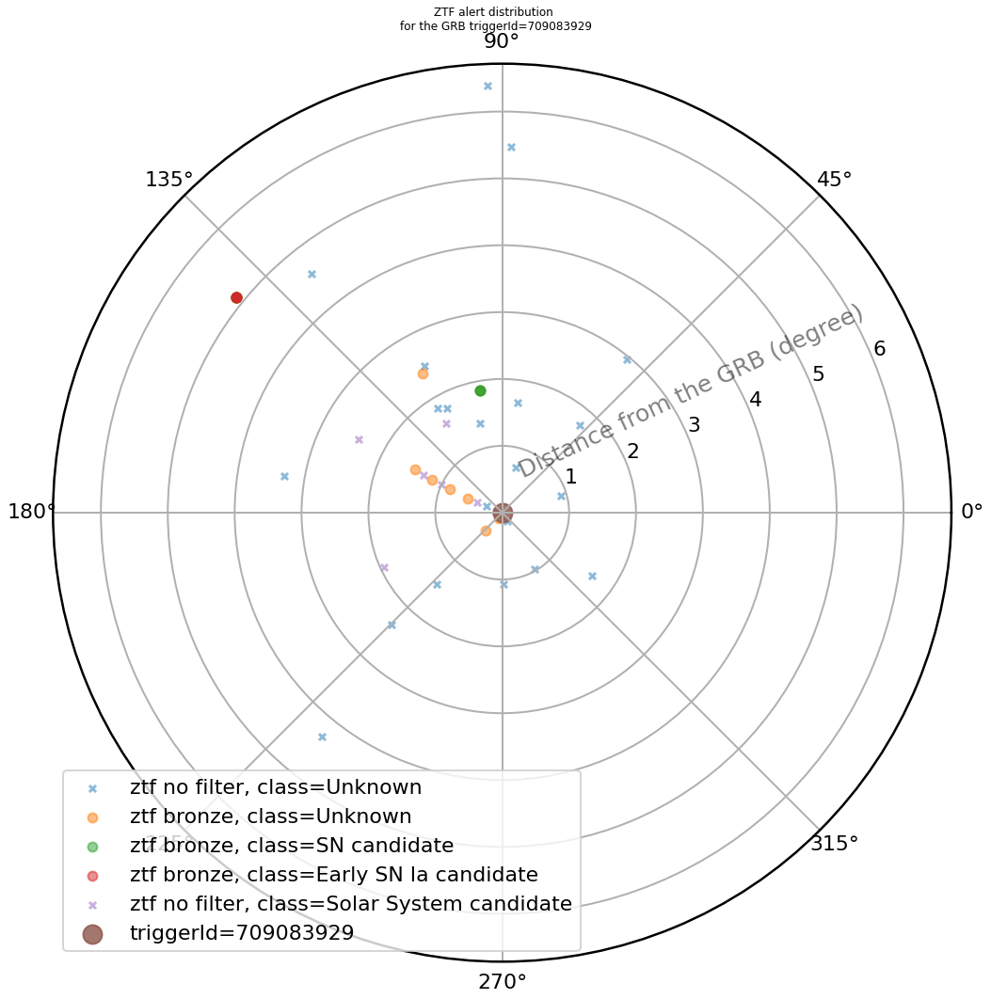

nb objId = 2
ZTF23aapzouv
['SN candidate' 'Unknown']
distance to the gcn: 2.567134547098795 deg


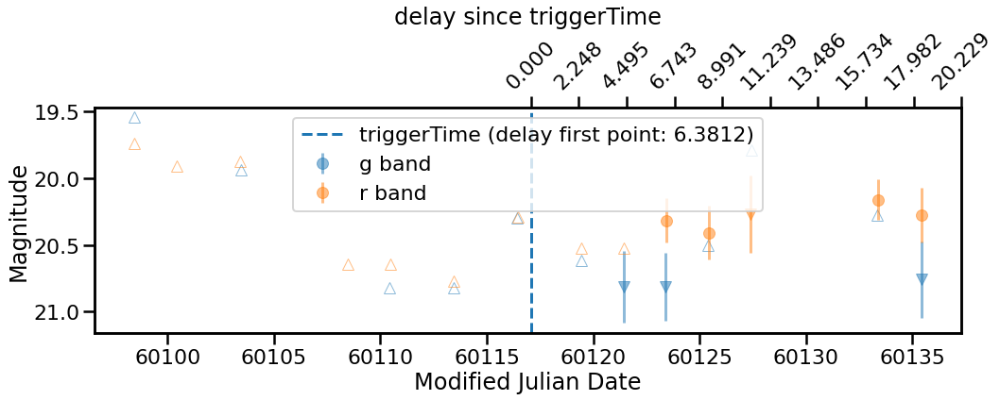

ZTF23aapnixu
['Unknown' 'Early SN Ia candidate' 'SN candidate']
distance to the gcn: 5.636642278129325 deg


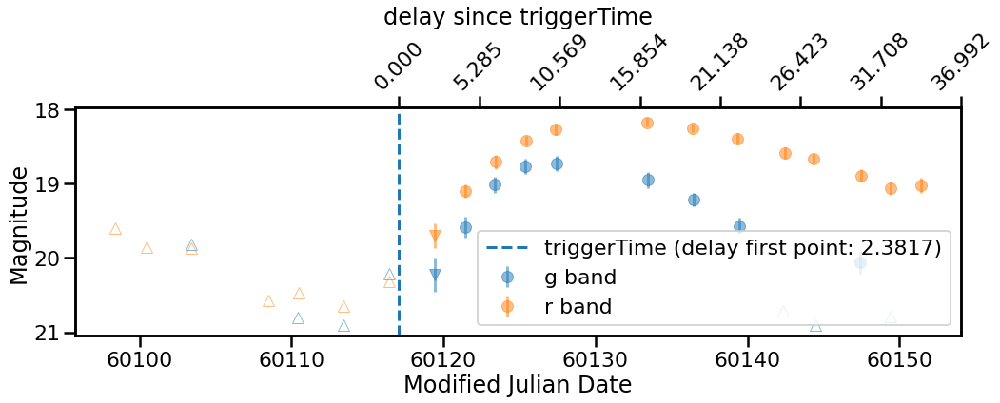

----------------------------------------------




716756135   update_0
+-----------+----------------------------+-------------+------------+-------+---------------+------------+
| triggerId |       triggerTimeUTC       | observatory | instrument | event | gcn_loc_error | gcn_status |
+-----------+----------------------------+-------------+------------+-------+---------------+------------+
| 716756135 | 2023-09-18 20:55:30.510000 |    Fermi    |    GBM     |       |    463.998    |  update_0  |
+-----------+----------------------------+-------------+------------+-------+---------------+------------+


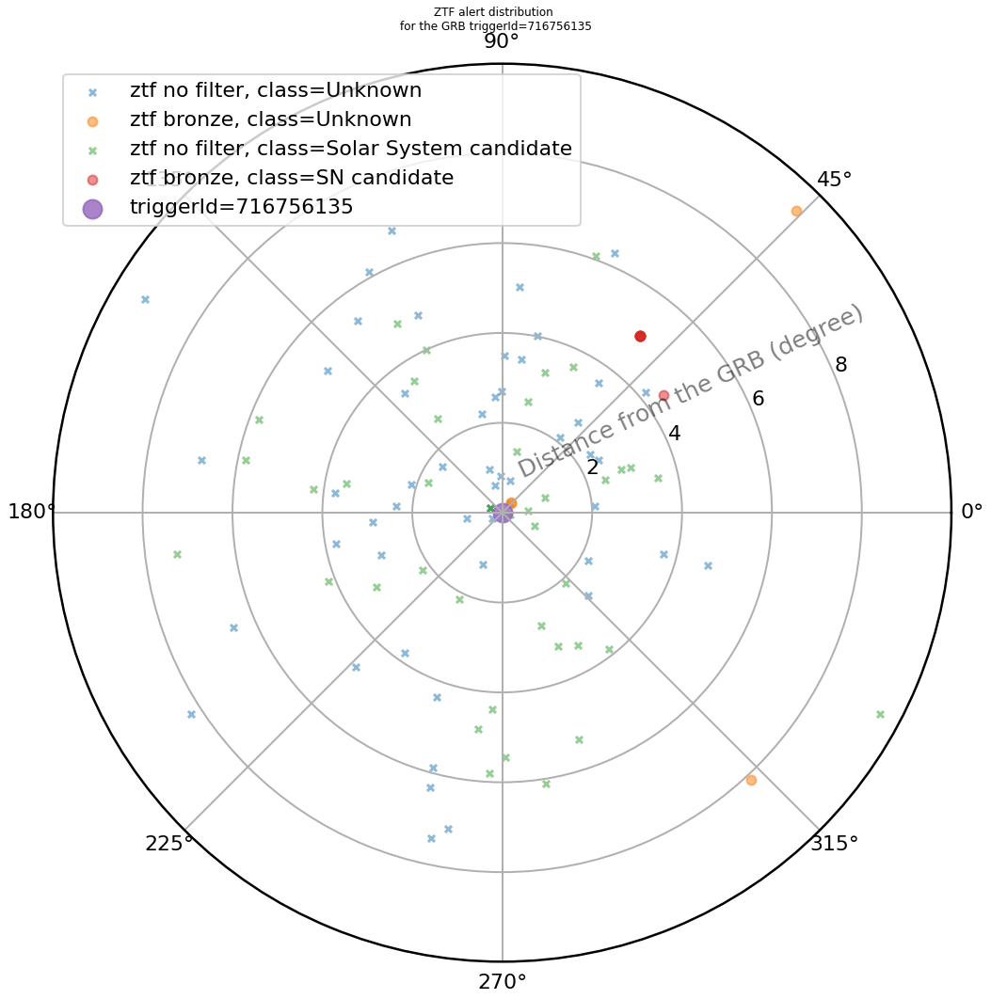

nb objId = 1
----------------------------------------------




715523296   initial
+-----------+----------------------------+-------------+------------+-------+--------------------+------------+
| triggerId |       triggerTimeUTC       | observatory | instrument | event |   gcn_loc_error    | gcn_status |
+-----------+----------------------------+-------------+------------+-------+--------------------+------------+
| 715523296 | 2023-09-04 14:28:11.830000 |    Fermi    |    GBM     |       | 250.00199999999998 |  initial   |
+-----------+----------------------------+-------------+------------+-------+--------------------+------------+


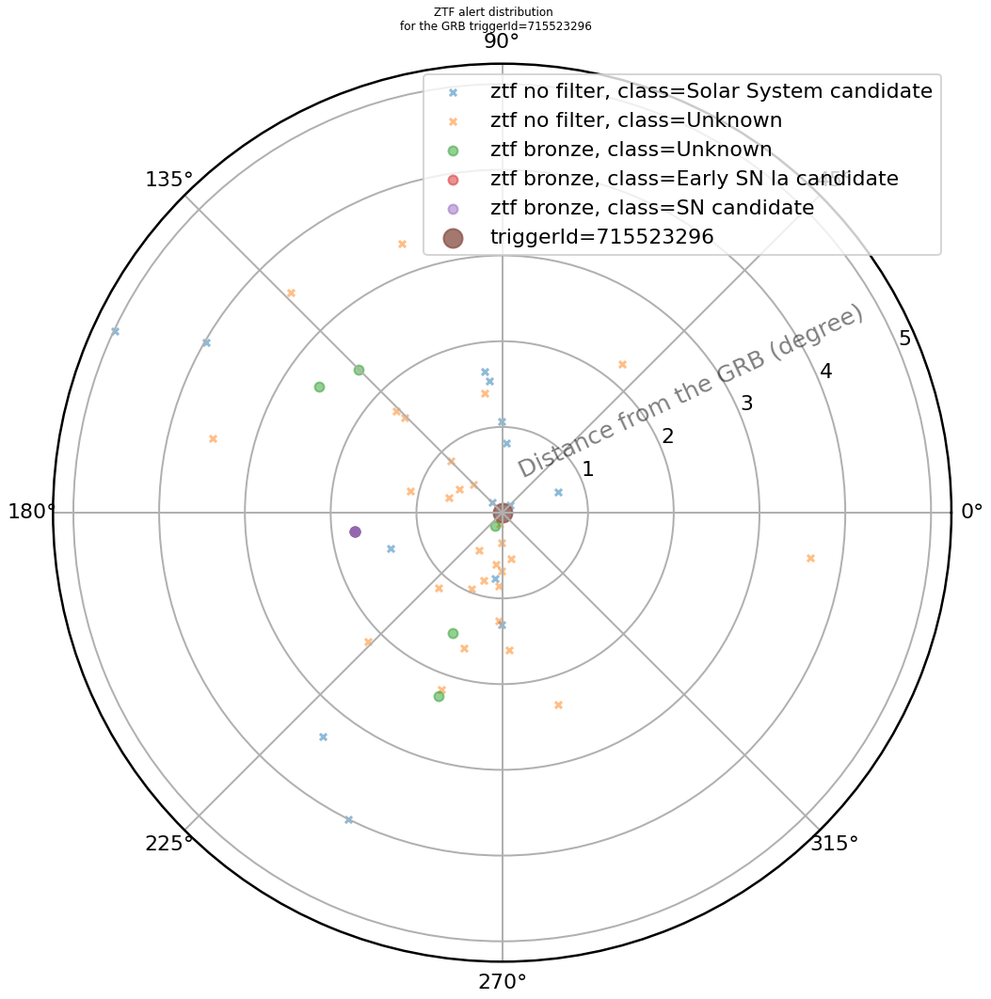

nb objId = 1
ZTF23abcnhzq
['Early SN Ia candidate' 'SN candidate' 'Unknown']
distance to the gcn: 3.503691341303538 deg


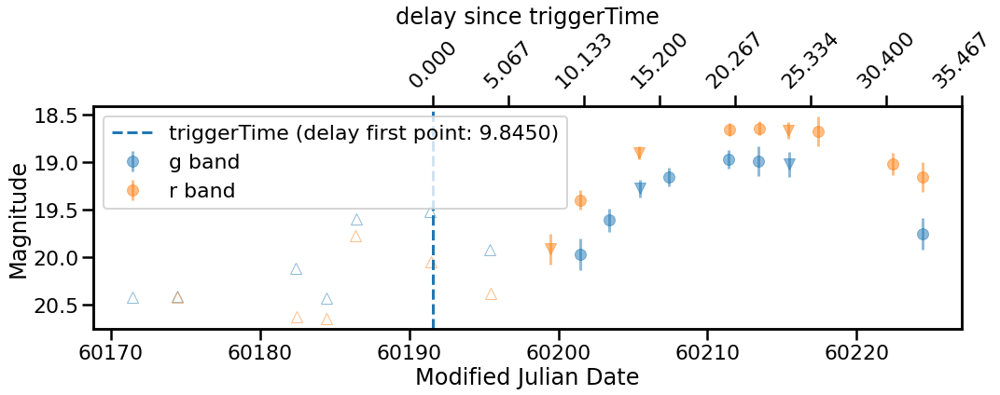

----------------------------------------------




716007606   initial
+-----------+----------------------------+-------------+------------+-------+---------------+------------+
| triggerId |       triggerTimeUTC       | observatory | instrument | event | gcn_loc_error | gcn_status |
+-----------+----------------------------+-------------+------------+-------+---------------+------------+
| 716007606 | 2023-09-10 05:00:01.740000 |    Fermi    |    GBM     |       |     171.6     |  initial   |
+-----------+----------------------------+-------------+------------+-------+---------------+------------+


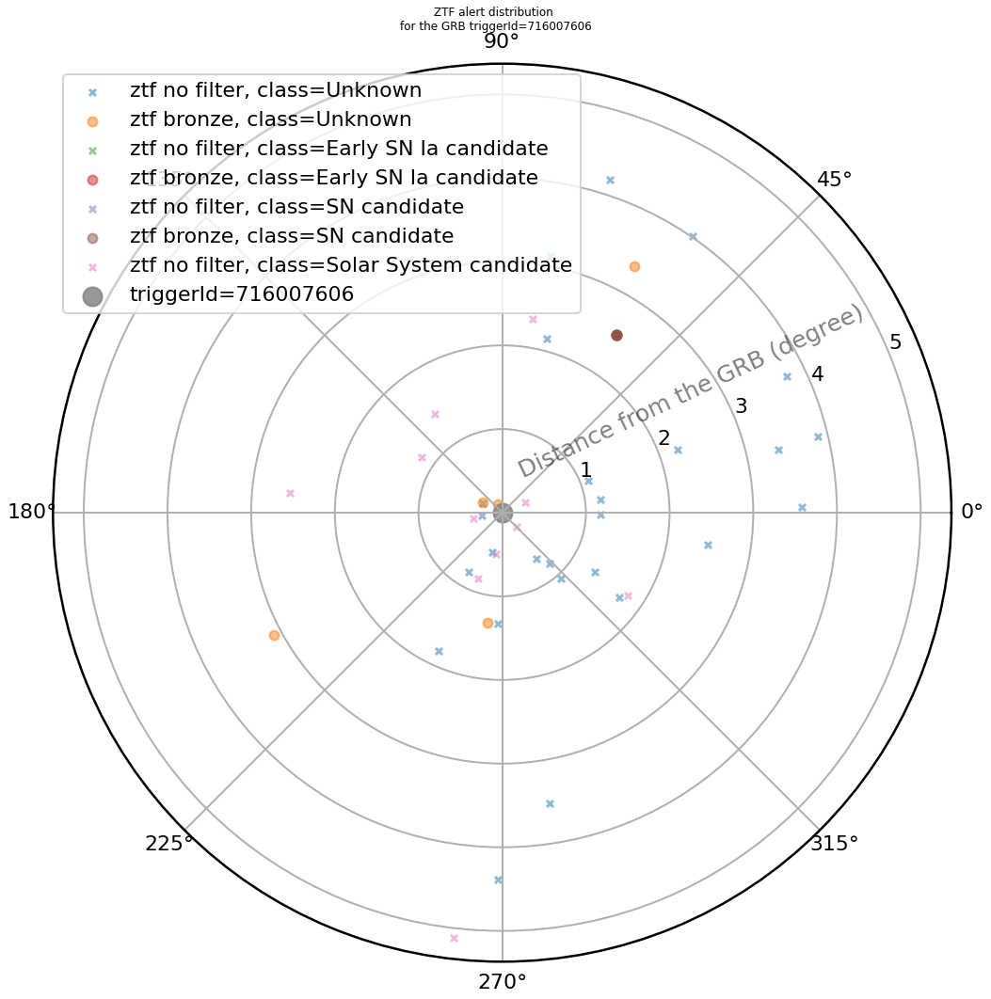

nb objId = 1
ZTF23abcneqm
['Unknown' 'Early SN Ia candidate' 'SN candidate']
distance to the gcn: 2.720414934521359 deg


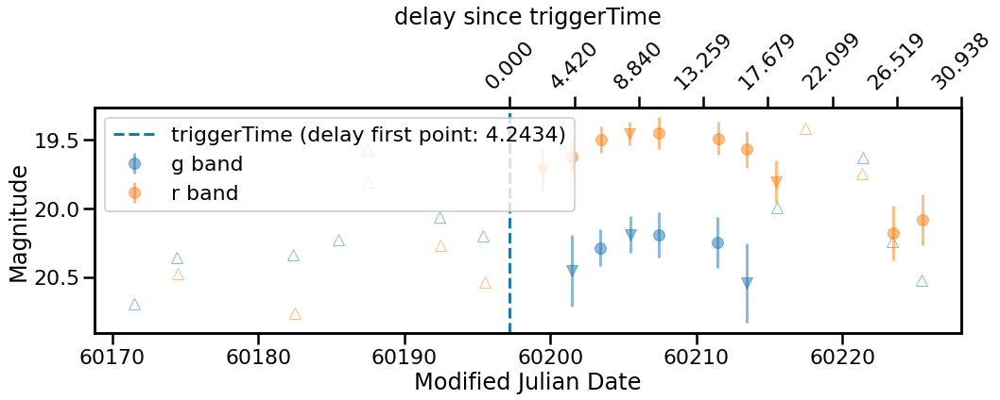

----------------------------------------------






In [34]:
for trId, status in zip(uniq_trid_fermi["triggerId"], uniq_trid_fermi["gcn_status"]):
    print(trId, " ", status)
    gcn = data_join.get_gcn_join(trId, status)
    print(gcn.info())
    gcn_ra, gcn_dec = gcn.gcn_pdf["gcn_ra"].values[0], gcn.gcn_pdf["gcn_dec"].values[0]
    gcn.plot_alert_distribution()
    tmp_objId = count_fermi_mask[(count_fermi_mask["triggerId"] == trId) &
                    (count_fermi_mask["gcn_status"] == status)]["objectId"].unique()
    print(f"nb objId = {len(tmp_objId)}")
    for objId in tmp_objId:
        try:
            if count_fermi[count_fermi["objectId"] == objId]["nb_obs"].values[0] > 1:
                ztf = gcn.get_ztf_obj(objId)
                print(objId)
                print(ztf.ztf_pdf["fink_class"].unique())
                ztf_ra, ztf_dec = ztf.ztf_pdf["ztf_ra"].values[0], ztf.ztf_pdf["ztf_dec"].values[0]
                dist = SkyCoord(ztf_ra, ztf_dec, unit="deg").separation(
                    SkyCoord(gcn_ra, gcn_dec, unit="deg")
                )
                print(f"distance to the gcn: {dist}")
                ztf.plot_lighcurve()
        except Exception as e:
            print(e)
            continue
    print("----------------------------------------------")
    print("\n")
    print("\n")

## Look more into details on Integral gcn

## Look multi-observatory match

In [98]:
def delay_obs(x):
    a_x = np.sort(np.unique(np.array(list(x))))
    if len(a_x) > 1:
        return np.abs(np.diff(x))
    else:
        return -1.0

In [99]:
mm_object = online_pdf.drop_duplicates(["objectId", "observatory"]).groupby("objectId").agg(
    nb_obs=("observatory", lambda x: len(np.unique(x))),
    delay_between_obs=("triggerTimejd", delay_obs)
).sort_values("nb_obs")

In [110]:
mm_ztf = mm_object[(mm_object["nb_obs"] > 1) & (mm_object["delay_between_obs"] < 1)].reset_index()

In [111]:
for objId in mm_ztf["objectId"]:
    tmp = online_pdf[online_pdf["objectId"] == objId]
    print(tmp.groupby(["triggerId", "gcn_status", "objectId"]).count()["observatory"])

triggerId  gcn_status  objectId    
1180410    initial     ZTF23aavjxfi    1
711293230  initial     ZTF23aavjxfi    1
711475906  initial     ZTF23aavjxfi    1
711555530  initial     ZTF23aavjxfi    1
711805358  initial     ZTF23aavjxfi    1
711853834  initial     ZTF23aavjxfi    1
Name: observatory, dtype: int64
triggerId  gcn_status  objectId    
1180410    initial     ZTF23aauoplf    1
711293230  initial     ZTF23aauoplf    1
711475906  initial     ZTF23aauoplf    1
711555530  initial     ZTF23aauoplf    1
711805358  initial     ZTF23aauoplf    1
711853834  initial     ZTF23aauoplf    1
Name: observatory, dtype: int64
triggerId  gcn_status  objectId    
1180410    initial     ZTF23aauhgef    1
711293230  initial     ZTF23aauhgef    1
711475906  initial     ZTF23aauhgef    1
711555530  initial     ZTF23aauhgef    1
711805358  initial     ZTF23aauhgef    1
711853834  initial     ZTF23aauhgef    1
Name: observatory, dtype: int64
triggerId  gcn_status  objectId    
1180410    initial    

triggerId  gcn_status  objectId    
1180410    initial     ZTF23aauhgfq    1
711293230  initial     ZTF23aauhgfq    1
711475906  initial     ZTF23aauhgfq    1
711555530  initial     ZTF23aauhgfq    1
711805358  initial     ZTF23aauhgfq    1
711853834  initial     ZTF23aauhgfq    1
Name: observatory, dtype: int64
triggerId  gcn_status  objectId    
10349      initial     ZTF23aawkpbs    1
712143685  initial     ZTF23aawkpbs    1
712953666  initial     ZTF23aawkpbs    1
Name: observatory, dtype: int64
triggerId  gcn_status  objectId    
1180410    initial     ZTF23aavayqm    1
711293230  initial     ZTF23aavayqm    1
711475906  initial     ZTF23aavayqm    1
711555530  initial     ZTF23aavayqm    1
711805358  initial     ZTF23aavayqm    1
711853834  initial     ZTF23aavayqm    1
Name: observatory, dtype: int64
triggerId  gcn_status  objectId    
1180410    initial     ZTF23aauvneg    1
711293230  initial     ZTF23aauvneg    1
711475906  initial     ZTF23aauvneg    1
711555530  initial    

In [101]:
online_pdf[online_pdf["objectId"] == "ZTF23aavjxfi"]

,observatory,instrument,event,triggerId,gcn_ra,gcn_dec,gcn_loc_error,ackTime,triggerTimeUTC,gcn_status,...,timestamp,is_grb_bronze,is_grb_silver,is_grb_gold,is_gw_bronze,year,month,day,triggerTimejd,ackTimejd
33203,Fermi,GBM,,711805358,249.3400,-8.3400,215.400000,2023-07-23 15:51:56.187086,2023-07-23 13:42:33.030,initial,...,2023-07-30 07:10:25.996792,True,False,False,False,2023,7,30,2.460149e+06,2.460149e+06
33207,SWIFT,BAT,,1180410,250.3788,-5.3272,0.016667,2023-07-23 15:55:15.202470,2023-07-23 13:42:32.880,initial,...,2023-07-30 07:10:25.996792,True,True,True,False,2023,7,30,2.460149e+06,2.460149e+06
33211,Fermi,GBM,,711853834,278.4000,22.7200,2366.400000,2023-07-24 05:19:38.675694,2023-07-24 03:10:29.450,initial,...,2023-07-30 07:10:25.996792,True,False,False,False,2023,7,30,2.460150e+06,2.460150e+06
33215,Fermi,GBM,,711475906,238.3333,33.4833,3000.000000,2023-07-19 20:12:40.345894,2023-07-19 18:11:41.160,initial,...,2023-07-30 07:10:25.996792,True,False,False,False,2023,7,30,2.460145e+06,2.460145e+06
33219,Fermi,GBM,,711555530,233.9833,34.5833,3000.000000,2023-07-20 18:20:09.743128,2023-07-20 16:18:45.320,initial,...,2023-07-30 07:10:25.996792,True,False,False,False,2023,7,30,2.460146e+06,2.460146e+06
33223,Fermi,GBM,,711293230,236.8333,37.2667,3000.000000,2023-07-17 17:27:25.435357,2023-07-17 15:27:05.020,initial,...,2023-07-30 07:10:25.996792,True,False,False,False,2023,7,30,2.460143e+06,2.460143e+06


In [105]:
gcn_1180410 = data_join.get_gcn_join("1180410", "initial")

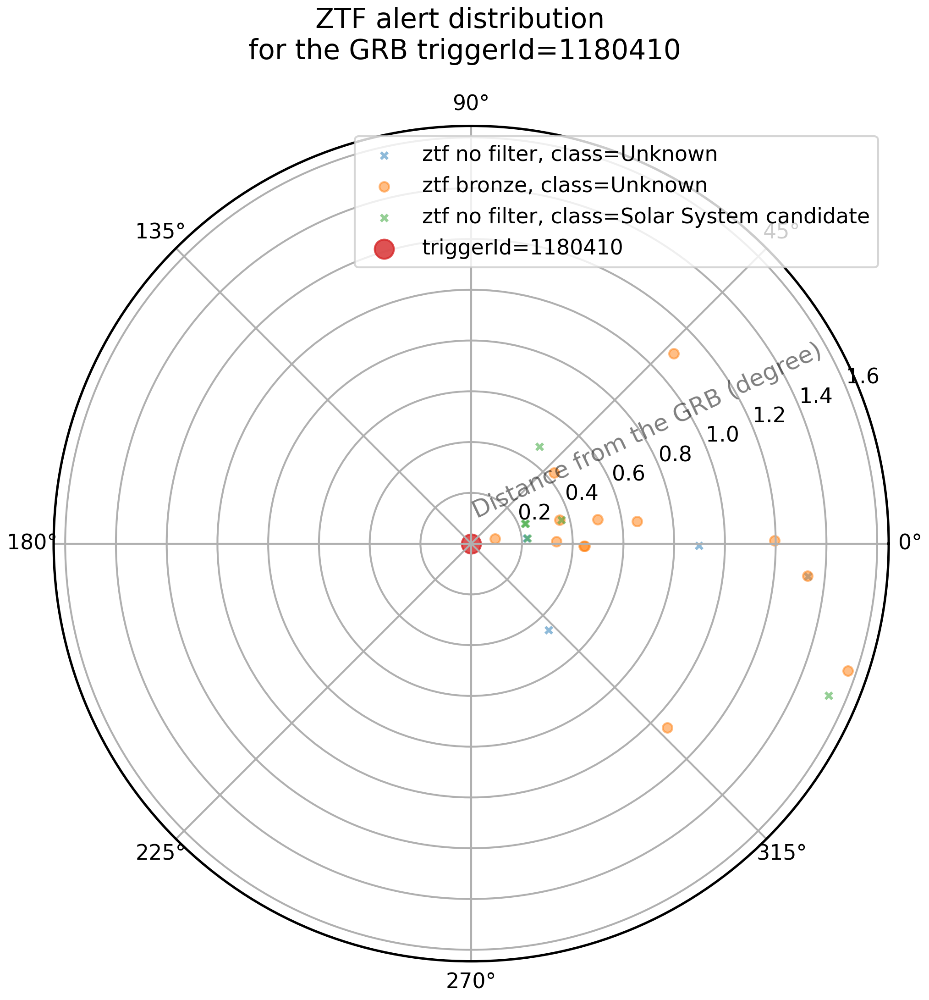

In [106]:
gcn_1180410.plot_alert_distribution()